<div style='background-image: url("../../share/images/header.svg") ; padding: 0px ; background-size: cover ; border-radius: 5px ; height: 250px'>
    <div style="float: right ; margin: 50px ; padding: 20px ; background: rgba(255 , 255 , 255 , 0.7) ; width: 50% ; height: 150px">
        <div style="position: relative ; top: 50% ; transform: translatey(-50%)">
            <div style="font-size: xx-large ; font-weight: 900 ; color: rgba(0 , 0 , 0 , 0.8) ; line-height: 100%">Computational Seismology</div>
            <div style="font-size: large ; padding-top: 20px ; color: rgba(0 , 0 , 0 , 0.5)">Finite Differences - Grid-Staggering Elastic 2D</div>
        </div>
    </div>
</div>

<p style="width:20%;float:right;padding-left:50px">
<img src=../../share/images/book.jpg>
<span style="font-size:smaller">
</span>
</p>


---

This notebook is a private extension to elastic writen by Yajian Gao based on part of the supplementary material 
to [Computational Seismology: A Practical Introduction](https://global.oup.com/academic/product/computational-seismology-9780198717416?cc=de&lang=en&#), 
Oxford University Press, 2016.


##### Authors:
* Ashim Rijal ([@ashimrijal](https://github.com/ashimrijal))
* Heiner Igel ([@heinerigel](https://github.com/heinerigel))
* Yajian Gao  ([@Yajian Gao](https://github.com/yjgao-gfz))

This exercise covers the following aspects:

* Solving velocity-stress formulation of 2D wave equation with finite difference method
* Understanding the grid-staggering in connection with finite difference solution to the elastic wave equation
* Understanding the adjoint misfit kernel
---

### Exercise
First understand the codes below and run the simulation. 

Then, improve the result using (4-point operator) for 1st derivative.

**Message: Once you become familiar with all the codes below you can go to the Cell tab on the toolbar and click Run All.**


In [7]:
# Configuration step (Please run it before the simulation code!)
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numba import jit
from matplotlib import cm


In [8]:
# Initialization of parameters

# Simple finite difference solver
# Elastic wave equation
# 2-D regular staggered grid

# Basic parameters 240000 grids
nt = 2500                                       # number of time steps
nx = 1000                                             # number of grid points in x
nz = 500
                                              # velocity (m/sec) (compression wave)
vp=np.zeros((nx,nz))+7000
vs=np.zeros((nx,nz))+3500
rho0=np.zeros((nx,nz))+3500
irx=np.linspace(150,900,51)
irz=np.zeros(51)+(nz-5)

dx=1000                                          #m
dz=1000


isnap = 5                                 # snapshot frequency



#####stable criterion refer to the guide-sofi 3d in Table4
f0_stable =  np.min(vs)/dx/8
f0=0.3
eps = 0.3
dt=0.06


###In order to ensure stability of the simulation, the temporal spacing must satisfy the Courant-
#Friedrichs-Levy (CFL) stability criterion (Courant et al., 1967).
#####stable criterion refer to the guide-sofi 2d in Table4 and equation 27

dt_stable=dx/(7/6)/np.sqrt(2)/np.max(vp) ##from stable criterion refer to the guide-sofi 2d in Table4 and equation 27

#dt_stable_new=dx/(6/7*np.sqrt(2))/np.max(vp)###from stable criterion refer to the guide-sofi 2d in Table4 and equation 27

print('f0=',f0)
print('f0_stable=',f0_stable)
print('dt=',dt)
print('dt_stable=',dt_stable)
#print('dt_stable=',dt_stable_new)
                                                # number of operator either 2 or 4


x = (np.arange(nx)*dx)                                 # initialize space coordinates 
z = (np.arange(nz)*dz)
                                     # calculate time step from stability criterion(s)

# Source time function                                      # wavelength


#####source term in space
mxx=1e23/dx/dz
mzz=1e23/dx/dz

##absorbing and free surface layer

stencil=2
ni1=stencil+5
ni2=nx-stencil-5
nk1=stencil+5
nk2=nz-stencil

f0= 0.3
f0_stable= 0.4375
dt= 0.06
dt_stable= 0.08658450381876091


In [9]:
pathrun='/scratch/gpi/seis/yjgao/FD_wavefield_snapshots/' 
##path below for the students in Pool pcs 
#pathrun=/scratch/gpi/seis/tmp_forfwi/FD_wavefield_snapshots/

In [10]:
from source import source
isx =220                                     # source location
isz =500-20
source=source([isx,isz],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)


In [5]:
len(irz)

51

In [11]:
print(source.location)
print(source.typeofsource)
print(source.singleforce())
print(source.magnitude)
print(source.moment())
print(source.sourcetf())

[220, 480]
singleforce
(array([ 4.50140699e+11,  7.82279605e+11,  1.34501469e+12, ...,
       -0.00000000e+00, -0.00000000e+00, -0.00000000e+00]), array([ 4.50140699e+11,  7.82279605e+11,  1.34501469e+12, ...,
       -0.00000000e+00, -0.00000000e+00, -0.00000000e+00]))
1e+18
(array([ 0.,  0.,  0., ..., -0., -0., -0.]), array([ 0.,  0.,  0., ..., -0., -0., -0.]), array([ 0.,  0.,  0., ..., -0., -0., -0.]), array([ 0.,  0.,  0., ..., -0., -0., -0.]))
[ 9.00281398e-07  1.56455921e-06  2.69002938e-06 ... -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00]


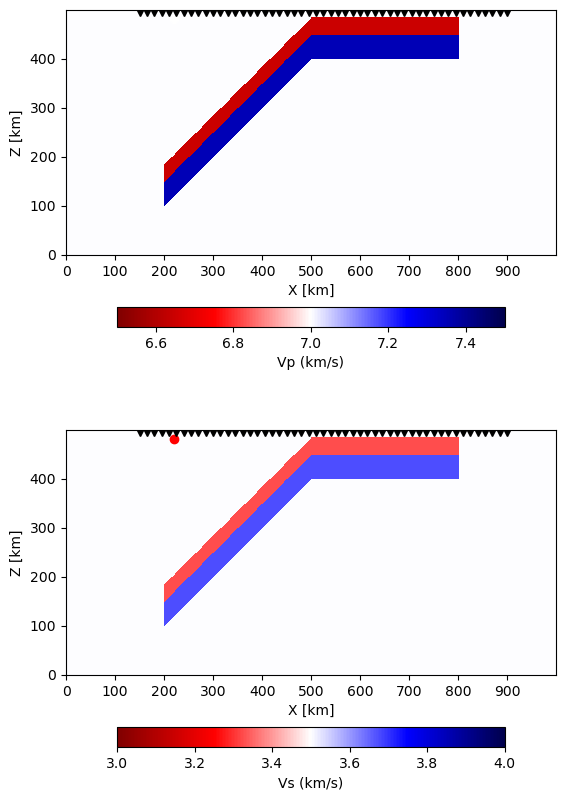

<Figure size 640x480 with 0 Axes>

In [12]:
#####here we could add some heterosgenities in the velocity model
##### with slab

##slab model
for i in np.arange(200,500):
        vp[i][i-50:i-50+35]=  0.95*vp[i][i-50:i-50+35]
for i in np.arange(500,800):
        vp[i][450:450+35]=0.95*vp[i][450:450+35]

for i in np.arange(200,500):
        vp[i][i-100:i-100+50]=1.05*vp[i][i-100:i-100+50]

for i in np.arange(500,800):
        vp[i][400:400+50]=  1.05*vp[i][400:400+50]
        
        
for i in np.arange(200,500):
        vs[i][i-50:i-50+35]=  0.95*vs[i][i-50:i-50+35]
        
for i in np.arange(500,800):
        vs[i][450:450+35]=0.95*vs[i][450:450+35]
        
for i in np.arange(200,500):
        vs[i][i-100:i-100+50]=1.05*vs[i][i-100:i-100+50]

for i in np.arange(500,800):
        vs[i][400:400+50]=  1.05*vs[i][400:400+50]
        
plt.figure(figsize=(10, 10))
fig = plt.subplot(211)
image = plt.imshow(vp.T/1000, animated=True, cmap=cm.seismic_r, interpolation='nearest', vmin=6500/1000, vmax=7500/1000)
plt.colorbar(shrink=0.5, orientation='horizontal',label='Vp (km/s)')
#plt.title('Velocity')  
plt.xlabel('X [km]')
plt.ylabel('Z [km]')
plt.xticks(np.arange(0,1000, step=100))
plt.gca().invert_yaxis()
plt.plot(source.location[0], source.location[1], 'o', color='white')
for i in range(len(irx)):
    plt.plot(irx[i], irz[i], 'vk')
plt.ion()
########################
fig = plt.subplot(212)
image = plt.imshow(vs.T/1000, animated=True, cmap=cm.seismic_r, interpolation='nearest', vmin=3000/1000, vmax=4000/1000)
plt.colorbar(shrink=0.5, orientation='horizontal',label='Vs (km/s)')
#plt.title('Velocity')  
plt.xlabel('X [km]')
plt.ylabel('Z [km]')
plt.xticks(np.arange(0,1000, step=100))
plt.gca().invert_yaxis()
plt.plot(source.location[0], source.location[1],'o', color='red')
for i in range(len(irx)):
    plt.plot(irx[i], irz[i], 'vk')
plt.ion()
plt.show(block=False)
plt.savefig('model_vp_origin.pdf')


In [13]:
vp_obs=vp.copy()
vs_obs=vs.copy()

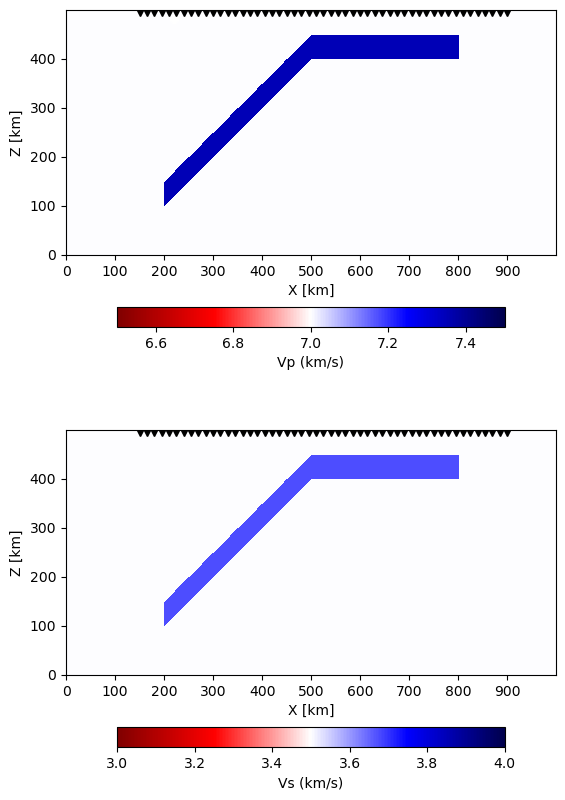

<Figure size 640x480 with 0 Axes>

In [14]:
%matplotlib inline
#####here we could add some heterosgenities in the velocity model
##### with slab
vp=np.zeros((nx,nz))+7000
vs=np.zeros((nx,nz))+3500
rho0=np.zeros((nx,nz))+3500

vs

#for i in np.arange(200,500):
#        vp[i][i-50:i-50+15]=  0.96*vp[i][i-50:i-50+15]
for i in np.arange(200,500):
        vp[i][i-100:i-100+50]=1.05*vp[i][i-100:i-100+50]
for i in np.arange(500,800):
        vp[i][400:400+50]=  1.05*vp[i][400:400+50]
#for i in np.arange(200,500):
#        vs[i][i-50:i-50+15]=  0.96*vs[i][i-50:i-50+15]
for i in np.arange(200,500):
        vs[i][i-100:i-100+50]=1.05*vs[i][i-100:i-100+50]
for i in np.arange(500,800):
        vs[i][400:400+50]=  1.05*vs[i][400:400+50]
        
plt.figure(figsize=(10, 10))
fig = plt.subplot(211)
image = plt.imshow(vp.T/1000, animated=True, cmap=cm.seismic_r, interpolation='nearest', vmin=6500/1000, vmax=7500/1000)
plt.colorbar(shrink=0.5, orientation='horizontal',label='Vp (km/s)')
#plt.title('Velocity')  
plt.xlabel('X [km]')
plt.ylabel('Z [km]')
plt.xticks(np.arange(0,1000, step=100))
plt.gca().invert_yaxis()
plt.plot(source.location[0], source.location[1], 'o', color='white')
for i in range(len(irx)):
    plt.plot(irx[i], irz[i], 'vk')
plt.ion()
########################
fig = plt.subplot(212)
image = plt.imshow(vs.T/1000, animated=True, cmap=cm.seismic_r, interpolation='nearest', vmin=3000/1000, vmax=4000/1000)
plt.colorbar(shrink=0.5, orientation='horizontal',label='Vs (km/s)')
#plt.title('Velocity')  
plt.xlabel('X [km]')
plt.ylabel('Z [km]')
plt.xticks(np.arange(0,1000, step=100))
plt.gca().invert_yaxis()
#plt.plot(source.location[0], source.location[1],'o', color='red')
for i in range(len(irx)):
    plt.plot(irx[i], irz[i], 'vk')
plt.ion()
plt.show(block=False)
plt.savefig('model_vp_origin_nocrust.pdf')


In [15]:
@jit(nopython=True, parallel=True)
def update_v(vx, vz, sxx, szz, sxz, szx, nx, nz, dt, dx, rho, ni1, ni2, nk1, nk2,lamd,mu):
    # Velocity update loop
    for i in range(ni1, ni2):
        for j in range(nk1, nk2+1):  # Update up to nk2 (free surface level)## here is up to index 497
            # Calculate derivatives of stress components
            dsxx = 9/8 * (sxx[i + 1, j] - sxx[i, j]) / dx - 1/24 * (sxx[i + 2, j] - sxx[i - 1, j]) / dx
            dszx = 9/8 * (szx[i, j] - szx[i - 1, j]) / dx - 1/24 * (szx[i + 1, j] - szx[i - 2, j]) / dx
            dszz = 9/8 * (szz[i, j + 1] - szz[i, j]) / dx - 1/24 * (szz[i, j + 2] - szz[i, j - 1]) / dx
            dsxz = 9/8 * (sxz[i, j] - sxz[i, j - 1]) / dx - 1/24 * (sxz[i, j + 1] - sxz[i, j - 2]) / dx
            vx_new = dsxx + dsxz
            vz_new = dszz + dszx
            vx[i, j] = vx[i, j] + dt * (vx_new / rho[i, j])
            vz[i, j] = vz[i, j] + dt * (vz_new / rho[i, j])

    # Apply Free Surface Boundary Condition for Velocities
    vz[:, nk2] = vz[:, nk2 -1] 
    vz[:, nk2 + 1] = vz[:, nk2 -2]   # Zero vertical velocity above the free surface
    vx[:, nk2] = vx[:, nk2 -1] 
    vx[:, nk2 + 1] = vx[:, nk2 -2]   # Zero vertical velocity above the free surface
    return vx, vz





@jit(nopython=True, parallel=True)
def update_s(vx, vz, sxx, szz, sxz, szx, nx, nz, dt, dx, rho, ni1, ni2, nk1, nk2, lamd, mu, exx_full, exz_full, ezz_full, ezx_full):
    
    for i in range(ni1, ni2):  # x loop
        szz[i, nk2] = 0  # No vertical stress at the free surface
        szz[i, nk2 + 1] = -szz[i, nk2 - 1]   # No vertical stress above the free surface
        sxz[i, nk2] = 0  # No shear stress at the free surface
        sxz[i, nk2+1] = -sxz[i, nk2 - 1]  # No shear stress at the free surface
        szx[i, nk2] = 0  # No shear stress at the free surface
        szx[i, nk2+1] = -szx[i, nk2 - 1]  # No shear stress at the free surface
        for j in range(nk1, nk2+1):  # z loop up to nk2 (free surface level)
            # Strain rate calculation
            exx = 9/8 * (vx[i, j] - vx[i - 1, j]) / dx - 1/24 * (vx[i + 1, j] - vx[i - 2, j]) / dx
            ezz = 9/8 * (vz[i, j] - vz[i, j - 1]) / dx - 1/24 * (vz[i, j + 1] - vz[i, j - 2]) / dx
            exz = 9/8 * (vx[i, j + 1] - vx[i, j]) / dx - 1/24 * (vx[i, j + 2] - vx[i, j - 1]) / dx
            ezx = 9/8 * (vz[i + 1, j] - vz[i, j]) / dx - 1/24 * (vz[i + 2, j] - vz[i - 1, j]) / dx
            
            # Save strain rates for further processing or analysis
            exx_full[i, j] = exx
            exz_full[i, j] = 0.5 * (exz + ezx)
            ezz_full[i, j] = ezz
            ezx_full[i, j] = 0.5 * (ezx + exz)
            
            # Update stress components
            sxx[i, j] = sxx[i, j] + ((lamd[i, j] + 2 * mu[i, j]) * exx + lamd[i, j] * ezz) * dt
            szz[i, j] = szz[i, j] + ((lamd[i, j] + 2 * mu[i, j]) * ezz + lamd[i, j] * exx) * dt
            sxz[i, j] = sxz[i, j] + (mu[i, j] * exz_full[i, j] + mu[i, j] * ezx_full[i, j]) * dt
            szx[i, j] = szx[i, j] + (mu[i, j] * ezx_full[i, j] + mu[i, j] * exz_full[i, j]) * dt

        szz[i, nk2] = 0  # No vertical stress at the free surface
        szz[i, nk2 + 1] = -szz[i, nk2 - 1]   # No vertical stress above the free surface
        sxz[i, nk2] = 0  # No shear stress at the free surface
        sxz[i, nk2+1]   = -sxz[i, nk2 - 1]  # No shear stress at the free surface
        szx[i, nk2] = 0  # No shear stress at the free surface
        szx[i, nk2+1]   = -szx[i, nk2 - 1]  # No shear stress at the free surface
    return sxx, sxz, szz, szx, exx_full, exz_full, ezz_full, ezx_full


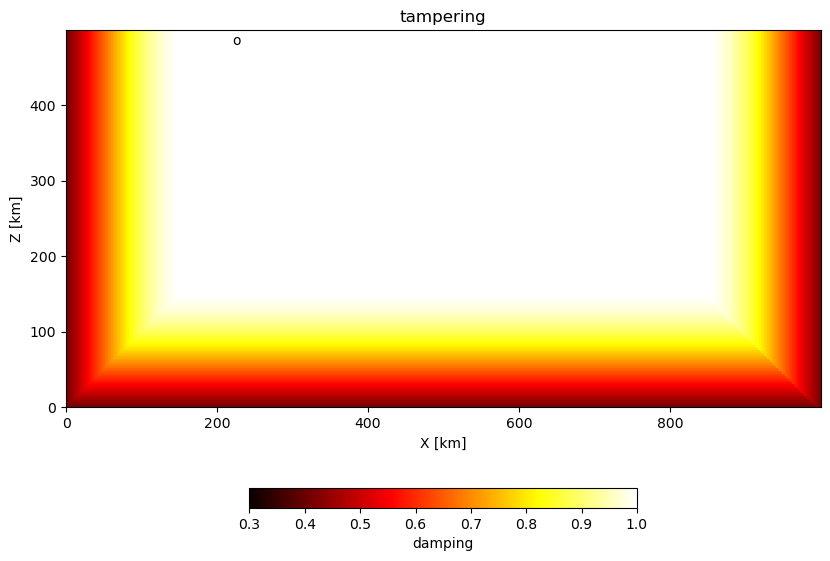

<Figure size 640x480 with 0 Axes>

In [16]:

def generate_damp_guassian(nx,nz,ni1,ni2,nk1,nk2,absorb_thickness_n):
    #absorbpoint_x=np.arange(ni1,ni1+absorb_thickness_n-1)
    damp=np.ones((nx,nz))
    ####lower absorbing
    for i in range(ni1,ni2):
        for j in range(0,absorb_thickness_n):
            #print()
            damp[i,j]=(np.exp(-(0.006*(ni1+absorb_thickness_n-j))**2))
            
            
    #left boundary
    for i in range(0,absorb_thickness_n):
        for j in range(0,nk2):
    #        #print()
            damp[i,j]=(np.exp(-(0.006*(nk1+absorb_thickness_n-i))**2))
            #print(j,damp[i,j])   
    # right boundary       
    for i in range(ni2-absorb_thickness_n,nx):
        for j in range(0,nz):
            #print()
            damp[i,j]=(np.exp(-(0.006*(ni2-absorb_thickness_n-i))**2))
            #print(j,damp[i,j])    
    # left lower corner 
    for j in range(0,nk1+absorb_thickness_n):
        damp[j:ni1+absorb_thickness_n,j]=(np.exp(-(0.006*(nk1+absorb_thickness_n-j))**2))
                
    # right lower corner
    for j in range(0,nk1+absorb_thickness_n):
        damp[ni2-absorb_thickness_n:ni2-j,j]=(np.exp(-(0.006*(nk1+absorb_thickness_n-j))**2))   
    
            
    return damp



damp=generate_damp_guassian(nx,nz,ni1,ni2,nk1,nk2,150)
fig = plt.figure(figsize=(10,7))
image = plt.imshow(damp.T, animated=True, cmap=cm.hot, interpolation='nearest', vmin=0.3, vmax=1)
plt.colorbar(shrink=0.5, orientation='horizontal',label='damping')
plt.title('tampering')
plt.xlabel('X [km]')
plt.ylabel('Z [km]')
plt.gca().invert_yaxis()
plt.text(isx, isz, 'o')
plt.ion()
plt.show(block=False)    
plt.savefig('model_tampering.pdf')

    
    
    
    
    

In [17]:

import datetime

######here you could input a heterogenity vp and vs

def assemble_psv(dx,dz,rho0,vp,vs,dt,nt,nx,nz,irx,irz,source,damp,isnap,iswf,path_snapshot,path_wavefield,savesnap=True,wavefield=True):
    t1 = datetime.datetime.now()
    isx=source.location[0]
    isz=source.location[1]
    print('initialization')
    rho=np.zeros((nx,nz))+rho0
    mu = np.zeros((nx,nz))+rho*vs**2
    lamd=np.zeros((nx,nz))+rho*vp**2-2*mu
    ##### initial the cycle
    vx = np.zeros((nx, nz))
    vz = np.zeros((nx, nz))
    sxx = np.zeros((nx, nz)) 
    sxz = np.zeros((nx, nz))
    szz = np.zeros((nx, nz))
    szx=np.zeros((nx, nz))
    seisx = np.zeros((len(irx), nt))
    seisz = np.zeros((len(irx), nt))
    #print(np.shape(seis))
    ir = np.arange(len(irx))
    #v = max([np.abs(src.min()), np.abs(src.max())])
    stencil=2
    ni1=stencil+4
    ni2=nx-stencil-4
    nk1=stencil+4
    nk2=nz-stencil-1
    exx=np.zeros((nx,nz))
    exz=np.zeros((nx,nz))
    ezz=np.zeros((nx,nz))
    ezx=np.zeros((nx,nz))
    
    if savesnap==True:
        fig = plt.figure(figsize=(10,8))
        image = plt.imshow(vx.T, animated=True, cmap=cm.seismic, interpolation='bicubic', vmin=-1e-2, vmax=1e-2)#cmap=plt.cm.RdBu
        plt.colorbar(shrink=0.5, orientation='horizontal',label='Velocity field')
        plt.title('Velocity Wavefield')
        plt.xlabel('X [km]')
        plt.ylabel('Y [km]')
        plt.gca().invert_yaxis()
        plt.text(source.location[0], source.location[1], 'o')
        x_slab=np.array([200,500])
        y_slab=x_slab-200+100
        y_slab2=x_slab-200
        y_slab3=x_slab-15
        y_slab4=x_slab-50
        plt.plot(x_slab,y_slab,'k')
        plt.plot([200,200],[100,160],'k')
        #plt.plot([500,500],[400,460],'k')
        #plt.plot([500,800],[450,450],'k')
        plt.plot([500,800],[450+35,450+35],'k')
        plt.plot([500,800],[400,400],'k')
        plt.plot([500,800],[450,450],'k')
        plt.plot([800,800],[400,450+35],'k')
        plt.plot([200,200],[100,150+35],'k')
        #plt.plot([500,500],[400,460],'k')
        plt.plot(x_slab,y_slab3,'k')
        plt.plot(x_slab,y_slab4,'k')
        plt.ion()
        plt.show(block=False)
        for i in range(len(irx)):
            plt.plot(irx[i], irz[i], 'vk')


    for it in np.arange (nt):
        #print(it)
        vx, vz = update_v(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,ni1,ni2,nk1,nk2,lamd,mu)
        vx=vx*damp
        vz=vz*damp
        if source.typeofsource=='moment':
            ###here assuming 2.5 km/s propogation
            vz[isx,isz]=vz[isx,isz]+source.singleforce()[0][it]/rho[isx][isz]*dt/dx/2.5/mu[isx][isz]*source.f0
            vx[isx,isz]=vx[isx,isz]+source.singleforce()[1][it]/rho[isx][isz]*dt/dx/2.5/mu[isx][isz]*source.f0
        else:
            vz[isx,isz]=vz[isx,isz]
            vx[isx,isz]=vx[isx,isz]
        ###for the receivers
        for k in np.arange(len(irx)):
            seisz[k,it]=seisz[k,it]+vz[int(irx[k]),int(irz[k])]
            seisx[k,it]=seisx[k,it]+vx[int(irx[k]),int(irz[k])]
        sxx,sxz,szz,szx,exx_rate,exz_rate,ezz_rate,ezx_rate = \
        update_s(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,\
                 ni1,ni2,nk1,nk2,lamd,mu,np.zeros((nx,nz)),\
                 np.zeros((nx,nz)),np.zeros((nx,nz)),np.zeros((nx,nz)))
        if source.typeofsource=='singleforce':
            szz[isx, isz] += source.singleforce()[0][it] /rho[isx, isz] * dt / dx / 2.5 / mu[isx, isz] * source.f0
        else:
            sxx[isx,isz]=0
            sxz[isx,isz]=0
            szz[isx,isz]=0
            szx[isx,isz]=0
        #sxx[isx,isz]=sxx[isx,isz]
        exx=exx+exx_rate*dt
        exz=exz+exz_rate*dt
        ezz=ezz+ezz_rate*dt
        ezx=ezx+ezx_rate*dt
       # print('size of exx',exx)
        if wavefield==True:
            if (it % iswf) == 0:
                np.save(path_wavefield+'exx'+str(it)+'.npy',exx)
                np.save(path_wavefield+'exz'+str(it)+'.npy',exz)
                np.save(path_wavefield+'ezz'+str(it)+'.npy',ezz)
                np.save(path_wavefield+'ezx'+str(it)+'.npy',ezx)
        #sxz[isx,isz]=sxz[isx,isz]+src[it]
        #vx[isx,isz]=vx[isx,isz]
        sxx=sxx*damp
        sxz=sxz*damp
        szz=szz*damp
        szx=szx*damp
        if savesnap==True:
            if (it % isnap) == 0:
                image.set_data(vz.T)
                plt.savefig(path_snapshot+str(it)+'.png')
                fig.canvas.draw()

            plt.ylim(0,500)
        #plt.xlim(400-2,400+2)
        
    t2 = datetime.datetime.now()   
    print(t2-t1)
    plt.close()
    return vx, vz,seisz,seisx



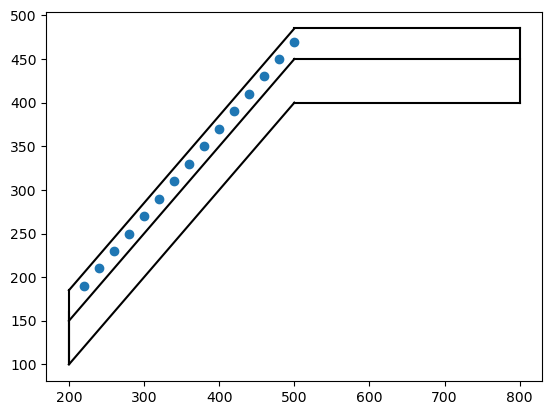

In [18]:
fig=plt.figure()
isx_array=np.arange(220,520,20)
isz_array=isx_array-30
x_slab=np.array([200,500])
y_slab=x_slab-200+100
y_slab2=x_slab-200
y_slab3=x_slab-15
y_slab4=x_slab-50
plt.plot(x_slab,y_slab,'k')
plt.plot([200,200],[100,160],'k')
        #plt.plot([500,500],[400,460],'k')
        #plt.plot([500,800],[450,450],'k')
plt.plot([500,800],[450+35,450+35],'k')
plt.plot([500,800],[400,400],'k')
plt.plot([500,800],[450,450],'k')
plt.plot([800,800],[400,450+35],'k')
plt.plot([200,200],[100,150+35],'k')
        #plt.plot([500,500],[400,460],'k')
plt.plot(x_slab,y_slab3,'k')
plt.plot(x_slab,y_slab4,'k')
plt.plot(isx_array,isz_array,'o')

In [15]:
%matplotlib notebook
from source import source
#source=source([isx_array[0],isz_array[0]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)
source=source([isx_array[0],200],'singleforce',1e27,f0,nt,dt,0,0,0,0,0.5,0.5,0)

import os

wavefield='wavefields_crustslab_tmp/'
path2 = os.path.join(pathrun, wavefield)

if os.path.exists(path2)==False:
    print('path build')
    os.mkdir(path2)
else:
    print('path exists')

path exists


initialization


<IPython.core.display.Javascript object>


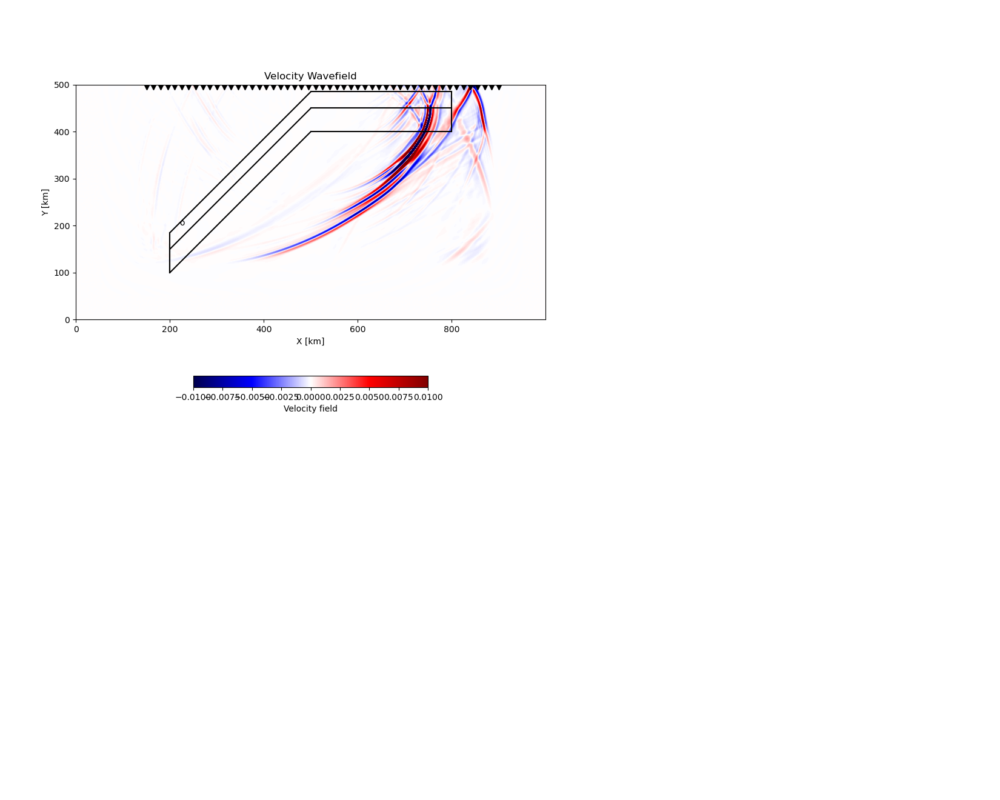

0:03:11.484643


In [16]:
vx2,vz2,seis1_x,seis1_z= assemble_psv(dx,dz,rho0,vp_obs,vs_obs,0.08,nt,nx,nz,irx,irz,source,damp,\
                                             10,10,path2,path2)

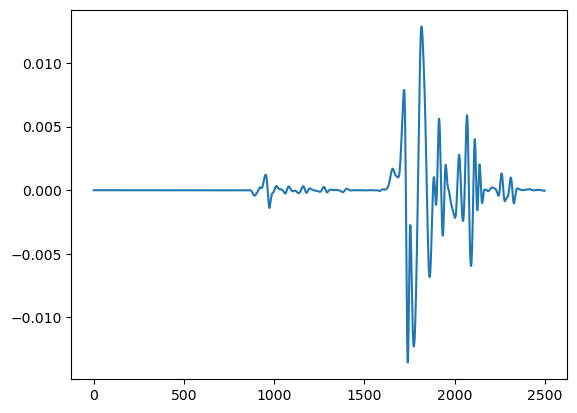

In [17]:
%matplotlib inline
plt.close()
plt.plot(seis1_z[30])

In [21]:
##check the sources locations 
for i in np.arange(int(len(isx_array))):
    print(i)
    print([isx_array[i],isz_array[i]])

0
[220, 190]
1
[240, 210]
2
[260, 230]
3
[280, 250]
4
[300, 270]
5
[320, 290]
6
[340, 310]
7
[360, 330]
8
[380, 350]
9
[400, 370]
10
[420, 390]
11
[440, 410]
12
[460, 430]
13
[480, 450]
14
[500, 470]


In [22]:
import multiprocessing

In [24]:
#pool_obj = multiprocessing.Pool()
def submission(value):
    from source import source
    source1=source([isx_array[value],isz_array[value]],'singleforce',1e27,f0,nt,dt,0,0,0,0,0.5,0.5,0)
    import os
    wavefield='wavefields_crustslab/event_'+str(value)+'/'
    path2 = os.path.join(pathrun, wavefield)

    if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
    else:
        print('path exists')
    print([isx_array[value],isz_array[value]])
    vx2, vz2,seis_x_i,seis_z_i= assemble_psv(dx,dz,rho0,vp_obs,vs_obs,dt,nt,nx,nz,irx,irz,source1,damp,\
                                             10,10,path2,path2,True,True)
    np.savetxt(path2+'seis_z.txt',seis_z_i)
    np.savetxt(path2+'seis_x.txt',seis_x_i)


path existspath exists

[220, 190][240, 210]

initializationinitialization



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


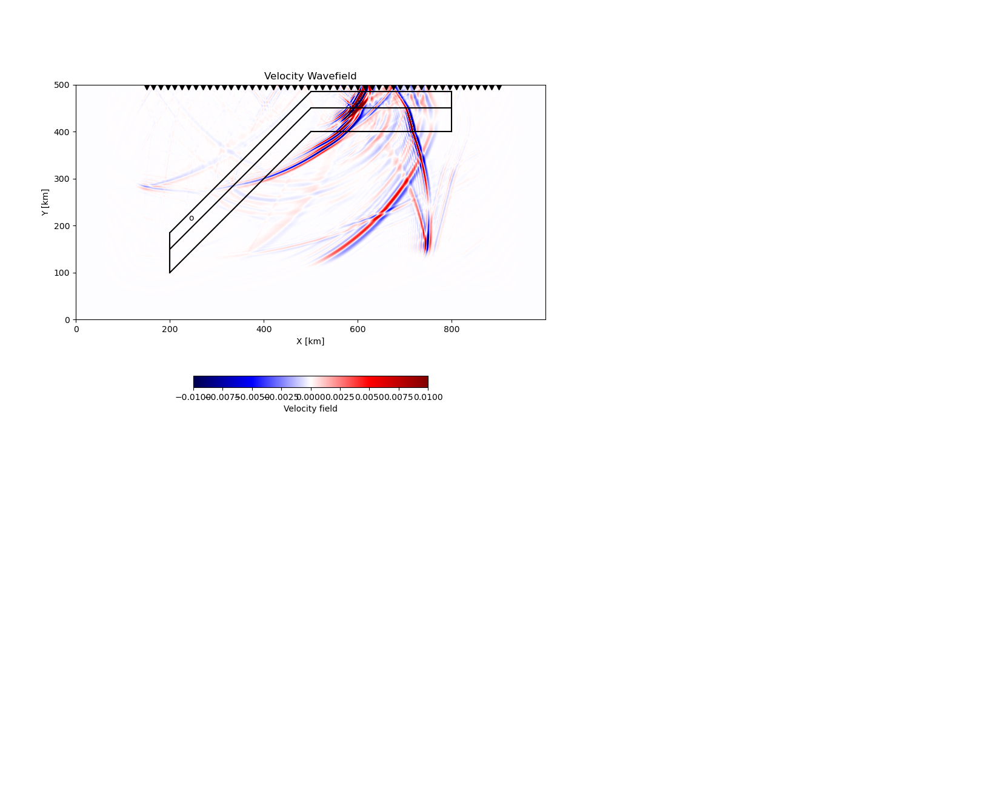


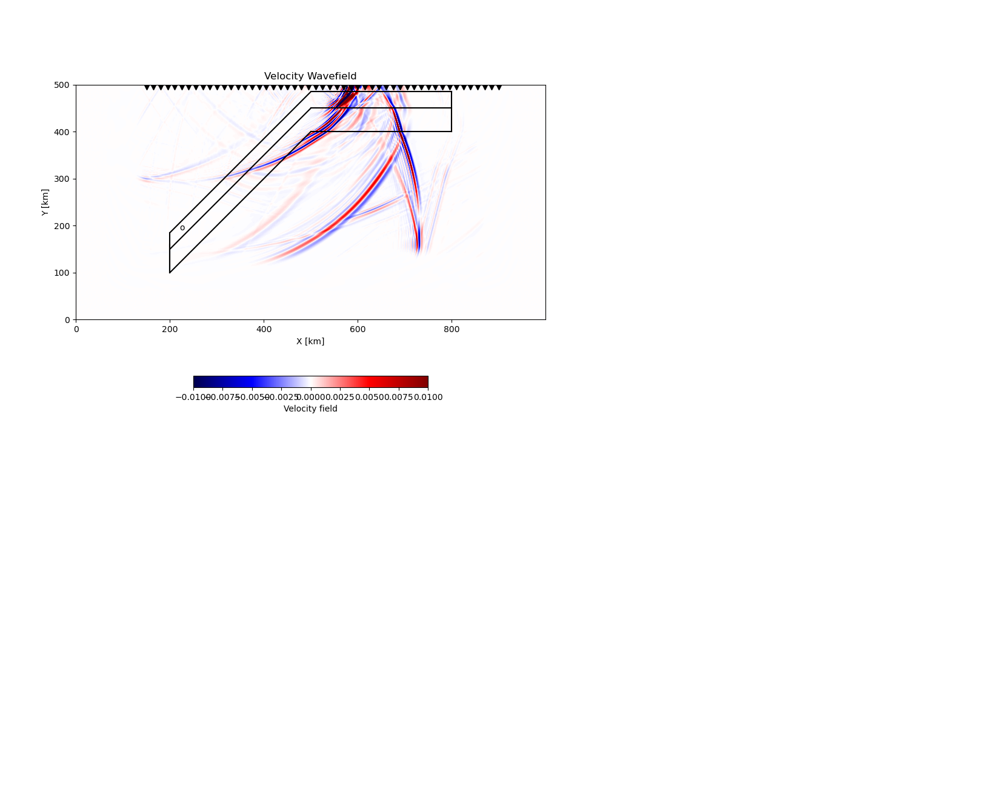

0:03:54.707215
0:03:54.720836


In [25]:
%matplotlib notebook
pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission,range(0,2))
pool_obj.close()

path existspath existspath existspath exists



[300, 270][320, 290][340, 310]
[360, 330]


initializationinitializationinitializationinitialization





<IPython.core.display.Javascript object>


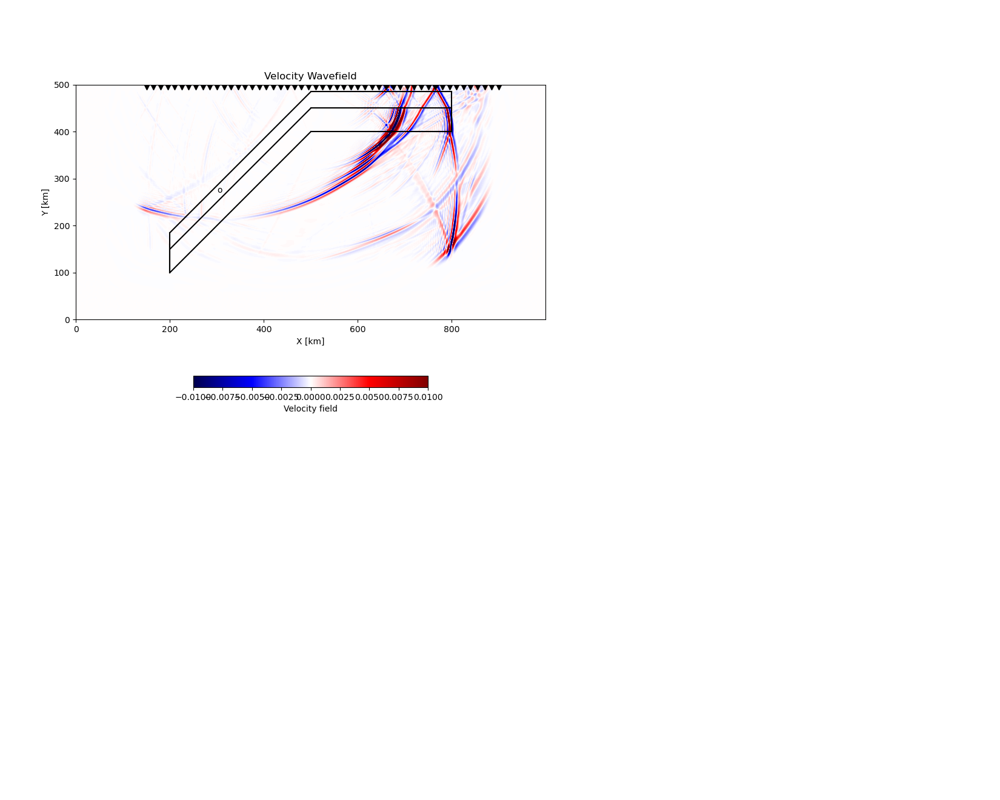

<IPython.core.display.Javascript object>


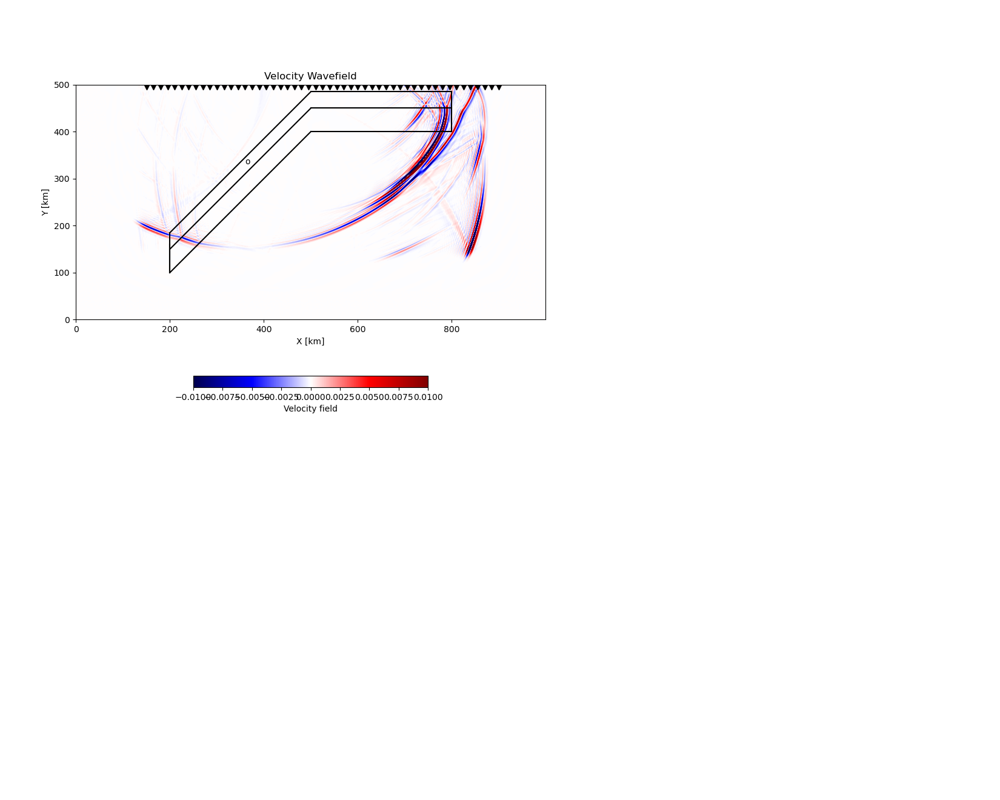

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


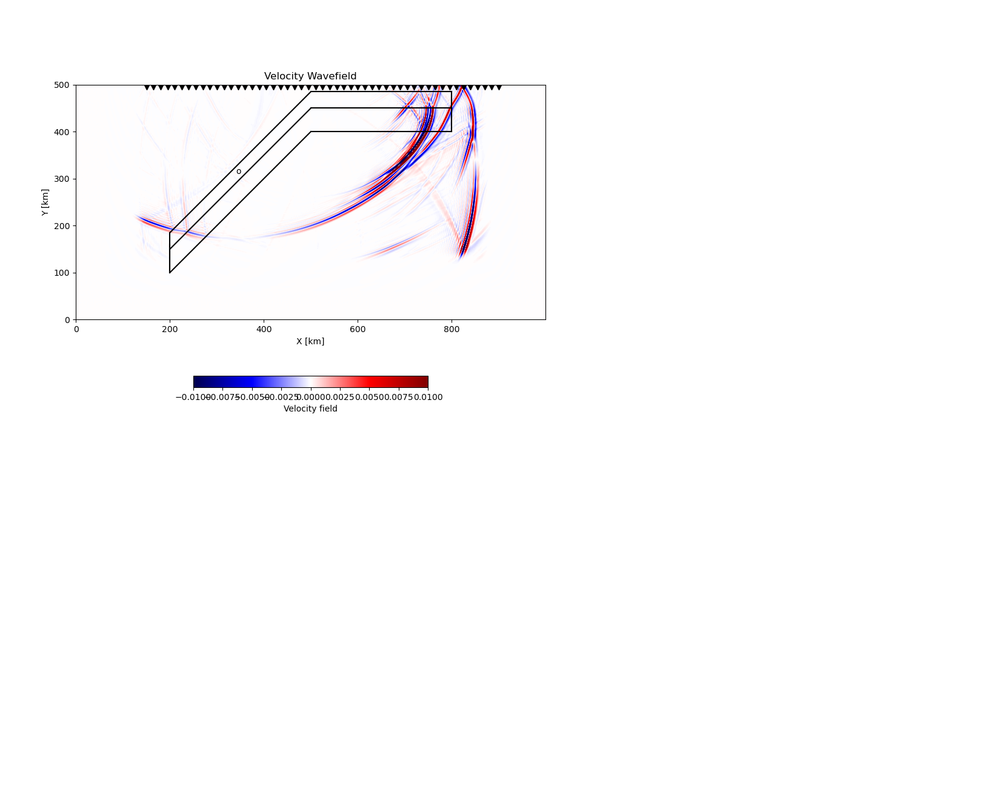


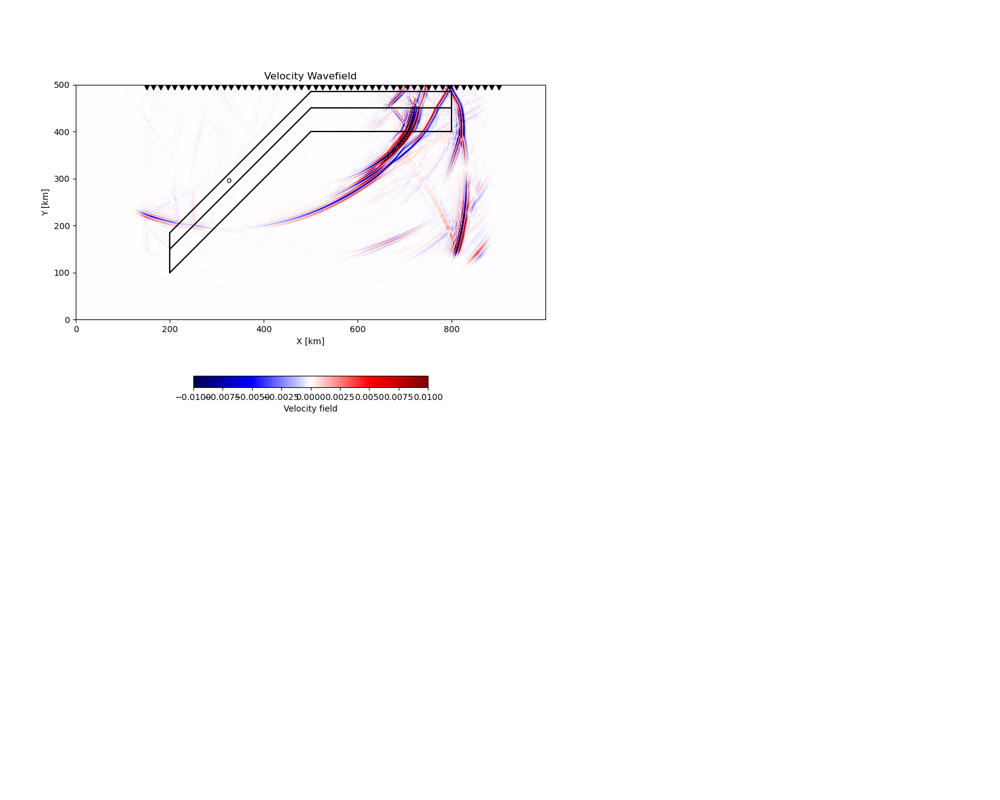

0:04:21.919538
0:04:23.357339
0:04:23.616241
0:04:24.449039
path existspath existspath existspath exists



[420, 390][400, 370][380, 350][440, 410]



initializationinitializationinitializationinitialization





<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


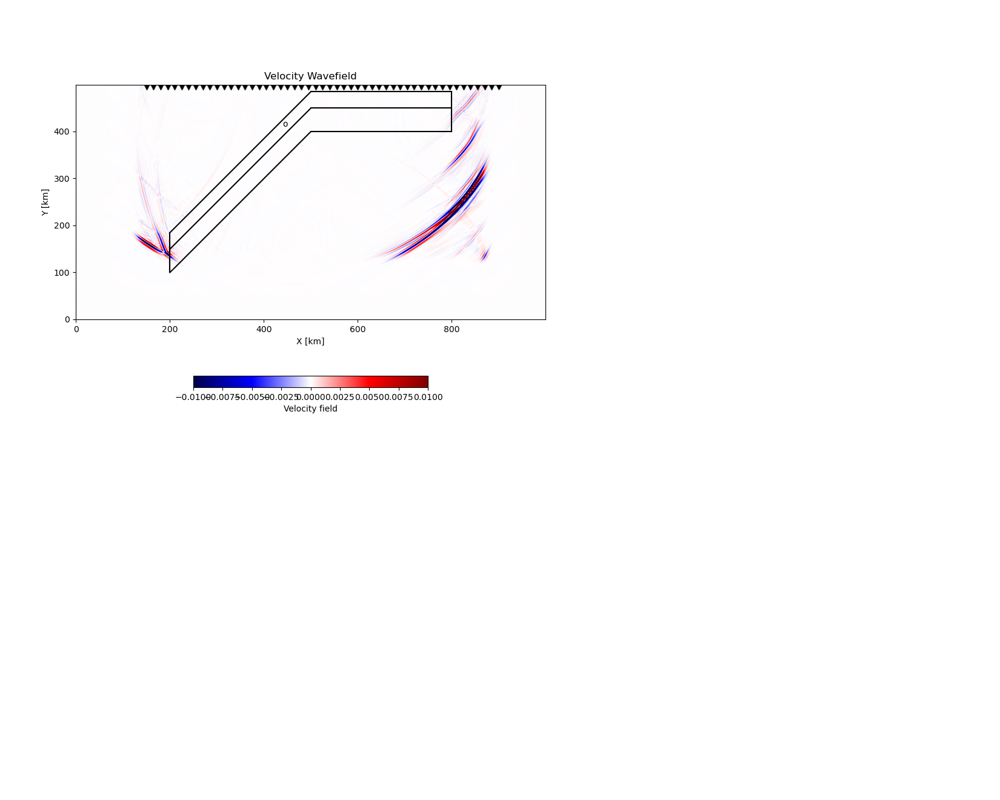


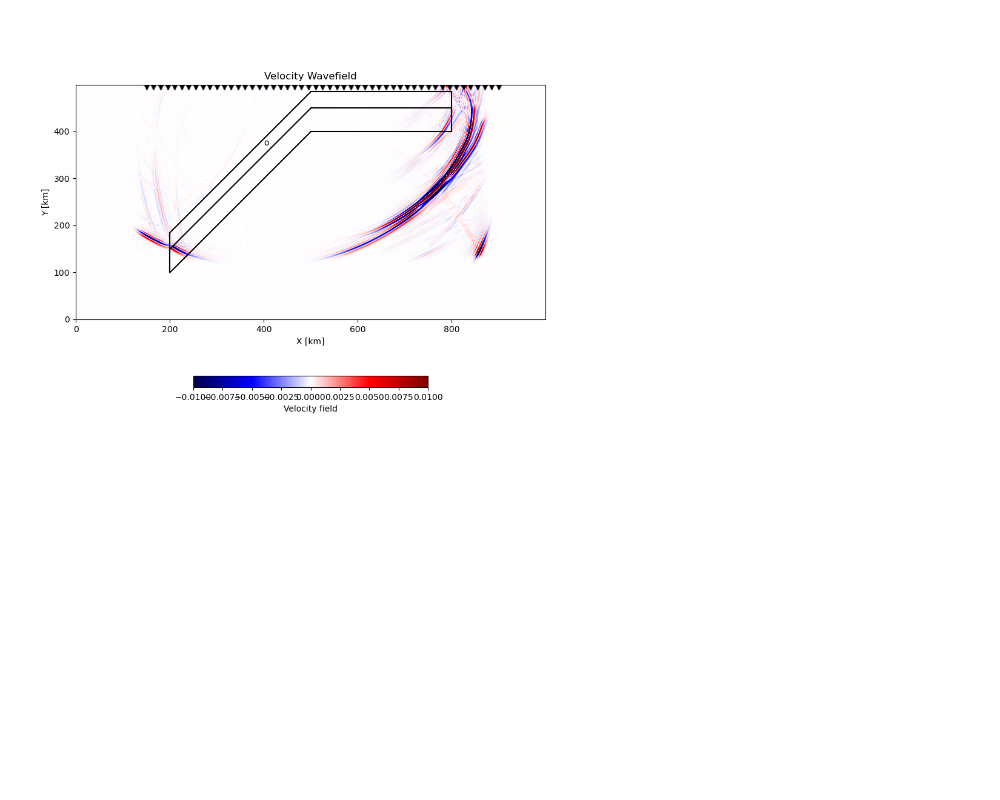


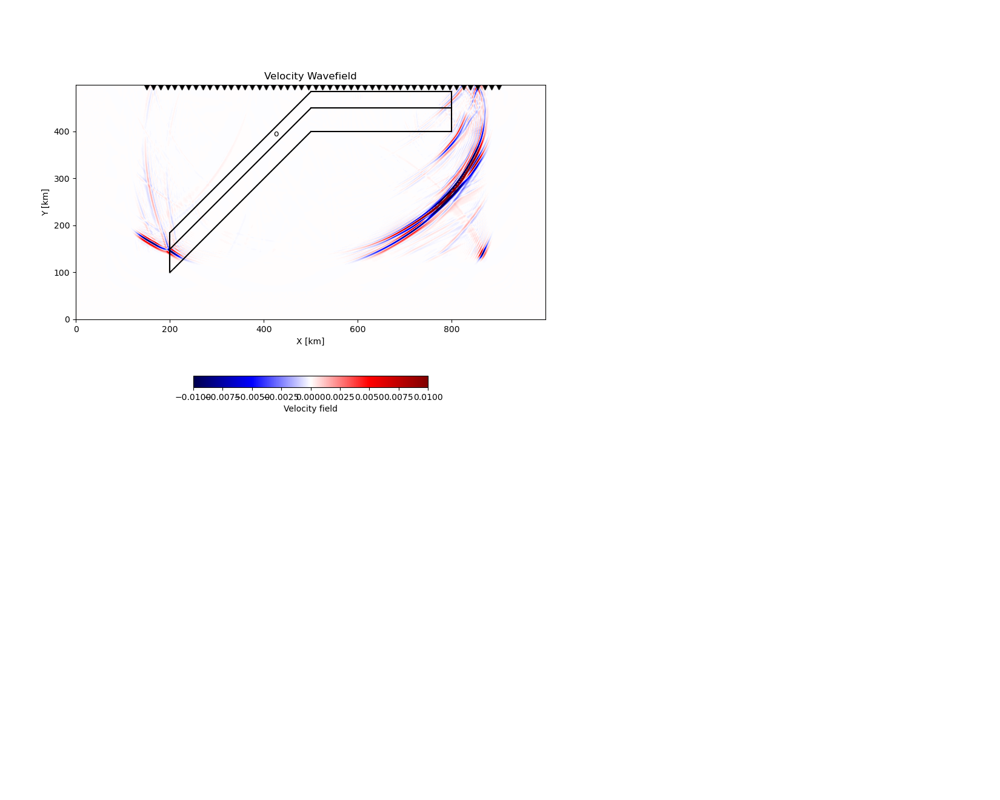


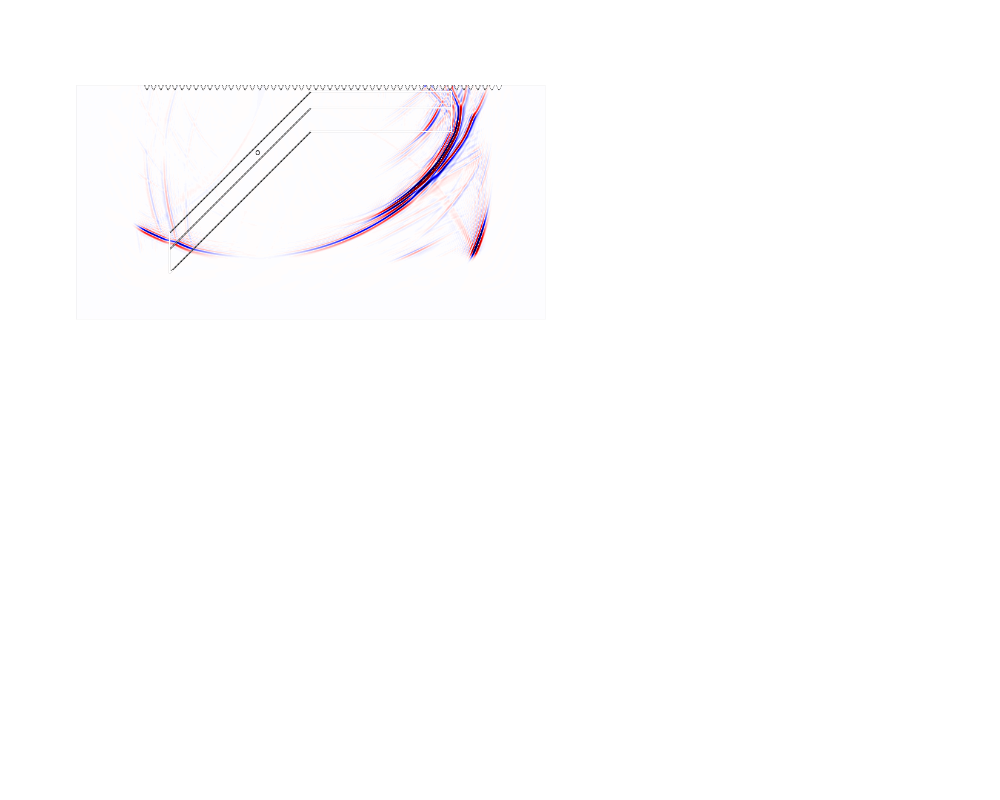

0:04:14.005487
0:04:14.949811
0:04:15.308935
0:04:15.338366
path existspath existspath exists


[500, 470][460, 430][480, 450]


initializationinitialization
initialization



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


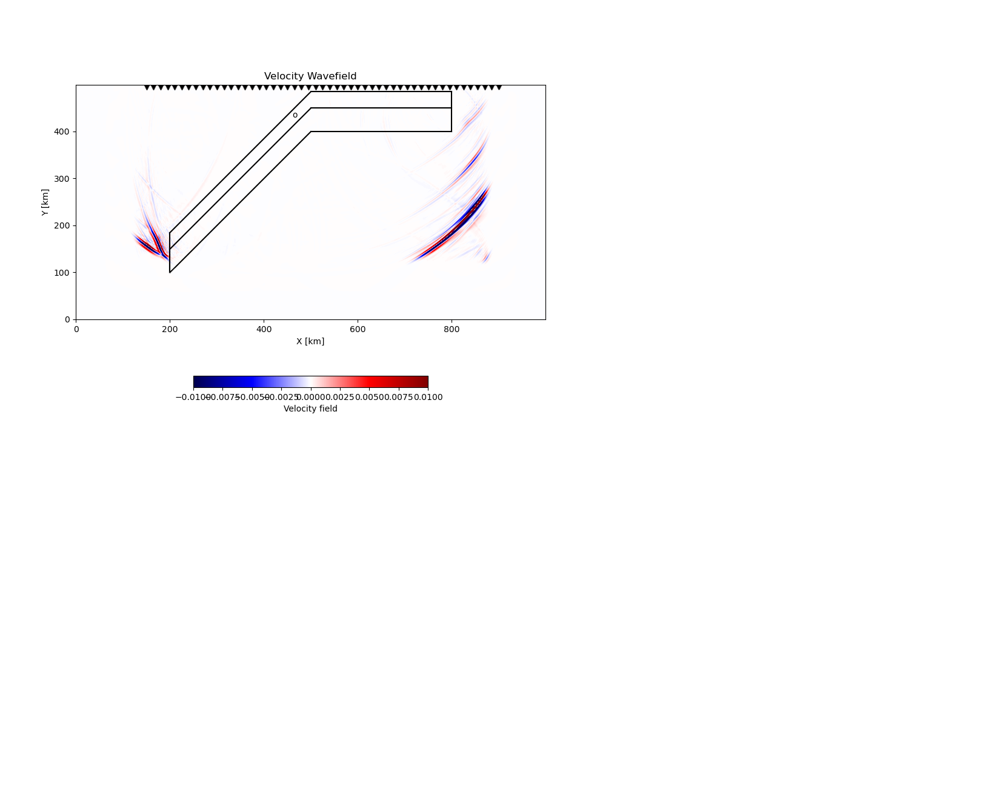


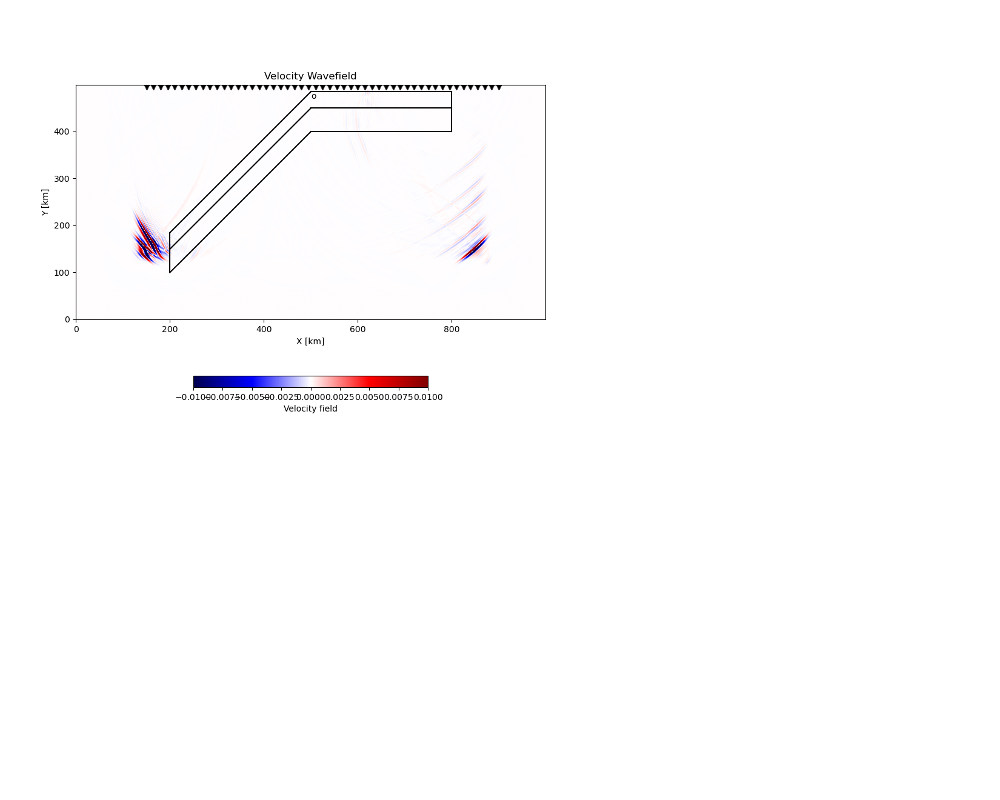


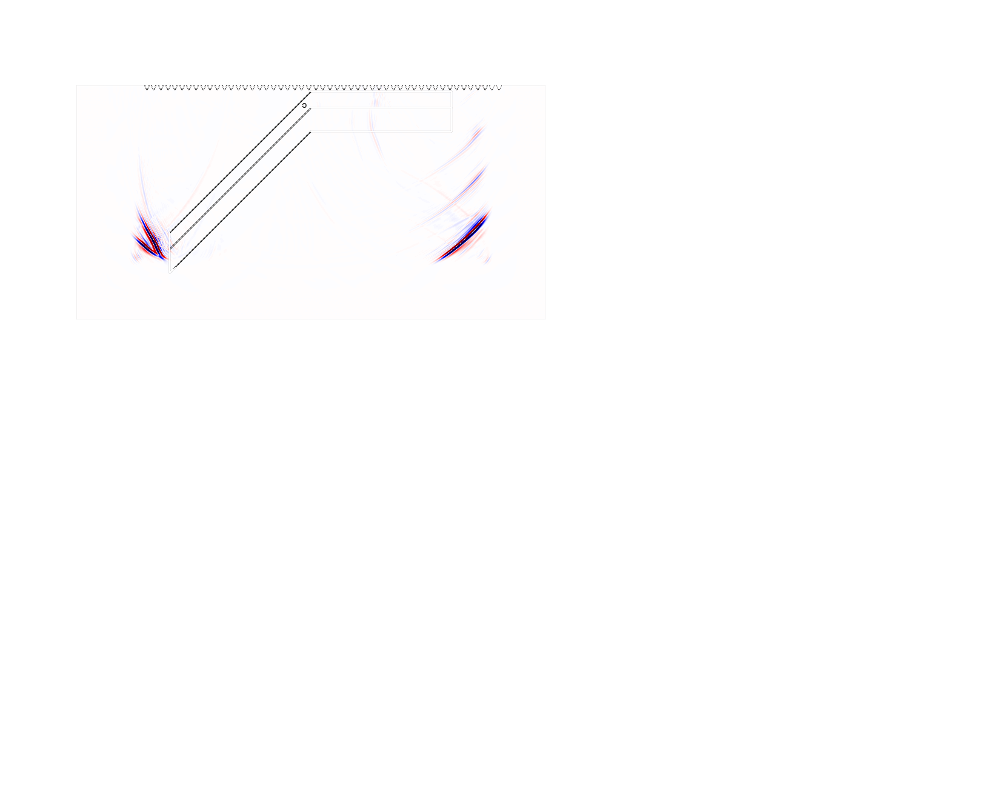

0:03:42.370642
0:03:42.804685
0:03:43.986000


In [26]:
pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission,range(4,8))
pool_obj.close()

pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission,range(8,12))
pool_obj.close()

pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission,range(12,15))
pool_obj.close()

replaced by submission functions
for i in np.arange(int(len(isx_array))):
#for i in np.arange(1):
    print(i)
    from source import source
    source1=source([isx_array[i],isz_array[i]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)
    import os
    pathrun='/scratch/gpi/seis/yjgao/FD_wavefield_snapshots/'
    path_snapshot='snapshots_crustslab/'
    wavefield='wavefields_crustslab/event_'+str(i)+'/'
    path2 = os.path.join(pathrun, wavefield)

    if os.path.exists(path0 )==False:
        print('path build')
        os.mkdir(path0)
    else:
        print('path exists')

    
    if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
    else:
        print('path exists')
        
    if os.path.exists(path1)==False:
        print('path build')
        os.mkdir(path1)
    else:
        print('path exists')
    print([isx_array[i],isz_array[i]])
    vx2, vz2,seis_x_i,seis_z_i= assemble_psv(dx,dz,rho0,vp_obs,vs_obs,dt,nt,nx,nz,irx,irz,source1,damp,\
                                             10,10,path2,path2,False,True)
    np.savetxt(path2+'seis_z.txt',seis_z_i)
    np.savetxt(path2+'seis_x.txt',seis_x_i)

In [29]:
#pool_obj = multiprocessing.Pool()
def submission_syn(value):
    from source import source
    source1=source([isx_array[value],isz_array[value]],'singleforce',1e27,f0,nt,dt,0,0,0,0,0.5,0.5,0)
    import os
   # path_snapshot='snapshots_crustslab_gao/'
    wavefield='wavefields_slab_2025/event_'+str(value)+'/'
    path2 = os.path.join(pathrun, wavefield)

    if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
    else:
        print('path exists')
    print([isx_array[value],isz_array[value]])
    vx2, vz2,seis_x_i,seis_z_i= assemble_psv(dx,dz,rho0,vp,vs,dt,nt,nx,nz,irx,irz,source1,damp,\
                                             10,10,path2,path2,True,True)
    np.savetxt(path2+'seis_z.txt',seis_z_i)
    np.savetxt(path2+'seis_x.txt',seis_x_i)


path existspath exists

[240, 210][220, 190]

initializationinitialization



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


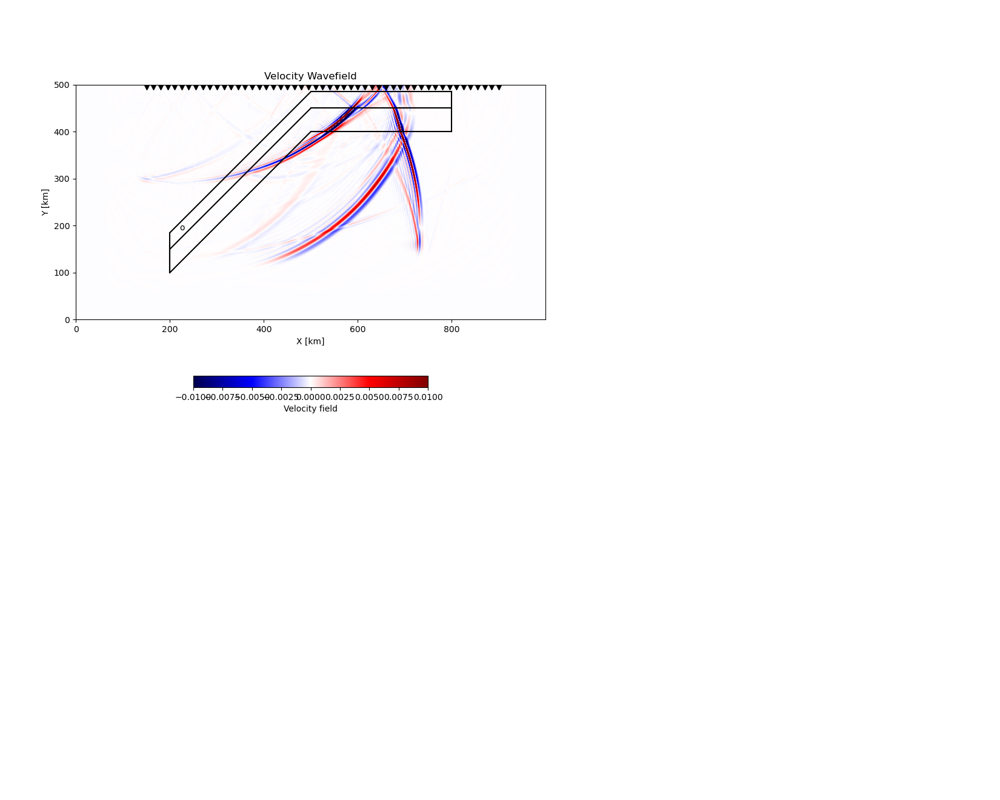


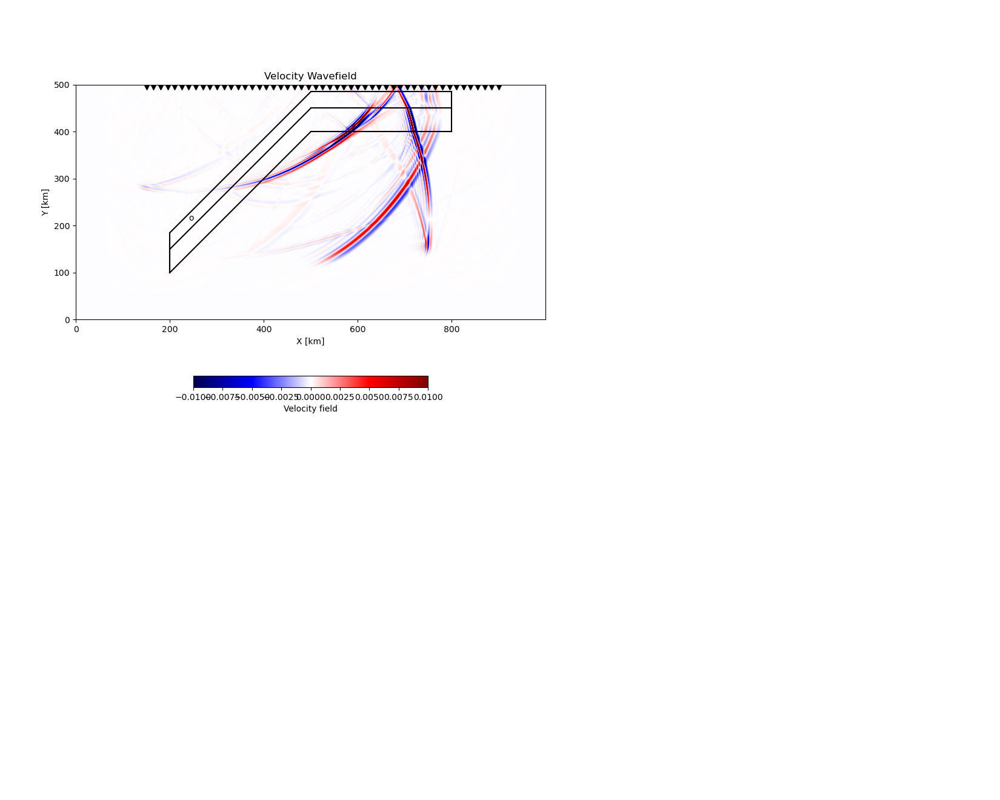

0:03:39.533214
0:03:39.606813


In [30]:
pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission_syn,range(0,2))
pool_obj.close()


path existspath exists

[260, 230][280, 250]

initializationinitialization



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


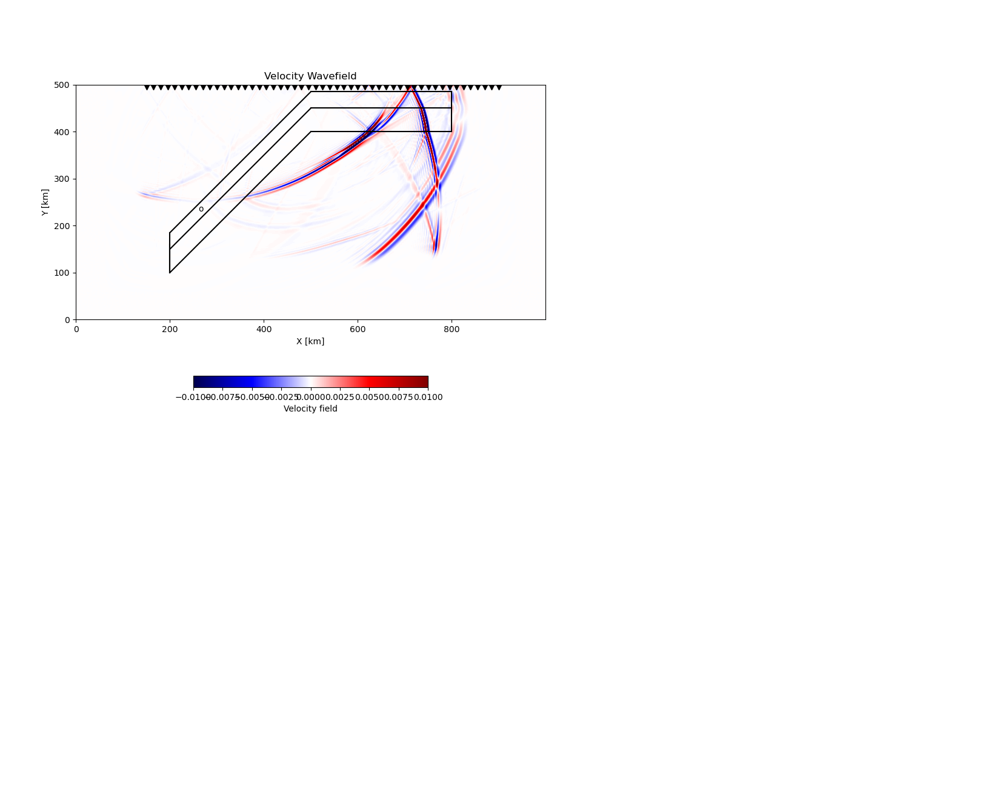


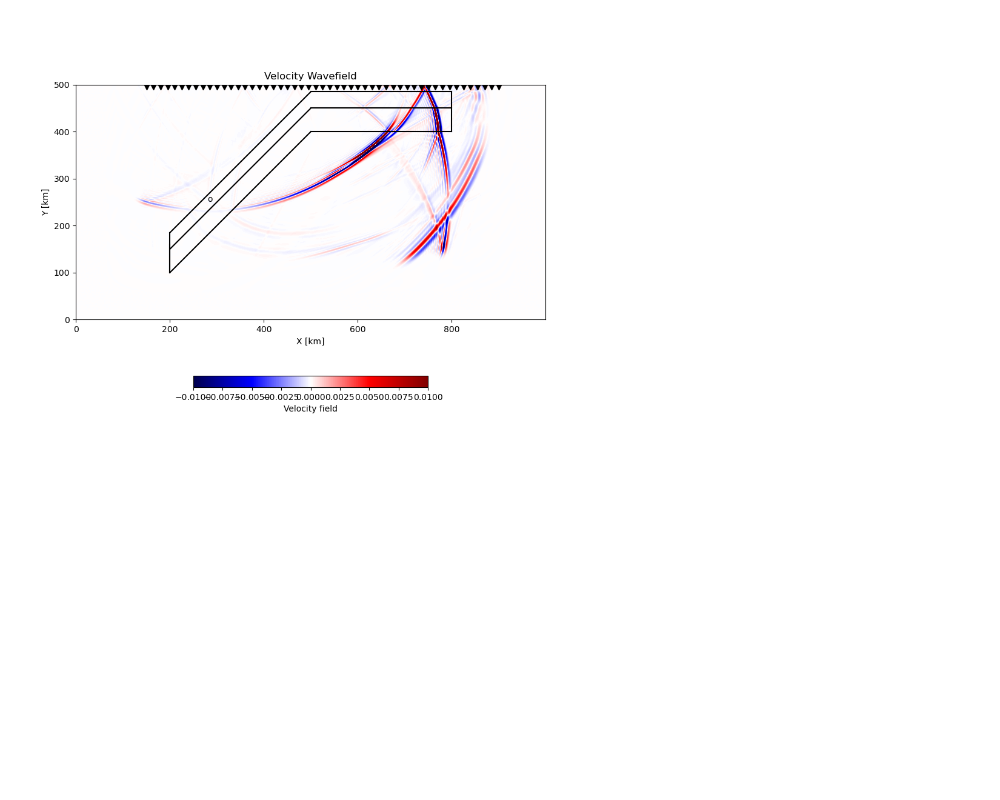

0:03:36.574363
0:03:36.719895
path existspath existspath existspath exists



[360, 330][340, 310][300, 270][320, 290]



initializationinitializationinitializationinitialization





<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


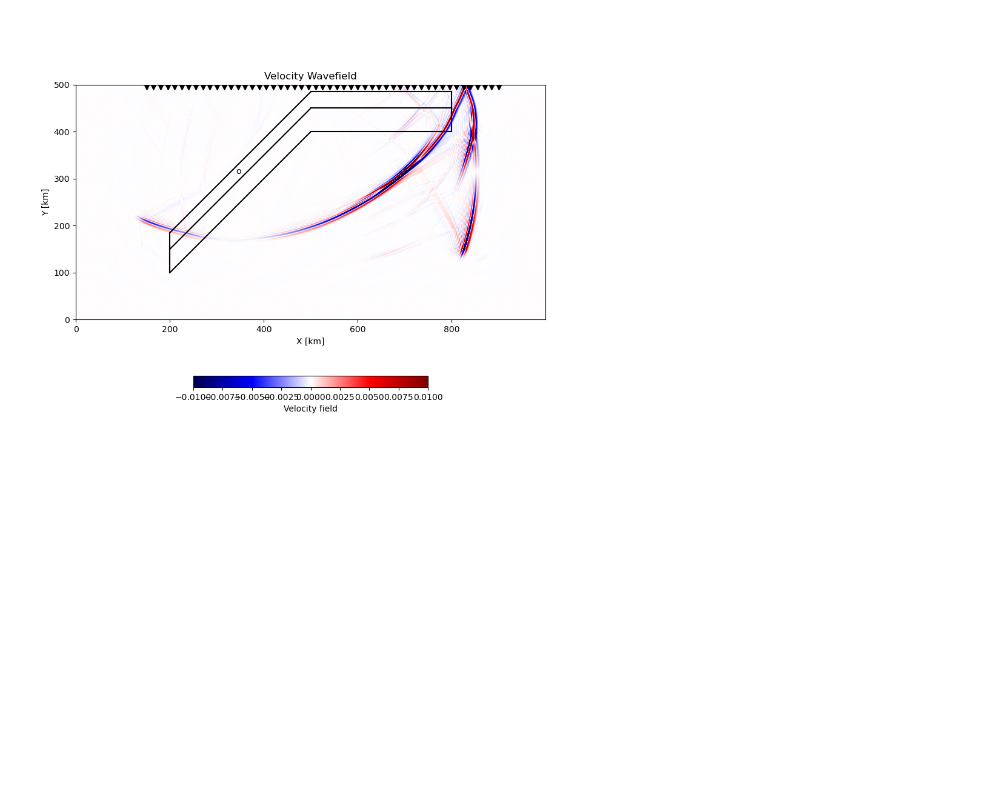


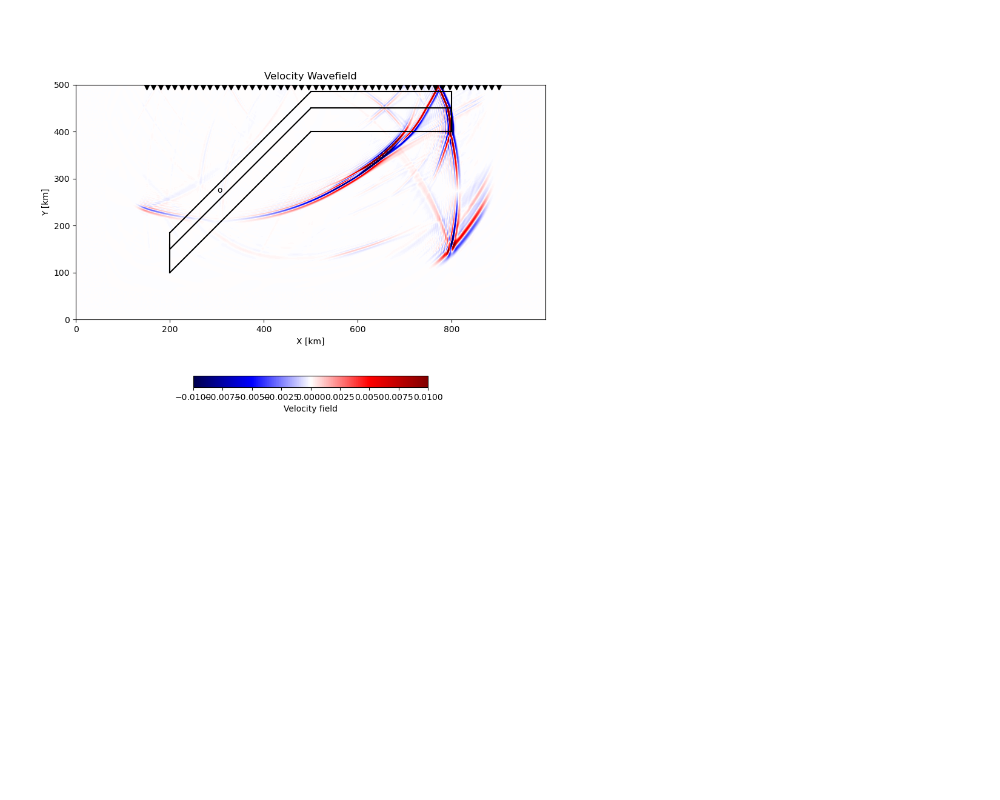


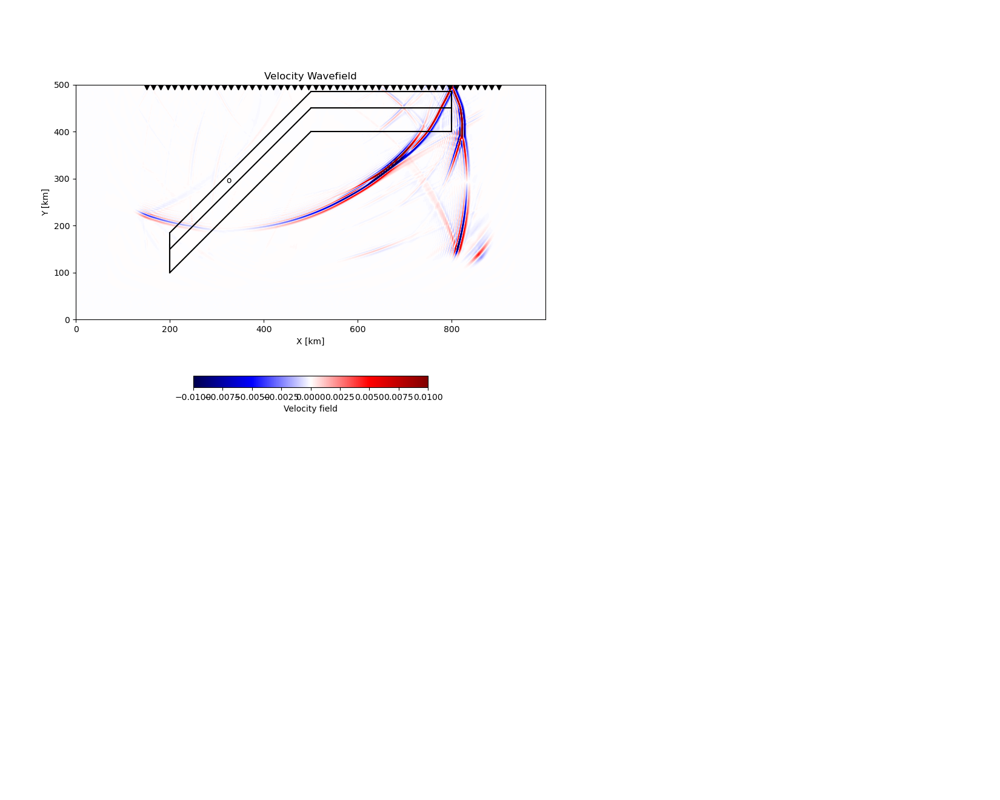

<IPython.core.display.Javascript object>


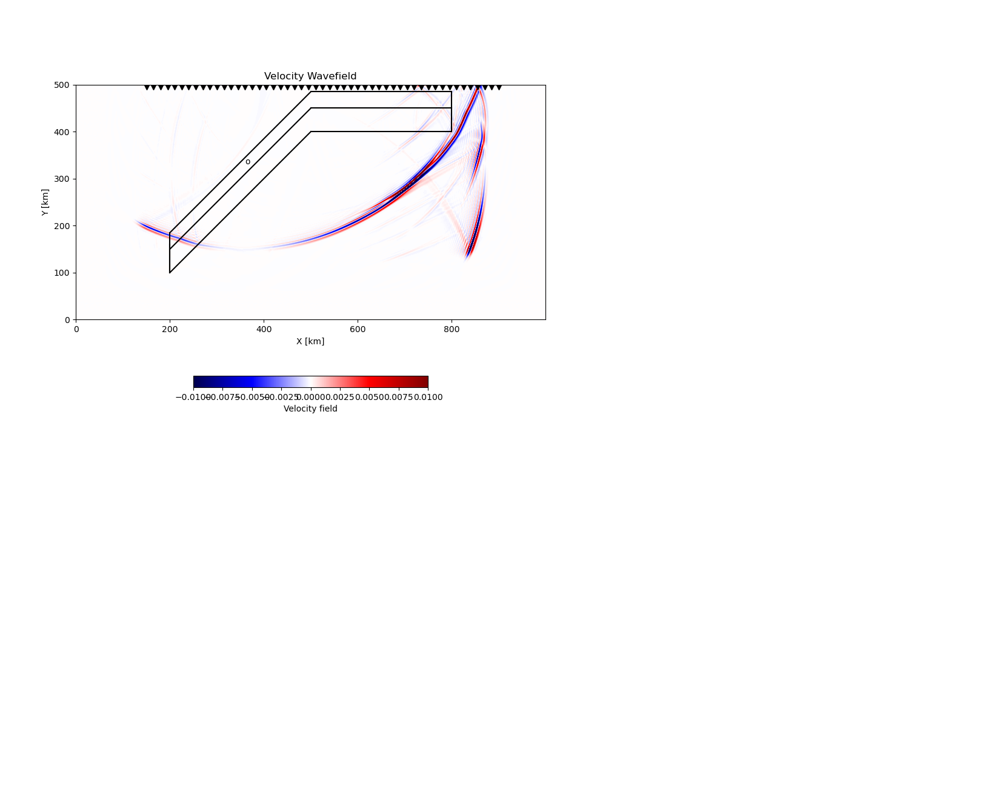

0:04:27.445248
0:04:28.686964
0:04:29.291166
0:04:29.991453
path existspath existspath existspath exists



[400, 370][440, 410][380, 350][420, 390]



initializationinitializationinitialization
initialization




<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


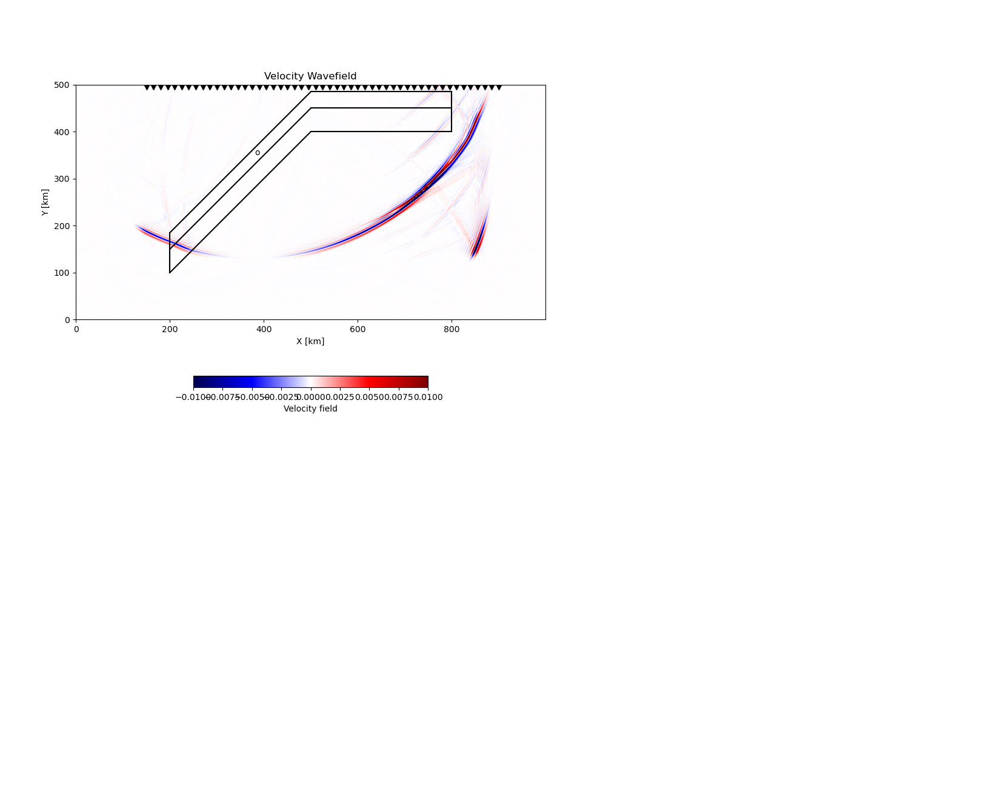


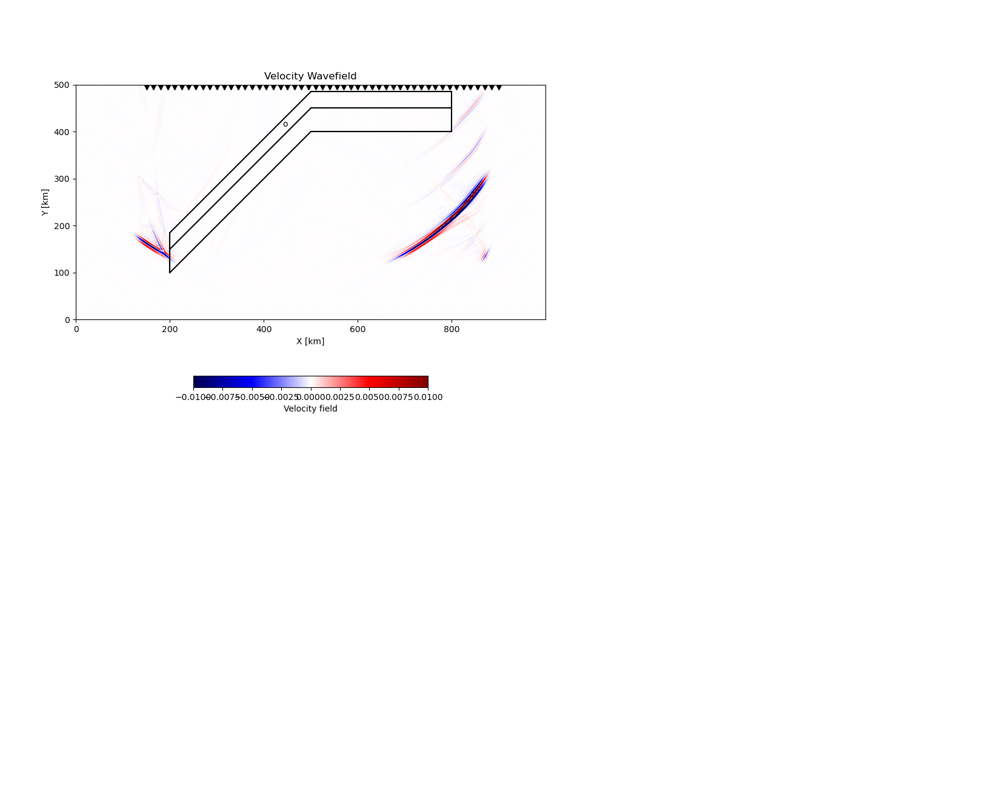


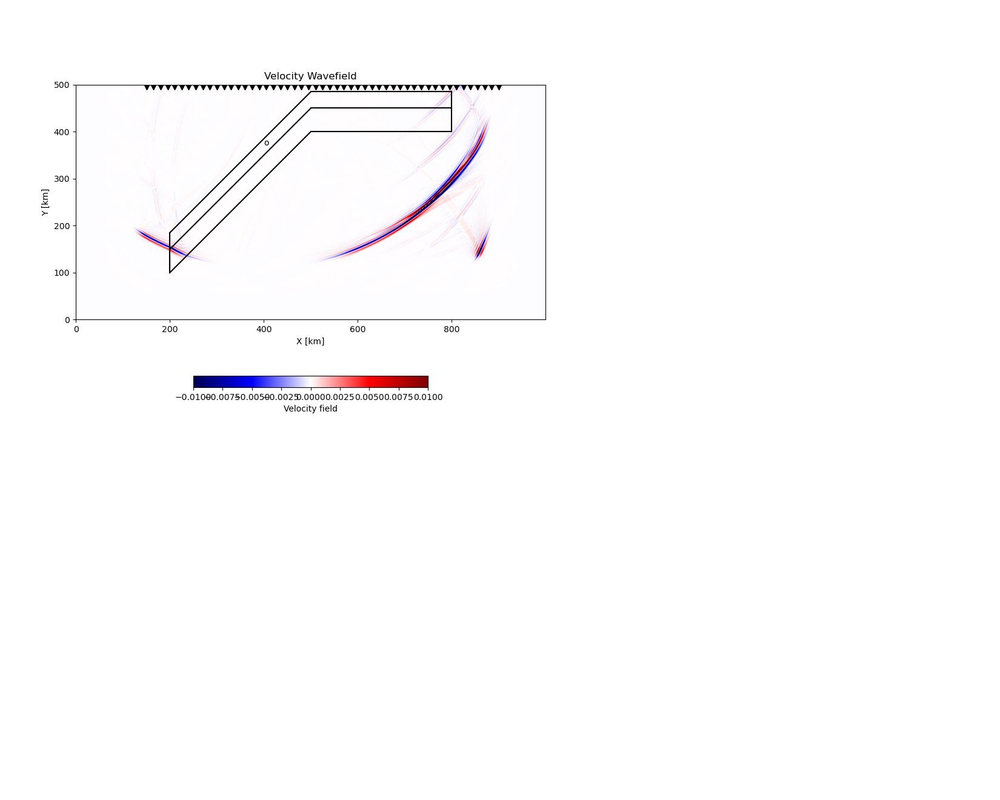


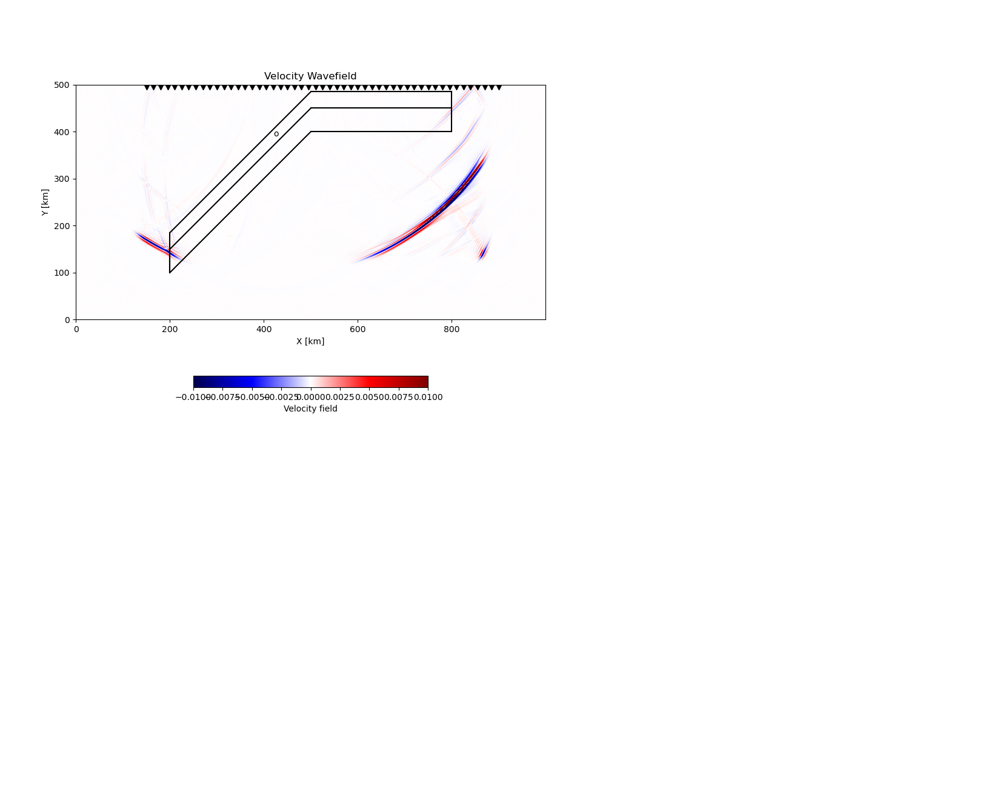

0:04:25.052370
0:04:27.023429
0:04:27.209950
0:04:27.231458
path existspath existspath exists


[480, 450][500, 470][460, 430]


initializationinitializationinitialization




<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


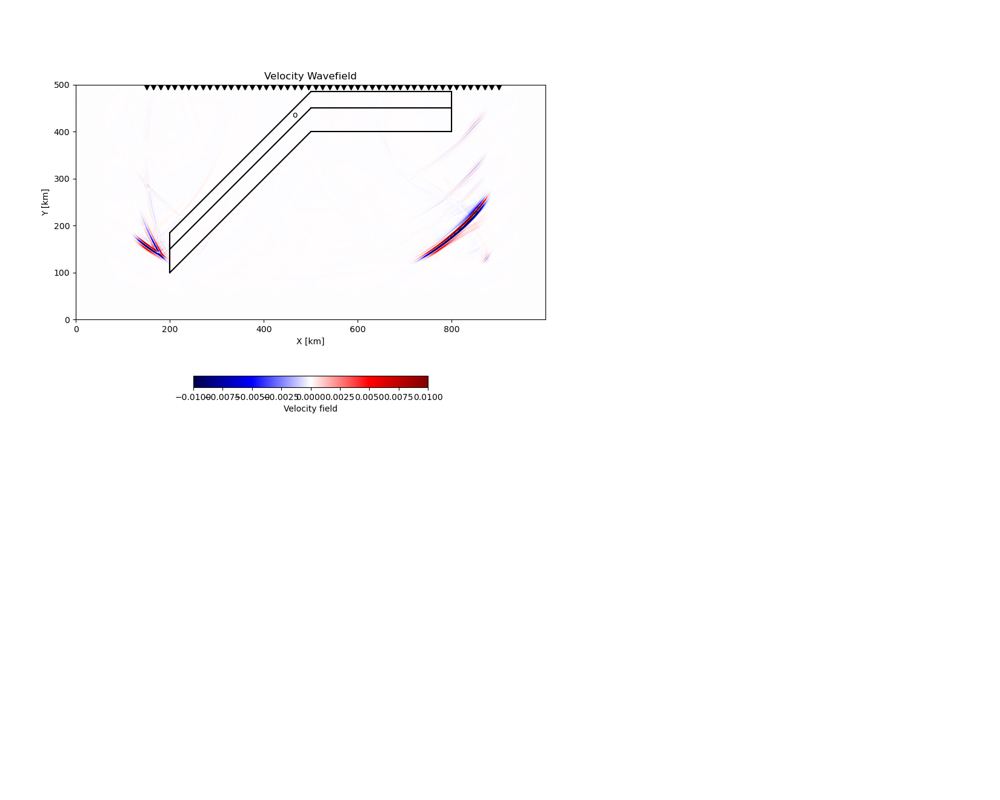

<IPython.core.display.Javascript object>


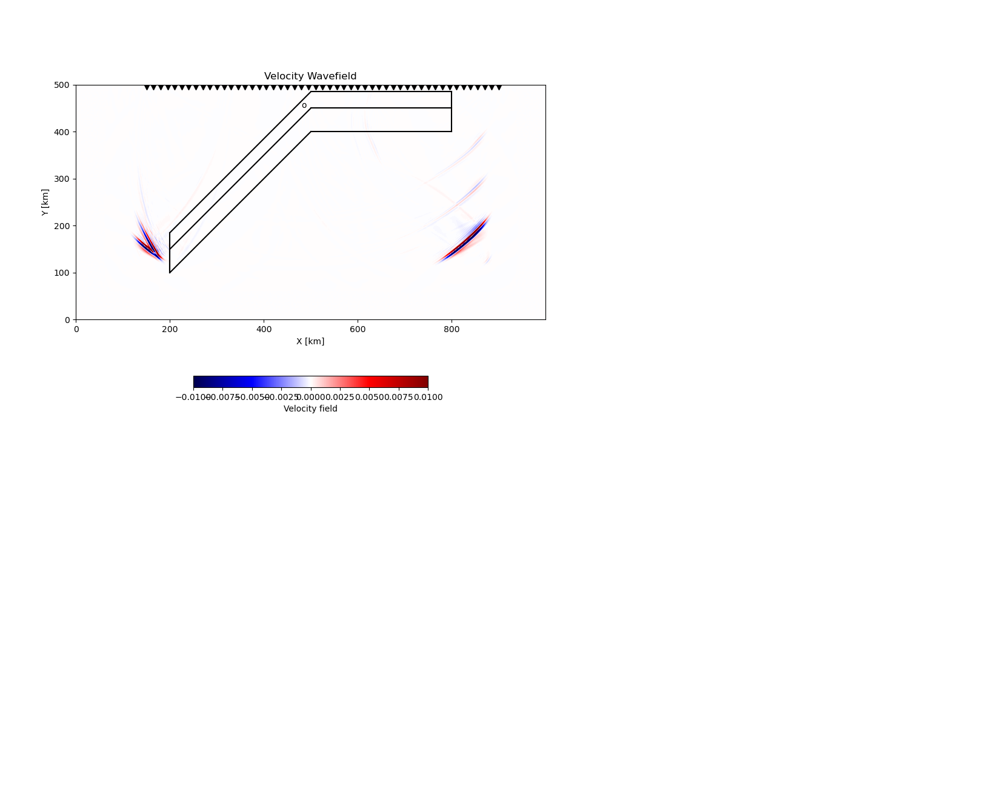


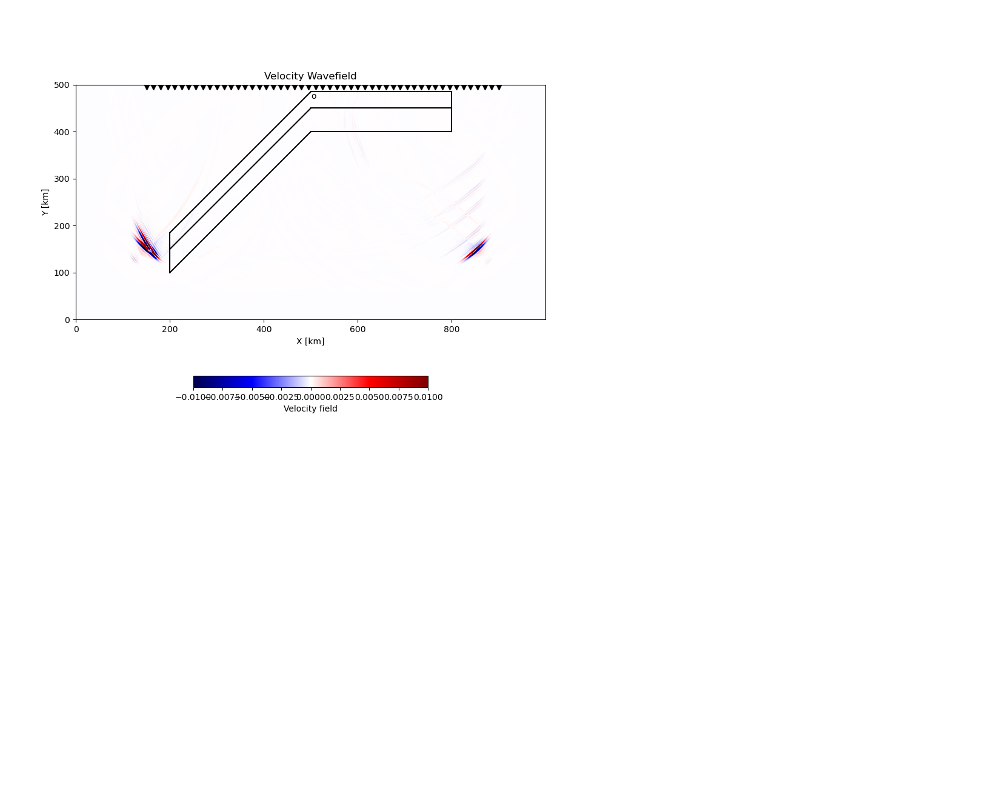

0:03:55.124361
0:03:55.302522
0:03:56.210675


In [31]:
pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission_syn,range(2,4))
pool_obj.close()

pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission_syn,range(4,8))
pool_obj.close()

pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission_syn,range(8,12))
pool_obj.close()

pool_obj = multiprocessing.Pool()
ans = pool_obj.map(submission_syn,range(12,15))
pool_obj.close()

replaced by submission functions
for i in np.arange(int(len(isx_array))):
#for i in np.arange(1):
    print(i)
    from source import source
    source1=source([isx_array[i],isz_array[i]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)
    import os
    pathrun='/scratch/gpi/seis/yjgao/FD_wavefield_snapshots/'
    path_snapshot='snapshots_crustslab/'
    wavefield='wavefields_slab/event_'+str(i)+'/'
    path1 = os.path.join(pathrun, path_snapshot)
    path2 = os.path.join(pathrun, wavefield)
    if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
    else:
        print('path exists')
    print([isx_array[i],isz_array[i]])
    vx2, vz2,seis_x_i,seis_z_i= assemble_psv(dx,dz,rho0,vp,vs,dt,nt,nx,nz,irx,irz,source1,damp,\
                                             10,10,path2,path2,False,True)
    np.savetxt(path2+'seis_z.txt',seis_z_i)
    np.savetxt(path2+'seis_x.txt',seis_x_i)

In [32]:
def traveltime(nz,nx,rex,source):
    src_x=source.location[0]
    src_z=source.location[1]
    dist=np.sqrt(np.square(500-src_z)+np.square(src_x-rex))
    traveltime_P=np.sqrt(np.square(500-src_z)+np.square(src_x-rex))/7*1.05
    return dist,traveltime_P
#plt.figure()
def read_data(file):
    data=np.loadtxt(file)
    return data

45.54667935206693
44.93119740225048
44.421278684882544
44.02059177248756
43.73213921133976
43.55815078719481
43.50000000000001
43.55815078719481
43.73213921133976
44.02059177248756
44.421278684882544
44.93119740225048
45.54667935206693
46.26351153987341
47.07706447942565
47.98241865516994
48.97448315194353
50.048101862108616
51.198144497628036
52.419581265019666
53.707541369904476
55.05735645669886
56.464590674156135
57.92505934394889
59.434838268476845
60.990265616735925
62.5879381350752
64.22470319121763
65.8976479094664
67.6040864149498
69.34154598795733
71.10775274187759
72.90061728133719
74.71822066939228
76.55880093104906
78.42074024134176
80.30255288594503
82.20287403734739
84.12044935685972
86.05412540953515
88.00284086323579
89.96561843282132
91.94155752433173
93.92982753098188
95.92966173191688
97.94035174533529
99.96124248927681
101.99172760572301
104.03124530639822
106.07927460159219


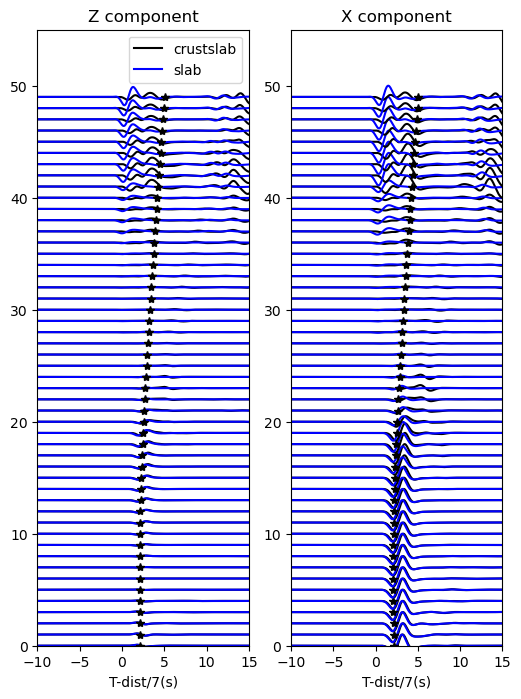

In [33]:

seis7_z=read_data(pathrun+'wavefields_crustslab/event_1/seis_z.txt')
seis7_x=read_data(pathrun+'wavefields_crustslab/event_1/seis_x.txt')
seis6_z=read_data(pathrun+'wavefields_slab_2025/event_1/seis_z.txt')
seis6_x=read_data(pathrun+'wavefields_slab_2025/event_1/seis_x.txt')
from source import source
source=source([isx_array[1],isz_array[1]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)

%matplotlib inline
plt.figure(figsize=(6, 8))
time = np.arange(2500) * dt
plt.subplot(121)
for i in np.arange(0,50):
    dist,traveltime_P=traveltime(nz,nx,irx[i],source)
    if i==0:
        #plt.plot(time,seis5_z[i]/np.abs(seis5_z[i]).max()+i,'k',label='withanomaly')
        plt.plot(time-dist/7,seis7_z[i]/np.abs(seis7_z[i]).max()+i,'k',label='crustslab')
        plt.plot(time-dist/7,seis6_z[i]/np.abs(seis6_z[i]).max()+i,'b',label='slab')
    else:
        plt.plot(time-dist/7,seis7_z[i]/np.abs(seis7_x[i]).max()+i,'k')
        plt.plot(time-dist/7,seis6_z[i]/np.abs(seis6_x[i]).max()+i,'b')
    
    print(traveltime_P)
    plt.plot(traveltime_P-dist/7,i,'k*')
    #traveltime_P=traveltime(nz,nx,irx[i],25,250)
    #plt.plot(traveltime_P,i,'b*')
plt.xlabel('T-dist/7(s)')
plt.xlim(-10,15)
plt.ylim(0,55)
plt.title('Z component')
plt.legend()
plt.subplot(122)
for i in np.arange(0,50):
    dist,traveltime_P=traveltime(nz,nx,irx[i],source)
    plt.plot(time-dist/7,seis7_x[i]/np.abs(seis7_x[i]).max()+i,'k')
    plt.plot(time-dist/7,seis6_x[i]/np.abs(seis6_x[i]).max()+i,'b')
    #traveltime_P=traveltime(nz,nx,irx[i],5,180,source)
    plt.plot(traveltime_P-dist/7,i,'k*')
    #traveltime_P=traveltime(nz,nx,irx[i],25,250)
    #plt.plot(traveltime_P,i,'b*')
plt.ylim(0,55)
plt.title('X component')
plt.xlim(-10,15)
plt.xlabel('T-dist/7(s)')
plt.show()


In [34]:

import datetime


def assemble_psv_adj(dx,dz,rho0,vp,vs,dt,nt,nx,nz,irx,irz,isx,isz,src_x,src_z,damp,pathsnap,path_wavefield,\
                     isnap,iswave,vmin,vmax):
    t1 = datetime.datetime.now() 
    rho=np.zeros((nx,nz))+rho0
    mu = np.zeros((nx,nz))+rho*vs**2
    lamd=np.zeros((nx,nz))+rho*vp**2-2*mu
    ##### initial the cycle
    vx = np.zeros((nx, nz))
    vz = np.zeros((nx, nz))
    sxx = np.zeros((nx, nz)) 
    sxz = np.zeros((nx, nz))
    szz = np.zeros((nx, nz))
    szx=np.zeros((nx, nz))
    seis = np.zeros((len(irx), nt))
    #print(np.shape(seis))
    ir = np.arange(len(irx))
    stencil=2
    ni1=stencil+4
    ni2=nx-stencil-4
    nk1=stencil+4
    nk2=nz-stencil-1
    fig = plt.figure(figsize=(10,8))
    #plt.plot(x[isx-200:isx+202]/1000,100*np.sqrt(2*np.abs((x[isx-200:isx+202]/1000-isx)/100)\
                                               #  -((x[isx-200:isx+202]/1000-isx)/100)**2)+isz,'r')
    #plt.plot(x[isx-200:isx+202]/1000,100*(-2.14)*(np.sqrt(np.sqrt(2)-\
                                                     #     np.sqrt(np.abs((x[isx-200:isx+202]/1000-isx)\
                                                    #                     /100))))+isz,'r')
    #extent = [np.min(),np.max(X),np.min(X),np.max(Y)]
    image = plt.imshow(vz.T, animated=True, cmap=cm.seismic, interpolation='bicubic', vmin=vmin, vmax=vmax)#cmap=plt.cm.RdBu
    #image = plt.imshow(vp.T/100000, animated=True, cmap=cm.seismic, interpolation='nearest', vmin=-0.001, vmax=0.001)
   # plt.colorbar()
    plt.colorbar(shrink=0.5, orientation='horizontal',label='Velocity field')
    plt.title('Velocity Wavefield')
    plt.xlabel('X [km]')
    plt.ylabel('Y [km]')
    plt.gca().invert_yaxis()
    plt.text(isx, isz, 'o')
    #x_slab=np.array([100,400])
    #y_slab=x_slab-100+50
    #y_slab2=x_slab-100
    #y_slab3=x_slab-40
    #plt.plot(x_slab,y_slab,'k')
    #plt.plot([100,100],[0,60],'k')
    #plt.plot(x_slab,y_slab2,'k')
    #plt.plot(x_slab,y_slab3,'k')
    #plt.ion()
    plt.show(block=False)
    
    #### free surface by image
    #plt.text(isx, isz, 'o')
    for i in range(len(irx)):
        plt.plot(irx[i], irz[i], 'vk')
    #fig.canvas.draw()
    m=0
    exx=np.zeros((nx,nz))
    exz=np.zeros((nx,nz))
    ezz=np.zeros((nx,nz))
    ezx=np.zeros((nx,nz))
    for it in np.arange (nt):
        print(it)
       # szz[:,nk2]=0
        #for n in range(0,stencil-1):
        #    szz[:,nk2+1+n]=-szz[:,nk2-1-n]
         #   sxz[:,nk2+n]=-sxz[:,nk2-n-1]
        vx, vz = update_v(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,ni1,ni2,nk1,nk2,lamd,mu)
        #print(vz.max())
        vx=vx*damp
        vz=vz*damp
       # vz[:,nk2  :nz]  = 0.0;
       # vx[:,nk2+1:nz]  = 0.0;
        vz[isx,isz]=vz[isx,isz]
        vx[isx,isz]=vx[isx,isz]
        ###for the receivers
        for k in np.arange(len(irx)):
            #print(vz[int(irx[k]),int(irz[k])])
            seis[k,it]=seis[k,it]+vz[int(irx[k]),int(irz[k])]
        #sxx,sxz,szz,szx,exx_rate,exz_rate,ezz_rate,ezx_rate = update_s(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,ni1,ni2,nk1,nk2,lamd,mu)
        
        sxx,sxz,szz,szx,exx_rate,exz_rate,ezz_rate,ezx_rate=update_s(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,\
                 ni1,ni2,nk1,nk2,lamd,mu,np.zeros((nx,nz)),\
                 np.zeros((nx,nz)),np.zeros((nx,nz)),np.zeros((nx,nz)))
        #####source position
        szz[isx,isz]=szz[isx,isz]+src_z[it]
        sxx[isx,isz]=sxx[isx,isz]+src_x[it]
        exx=exx+exx_rate*dt
        exz=exz+exz_rate*dt
        ezz=ezz+ezz_rate*dt
        ezx=ezx+ezx_rate*dt
       # print('size of exx',exx)
        if (it % iswave) == 0:
            np.save(path_wavefield+'exx'+str(it)+'.npy',exx)
            np.save(path_wavefield+'exz'+str(it)+'.npy',exz)
            np.save(path_wavefield+'ezz'+str(it)+'.npy',ezz)
            np.save(path_wavefield+'ezx'+str(it)+'.npy',ezx)
        #sxz[isx,isz]=sxz[isx,isz]+src[it]
        #vx[isx,isz]=vx[isx,isz]
        #sxx=sxx*damp
        #sxz=sxz*damp
        #szz=szz*damp
        #szx=szx*damp
        if (it % iswave) == 0:
            #m=m+1
            #print(np.shape(vz))
            image.set_data(vz.T)
            
            #plt.text(600,250,str(it*3)+'s')
            plt.savefig(pathsnap+str(it)+'adj.png')
            fig.canvas.draw()
        
        #for i in np.arange(100,400):
        #vp[i][i-100:i-100+50]=1.1*vp[i][i-100:i-100+50]

        plt.ylim(0,500)
        
    t2 = datetime.datetime.now()   
    print(t2-t1)
    plt.close()
    return vx, vz,seis



In [35]:

import datetime



def assemble_psv_adj_multirec(dx,dz,rho0,vp,vs,dt,nt,nx,nz,adj,damp,pathsnap,path_wavefield,isnap,iswave,vmin,vmax):
    t1 = datetime.datetime.now() 
    rho=np.zeros((nx,nz))+rho0
    mu = np.zeros((nx,nz))+rho*vs**2
    lamd=np.zeros((nx,nz))+rho*vp**2-2*mu
    ##### initial the cycle
    vx = np.zeros((nx, nz))
    vz = np.zeros((nx, nz))
    sxx = np.zeros((nx, nz)) 
    sxz = np.zeros((nx, nz))
    szz = np.zeros((nx, nz))
    szx=np.zeros((nx, nz))
    #print(np.shape(seis))
    ir = np.arange(len(irx))
    stencil=2
    ni1=stencil+4
    ni2=nx-stencil-4
    nk1=stencil+4
    nk2=nz-stencil-1
    fig = plt.figure(figsize=(10,8))
    #plt.plot(x[isx-200:isx+202]/1000,100*np.sqrt(2*np.abs((x[isx-200:isx+202]/1000-isx)/100)\
                                               #  -((x[isx-200:isx+202]/1000-isx)/100)**2)+isz,'r')
    #plt.plot(x[isx-200:isx+202]/1000,100*(-2.14)*(np.sqrt(np.sqrt(2)-\
                                                     #     np.sqrt(np.abs((x[isx-200:isx+202]/1000-isx)\
                                                    #                     /100))))+isz,'r')
    #extent = [np.min(),np.max(X),np.min(X),np.max(Y)]
    image = plt.imshow(vz.T, animated=True, cmap=cm.seismic, interpolation='bicubic', vmin=vmin, vmax=vmax)#cmap=plt.cm.RdBu
    #image = plt.imshow(vp.T/100000, animated=True, cmap=cm.seismic, interpolation='nearest', vmin=-0.001, vmax=0.001)
   # plt.colorbar()
    plt.colorbar(shrink=0.5, orientation='horizontal',label='Velocity field')
    plt.title('Normalized Velocity Wavefield')
    plt.xlabel('X [km]')
    plt.ylabel('Y [km]')
    plt.gca().invert_yaxis()
    plt.text(isx, isz, 'o')
    #x_slab=np.array([100,400])
    #y_slab=x_slab-100+50
    #y_slab2=x_slab-100
    #y_slab3=x_slab-40
    #plt.plot(x_slab,y_slab,'k')
    #plt.plot([100,100],[0,60],'k')
    #plt.plot(x_slab,y_slab2,'k')
    #plt.plot(x_slab,y_slab3,'k')
    #plt.ion()
    plt.show(block=False)
    
    #### free surface by image
    #plt.text(isx, isz, 'o')
    for i in range(len(irx)):
        plt.plot(irx[i], irz[i], 'vk')
    #fig.canvas.draw()
    m=0
    exx=np.zeros((nx,nz))
    exz=np.zeros((nx,nz))
    ezz=np.zeros((nx,nz))
    ezx=np.zeros((nx,nz))
    for it in np.arange (nt):
        print(it)
        vx, vz = update_v(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,ni1,ni2,nk1,nk2,lamd,mu)
        vx=vx*damp
        vz=vz*damp  
        sxx,sxz,szz,szx,exx_rate,exz_rate,ezz_rate,ezx_rate=update_s(vx, vz, sxx, szz, sxz,szx, nx, nz, dt,dx,rho,\
                 ni1,ni2,nk1,nk2,lamd,mu,np.zeros((nx,nz)),\
                 np.zeros((nx,nz)),np.zeros((nx,nz)),np.zeros((nx,nz)))
        #####source position
        for j in np.arange(adj.nreceiver):
            szz[int(irx[j]),int(irz[j]-1)]=szz[int(irx[j]),int(irz[j])-1]+adj.adjz[j][it]
            sxx[int(irx[j]),int(irz[j]-1)]=sxx[int(irx[j]),int(irz[j])-1]+adj.adjx[j][it]
        exx=exx+exx_rate*dt
        exz=exz+exz_rate*dt
        ezz=ezz+ezz_rate*dt
        ezx=ezx+ezx_rate*dt
       # print('size of exx',exx)
        if (it % iswave) == 0:
            np.save(path_wavefield+'exx'+str(it)+'.npy',exx)
            np.save(path_wavefield+'exz'+str(it)+'.npy',exz)
            np.save(path_wavefield+'ezz'+str(it)+'.npy',ezz)
            np.save(path_wavefield+'ezx'+str(it)+'.npy',ezx)
        if (it % iswave) == 0:
            #m=m+1
            print(vz.min(),vz.max())
            image.set_data(vz.T)
            
            #plt.text(600,250,str(it*3)+'s')
            plt.savefig(pathsnap+str(it)+'adj.png')
            fig.canvas.draw()
        
        #for i in np.arange(100,400):
        #vp[i][i-100:i-100+50]=1.1*vp[i][i-100:i-100+50]

        plt.ylim(0,500)
        
    t2 = datetime.datetime.now()   
    print(t2-t1)
    plt.close()
    return vx, vz



In [22]:
def assumble_kernel(path_forward,path_adjoint,nt,vp,vs,vmin,vmax):
    kernel_lamda=np.zeros((nx,nz))
    kernel_lamda=np.zeros((nx,nz))
    kernel_mu=np.zeros((nx,nz))
    kernel_mu=np.zeros((nx,nz))
    kernel_P=np.zeros((nx,nz))
    kernel_S=np.zeros((nx,nz))
    fig = plt.figure(figsize=(10,8))
    image = plt.imshow(kernel_S.T, animated=True, cmap=cm.seismic, interpolation='bicubic', vmin=vmin, vmax=vmax)
    plt.colorbar(shrink=0.5, orientation='horizontal',label='Velocity field')
    plt.title('Kernel Wavefield')
    plt.xlabel('X [km]')
    plt.ylabel('Y [km]')
    plt.gca().invert_yaxis()
    plt.text(isx, isz, 'o')
    #vp[400:500,500-160:500-120]=0.9*vp[400:500,500-160:500-120]
   # vs[400:500,500-160:500-120]=0.9*vs[400:500,500-160:500-120]
    #x_slab=np.array([400,500])
    #y_slab=x_slab-100+50
    #y_slab2=x_slab-100
    #y_slab3=x_slab-40

    plt.ion()
    plt.show(block=False)
    for it in np.arange (10,nt,10):
        data_exx=np.load(path_forward+'exx'+str(it)+'.npy')
        data_exz=np.load(path_forward+'exz'+str(it)+'.npy')
        data_ezz=np.load(path_forward+'ezz'+str(it)+'.npy')
        data_ezx=np.load(path_forward+'ezx'+str(it)+'.npy')
        sequence=nt-it
        if (it % 100) == 0:
            print(it, 'is finished')
        data_exx_adj=np.load(path_adjoint+'exx'+str(sequence)+'.npy')
        data_exz_adj=np.load(path_adjoint+'exz'+str(sequence)+'.npy')
        data_ezz_adj=np.load(path_adjoint+'ezz'+str(sequence)+'.npy')
        data_ezx_adj=np.load(path_adjoint+'ezx'+str(sequence)+'.npy')
        kernel_lamda=kernel_lamda+(data_exx+data_ezz)*(data_exx_adj+data_ezz_adj)
        #from Bohlen
        #kernel_mu=kernel_mu+(data_exz+data_ezx)*(data_exz_adj+data_ezx_adj)+2*(data_exx_adj*data_exx+data_ezz_adj*data_ezz)
        #from Fichtner
        kernel_mu=kernel_mu+(data_exx*data_exx_adj)+(data_exz*data_exz_adj)+(data_ezz*data_ezz_adj)+(data_ezx*data_ezx_adj)
        #kernel_mu_new=kernel_mu-2/3*kernel_lamda
        #from Tromp
        #kernel_mu=kernel_mu+(data_exz*data_exz_adj)+(data_ezx*data_ezx_adj)-(data_ezx*data_exz_adj)-(data_exz*data_ezx_adj)
        kernel_P=kernel_P+2*rho0*vp*vp*kernel_lamda
        print(kernel_P.max())
        kernel_S=kernel_S+4*rho0*vs*kernel_mu-4*rho0*vs*kernel_lamda
        x_slab=np.array([200,500])
        y_slab=x_slab-200+100
        y_slab2=x_slab-200
        y_slab3=x_slab-15
        y_slab4=x_slab-50
        plt.plot(x_slab,y_slab,'k')
        plt.plot([200,200],[100,160],'k')
        #plt.plot([500,500],[400,460],'k')
        #plt.plot([500,800],[450,450],'k')
        plt.plot([500,800],[450+35,450+35],'k')
        plt.plot([500,800],[400,400],'k')
        plt.plot([500,800],[450,450],'k')
        plt.plot([800,800],[400,450+35],'k')
        plt.plot([200,200],[100,150+35],'k')
        #plt.plot([500,500],[400,460],'k')
        plt.plot(x_slab,y_slab3,'k')
        plt.plot(x_slab,y_slab4,'k')
        image.set_data(kernel_P.T)
        plt.ylim(0,500)
        fig.canvas.draw()
    plt.close()
    return kernel_lamda,kernel_mu,kernel_P,kernel_S
        

In [37]:
import numpy as np
import scipy.integrate as integrate
class adsource:
  def __init__(self,location,nreceiver,nt,dt,adjx,adjz):
    self.location=location
    self.nt=nt
    self.dt=dt
    self.adjx=adjx
    self.adjz=adjz
    self.nreceiver=nreceiver
  def l2(obs,syn):###should merge with pyadjoint
    misfit=np.sqrt(np.sum(np.square(obs-syn)))/np.sqrt(np.dot(obs,obs))
    adj=obs-syn
    return misfit,adj
  def taper(window):
    taper=np.zeros(nt)
    taper[0:window[0]]=0
    taper[window[1]:nt]=0
    taper[window[0]:window[1]]= np.blackman(window[1]-window[0])
    return taper

In [38]:
def generate_adj(pathobs,pathsyn,event,irx,irz,source,adsource):
    location=[irx,irz]
    adjx=np.zeros((len(irx),nt))
    adjz=np.zeros((len(irx),nt))
    adsource=adsource
    adsource.location=location
    adsource.nt=nt
    adsource.nt=dt
    adsource.adjx=-adjx
    adsource.adjz=-adjz
    adsource.nreceiver=len(irx)
    obsz=pathobs+event+'/seis_z.txt'
    obsx=pathobs+event+'/seis_x.txt'
    synz=pathsyn+event+'/seis_z.txt'
    synx=pathsyn+event+'/seis_x.txt'
    seis7_z=read_data(obsz)
    seis7_x=read_data(obsx)
    seis6_z=read_data(synz)
    seis6_x=read_data(synx)
    plt.figure(figsize=(8,6))
    for i in range(len(irx)):
        dist,traveltime_P=traveltime(nz,nx,irx[i],source)
        if int((traveltime_P-10)/dt)>0:
            window=[int((traveltime_P-10)/dt),int((traveltime_P+25)/dt)]
        else:
            window=[0,int((traveltime_P+100)/dt)]
        ##integration first and then taper the displacement
        obsz=integrate.cumulative_trapezoid(seis7_z[i],initial=0)*adsource.taper(window)
        synz=integrate.cumulative_trapezoid(seis6_z[i],initial=0)*adsource.taper(window)
        misfitz,adjz=adsource.l2(obsz,synz)
        obsx=integrate.cumulative_trapezoid(seis7_x[i],initial=0)*adsource.taper(window)
        synx=integrate.cumulative_trapezoid(seis6_x[i],initial=0)*adsource.taper(window)
        misfitx,adjx=adsource.l2(obsx,synx)
        plt.subplot(1,2,1)
        plt.plot(obsz/obsz.max()+i,'r')
        plt.plot(synz/obsz.max()+i,'b')
        plt.plot(window[0],i,'r*')
        plt.plot(window[1],i,'r*')
        plt.ylim(-5,50)
        plt.subplot(1,2,2)
        print(misfitx)
        adsource.adjz[i]=-adjz[::-1]
        adsource.adjx[i]=-adjx[::-1]
        plt.plot(adsource.adjz[i]/adsource.adjz[i].max()+i,'r')
    plt.show()
    return adsource

In [ ]:
##generate adjoint sources

0.20997436506683653
0.20604261511991703
0.20891736609727238
0.20915308220160658
0.21194334046119528
0.21892221922436034
0.2233513569435288
0.22906903640815457
0.2359347916167585
0.24407528162517841
0.25369809609438976
0.2652515851857474
0.2789625489960366
0.29533927568610807
0.3148380569809337
0.33852946643055554
0.36869735277537447
0.4126586937004819
0.486252828035824
0.613761540861444
0.8062000452419442
1.0218047825638672
1.15925602656504
1.1568363848985006
1.0753104498050703
1.037599293699127
1.0226734167038953
1.011305719562209
0.9951587462180729
0.9670490083502401
0.9209971199120859
0.8648078231290574
0.8135776610114193
0.7761944048759231
0.7490138507990826
0.7327284040149536
0.7312721877384653
0.744340186795125
0.7677248928708917
0.7932386119012574
0.8106597491883195
0.8233759264071497
0.8412584500266065
0.8558837878485126
0.8782867296671328
0.8996326927292905
0.9201677730345901
0.9372127553269387
0.9671939708407392
1.012415124648858
1.0184106833570221


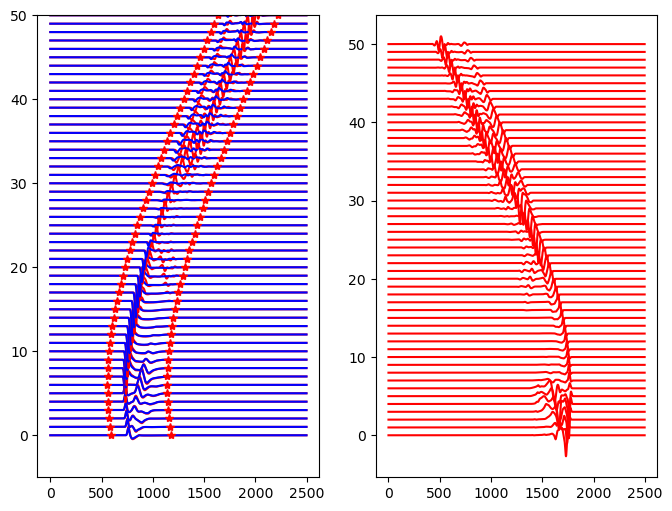

path exists


In [40]:
import os
pathobs=pathrun+'/wavefields_crustslab/'
pathsyn=pathrun+'/wavefields_slab_2025/'
event='event_1'
_,index=event.split('_')
from source import source
source=source([isx_array[int(index)],isz_array[int(index)]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)
adsource=adsource
adsource=generate_adj(pathobs,pathsyn,event,irx,irz,source,adsource)
wavefield='wavefields_slab_2025/'+event+'/adj/'
path2 = os.path.join(pathrun, wavefield)
if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
else: 
        print('path exists')
#vx, vz,seis= assemble_psv_adj_multirec(dx,dz,rho0,vp,vs,dt,nt,nx,nz,adsource,damp,path1,path2,10,10,-1e-11,1e-11)

In [47]:
adsource

__main__.adsource

<IPython.core.display.Javascript object>


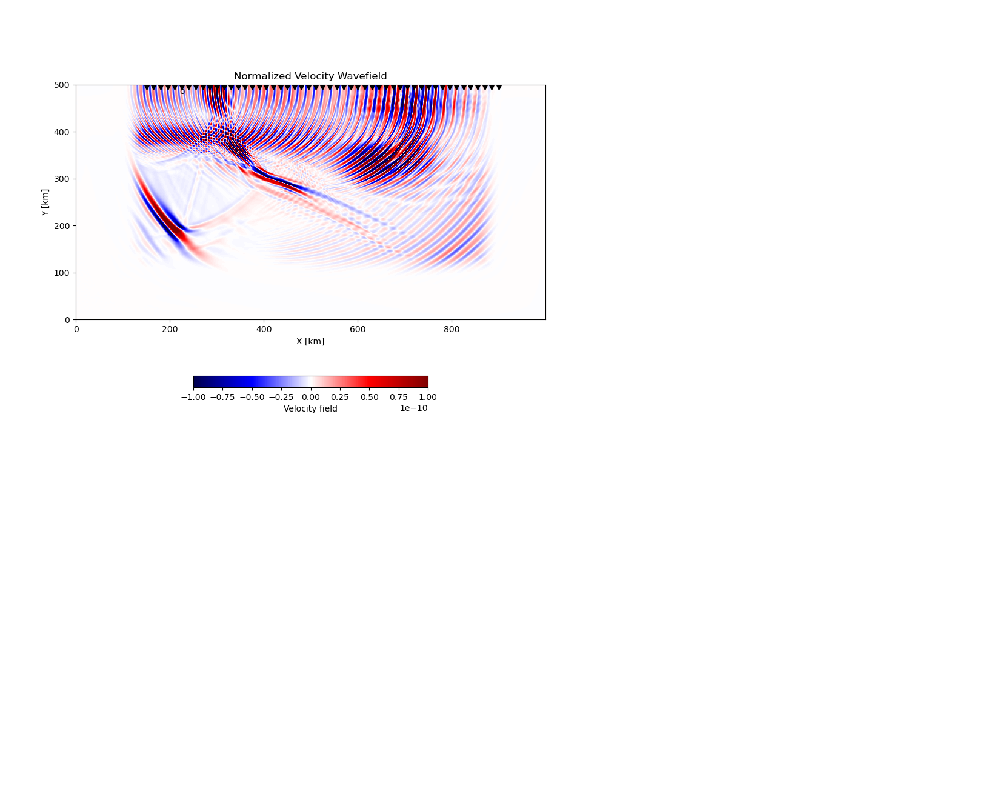

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1086
1087
1088
1089
1090
-1.7537562580039552e-10 1.6348196614672214e-10
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
-1.8427844951400963e-10 1.5996498472052823e-10
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
-1.0313495134389008e-10 8.198145127848623e-11
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
-1.6190539531751015e-10 1.5296190386289334e-10
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
-2.2175794949133375e-10 1.900345962043679e-10
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
-1.5053029977185877e-10 1.0589398420540746e-10
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
-1.296100564125638e-10 1.222587868059623e-10
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
-2.3553436212039323e-10 2.0376185587214395e-10
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
-1.8948083106976761e-10 1.478024504004102e-10
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
-9.303851834983874e-11 9.900763204677468e-11
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
-2.090223197

1950
-4.956585434853517e-10 4.768242715512293e-10
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
-4.841333810400076e-10 4.716439904588907e-10
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
-4.76729103229471e-10 4.5948739562975355e-10
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
-4.727396462374328e-10 4.653545375105491e-10
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
-4.754039889169773e-10 4.690601703993179e-10
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
-4.904216478009982e-10 4.743099218909777e-10
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
-4.930624631664672e-10 4.6513301215551924e-10
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
-4.805403679241202e-10 4.491391331445528e-10
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
-4.635929752250676e-10 4.511212243031965e-10
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
-4.5221980814325166e-10 4.49597804429687e-10
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-4.579391539225568e-10 4.4923315253883783e-1

In [41]:
%matplotlib notebook
vx, vz= assemble_psv_adj_multirec(dx,dz,rho0,vp,vs,dt,nt,nx,nz,adsource,damp,path2,path2,10,10,-1e-10,1e-10)

<IPython.core.display.Javascript object>


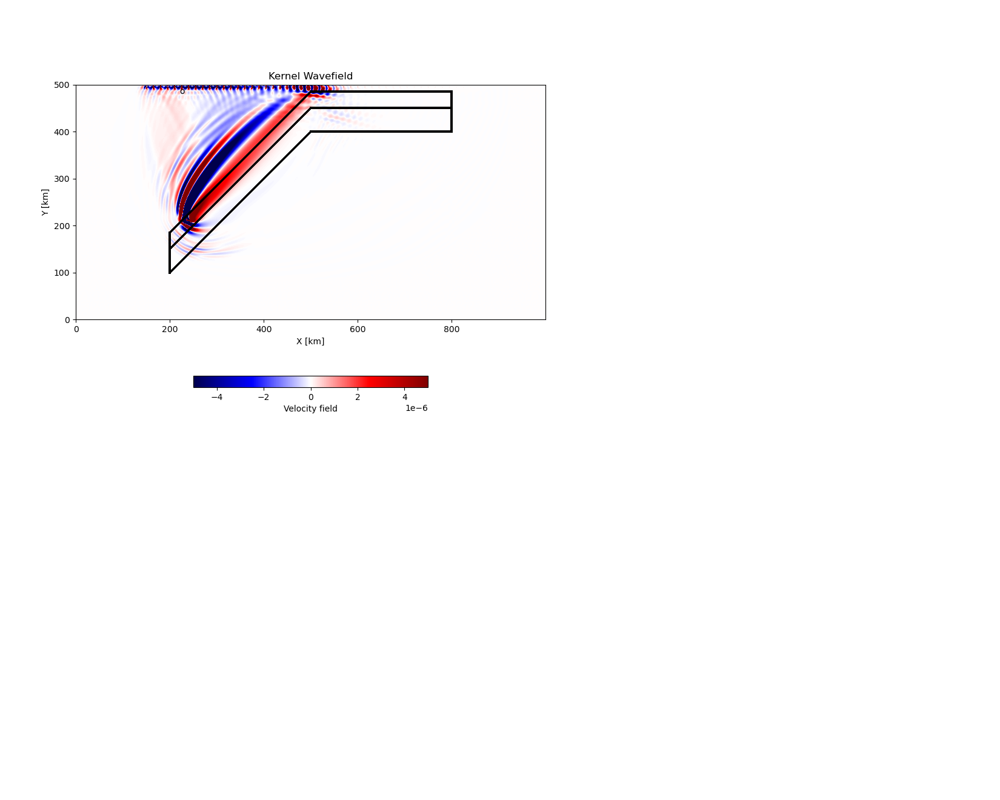

1.3801479753999856e-12
1.3953908161696179e-11
7.572811628021174e-10
1.3699252104723334e-08
2.4962228354446074e-06
1.0413704187181443e-05
1.8235791446024485e-05
2.5882995469484622e-05
3.3534729207942945e-05
100 is finished
4.119188240118435e-05
4.884946171683064e-05
5.650572784301063e-05
6.416181861216602e-05
7.181784840347248e-05
7.947389014459348e-05
8.712995520172133e-05
9.478603312722099e-05
0.00010244211255208888
0.00011009818991796166
200 is finished
0.00011775426810723334
0.00012541034360558372
0.00013306640889803567
0.00014072246636700797
0.00014837852362798844
0.00015603458324056326
0.00016369064266296673
0.00017134671073439919
0.00017900277606793593
0.00018665883255309217
300 is finished
0.00019431488811335847
0.00020197094273187585
0.0002096269982190162
0.0002172830536442819
0.0002249391093836384
0.00023259516511597194
0.00024025122086253865
0.0002479072766173526
0.00025556333260842674
0.0002632193887739166
400 is finished
0.00027087544490798053
0.0002785315010396703
0.000286

In [42]:
event='event_1'
import os
#path='/scratch/gpi/seis/yjgao/FD_wavefield_snapshots/'
wavefield='wavefields_slab_2025/'+event+'/'
path1 = os.path.join(pathrun, wavefield)
wavefield2='wavefields_slab_2025/'+event+'/'+'adj/'
path2 = os.path.join(pathrun, wavefield2)
#os.mkdir(path1)
#os.mkdir(path2)
kernel,kernel_mu,kernel_P4,kernel_S4=assumble_kernel(path1,path2,2500,vp,vs,-5e-6,5e-6)

In [46]:
pathrun

'/scratch/gpi/seis/yjgao/FD_wavefield_snapshots/'

event_0


<IPython.core.display.Javascript object>


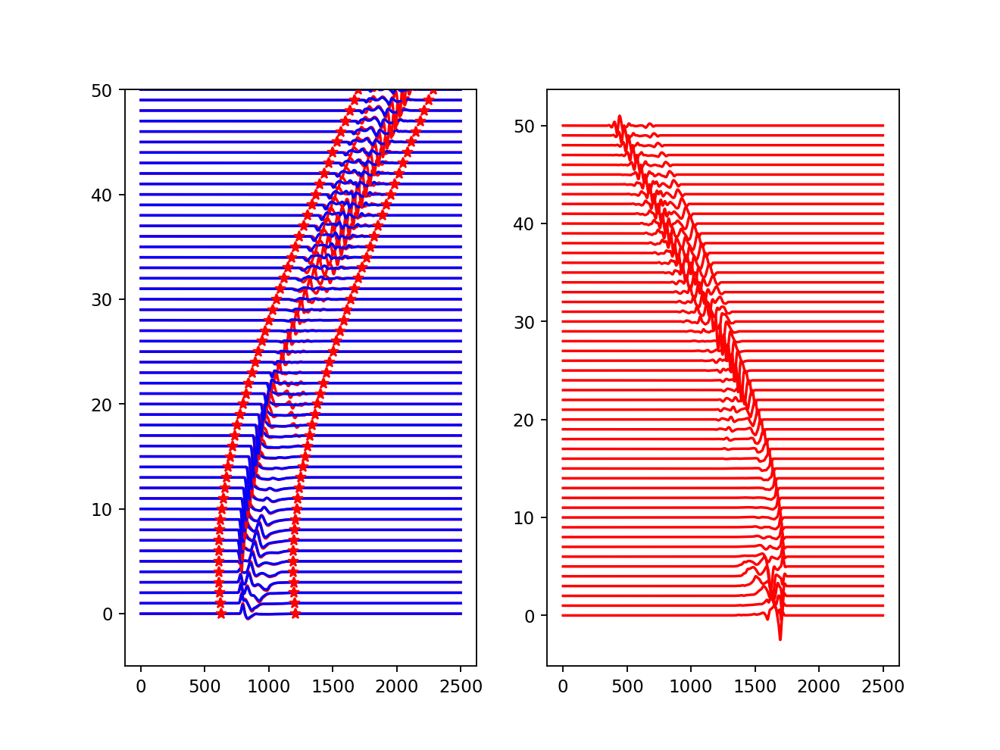

0.2156295721927472
0.21056504849855592
0.21027351529370056
0.2148463122163385
0.21606121352452204
0.22061853205315635
0.22922072790343836
0.2365400302282035
0.24423112374188488
0.2536081923414153
0.26447523793184335
0.2771632590454699
0.2920829159667968
0.3095561191351972
0.3303398481051173
0.35602500476963217
0.3914401328022135
0.44743096109922004
0.5437768671088361
0.6989303469299992
0.9016901607217462
1.0894194354236788
1.1752537464269641
1.142169465469364
1.0621306472802983
1.0292297059086855
1.0168697352469718
1.0077405038877572
0.9933355415801023
0.9671983660996422
0.9208407114069356
0.8633414548898921
0.8134996788042005
0.7742784715915203
0.7394661436730512
0.7159319597136713
0.7174602944518446
0.7422663698435519
0.7811827263687376
0.821127442942859
0.8520632731619631
0.8719695745611428
0.8682096512816354
0.8753088858910965
0.8553543379562781
0.8481121615768678
0.8628041845285696
0.8806572559512356
0.9047623964862399
0.933778121833444
0.9466814068358371
path exists


<IPython.core.display.Javascript object>


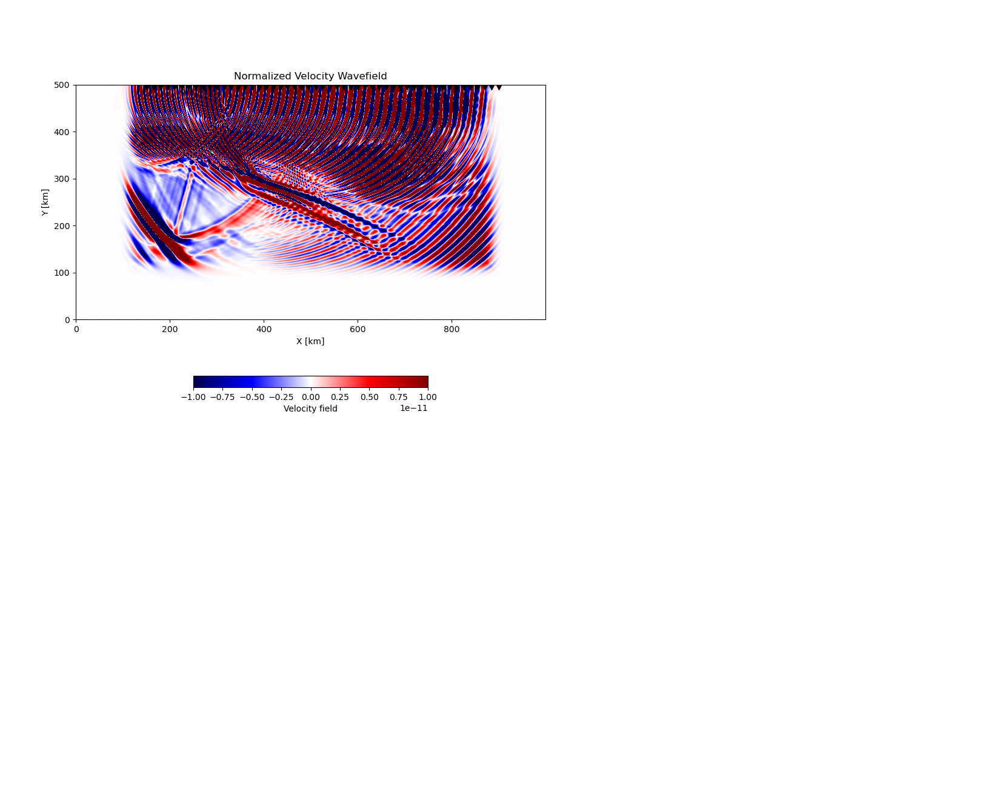

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
-9.107818496654543e-19 9.107831555994056e-19
221
2

-2.1591612766232435e-10 1.9330055397669694e-10
1061
1062
1063
1064
1065
1066
1067
1068
1069
1070
-1.7358246757055617e-10 1.3270957957068547e-10
1071
1072
1073
1074
1075
1076
1077
1078
1079
1080
-9.531264481636336e-11 8.965216606323294e-11
1081
1082
1083
1084
1085
1086
1087
1088
1089
1090
-2.2442991242227908e-10 2.040386538474771e-10
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
-2.0670396000802604e-10 1.6695011337801821e-10
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
-8.206972462609104e-11 1.0869448036408479e-10
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
-1.92656935901754e-10 1.914210542851627e-10
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
-2.1984826267869312e-10 2.0158090676358297e-10
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
-1.514919529314809e-10 1.2413389996316538e-10
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
-1.3013701028564728e-10 1.5175095642754802e-10
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
-2.2770094123579734e-10 2.156090383889

1919
1920
-4.968816893515814e-10 4.805841133198588e-10
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
-5.060013024424019e-10 4.944288283085064e-10
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
-4.978954095042419e-10 4.835591115255632e-10
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
-4.944278356773697e-10 4.621919063263086e-10
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
-4.850619149587121e-10 4.775870370089869e-10
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
-4.742108488292127e-10 4.845364362166201e-10
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
-4.871742805752625e-10 4.804478824905816e-10
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
-4.907719922156996e-10 4.767937349715315e-10
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
-4.877518976846109e-10 4.725916064114405e-10
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
-4.756581201436527e-10 4.57744593187579e-10
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
-4.652241045805321e-10 4.5390500694528506

<IPython.core.display.Javascript object>


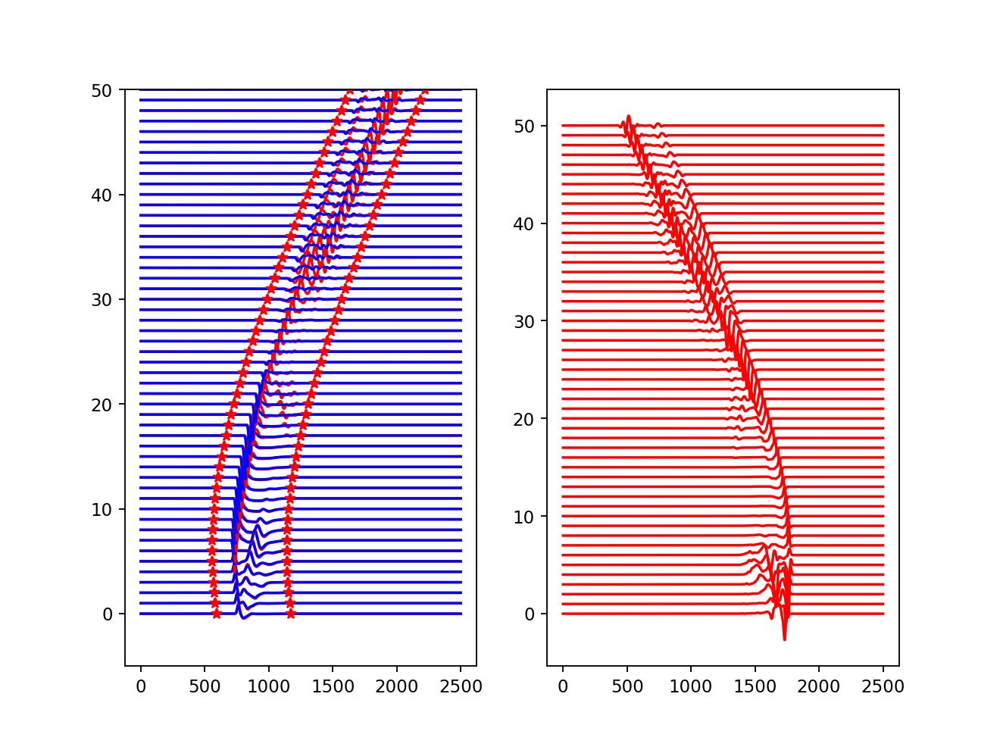

0.20997436506683653
0.20604261511991703
0.20891736609727238
0.20915308220160658
0.21194334046119528
0.21892221922436034
0.2233513569435288
0.22906903640815457
0.2359347916167585
0.24407528162517841
0.25369809609438976
0.2652515851857474
0.2789625489960366
0.29533927568610807
0.3148380569809337
0.33852946643055554
0.36869735277537447
0.4126586937004819
0.486252828035824
0.613761540861444
0.8062000452419442
1.0218047825638672
1.15925602656504
1.1568363848985006
1.0753104498050703
1.037599293699127
1.0226734167038953
1.011305719562209
0.9951587462180729
0.9670490083502401
0.9209971199120859
0.8648078231290574
0.8135776610114193
0.7761944048759231
0.7490138507990826
0.7327284040149536
0.7312721877384653
0.744340186795125
0.7677248928708917
0.7932386119012574
0.8106597491883195
0.8233759264071497
0.8412584500266065
0.8558837878485126
0.8782867296671328
0.8996326927292905
0.9201677730345901
0.9372127553269387
0.9671939708407392
1.012415124648858
1.0184106833570221
path exists


<IPython.core.display.Javascript object>


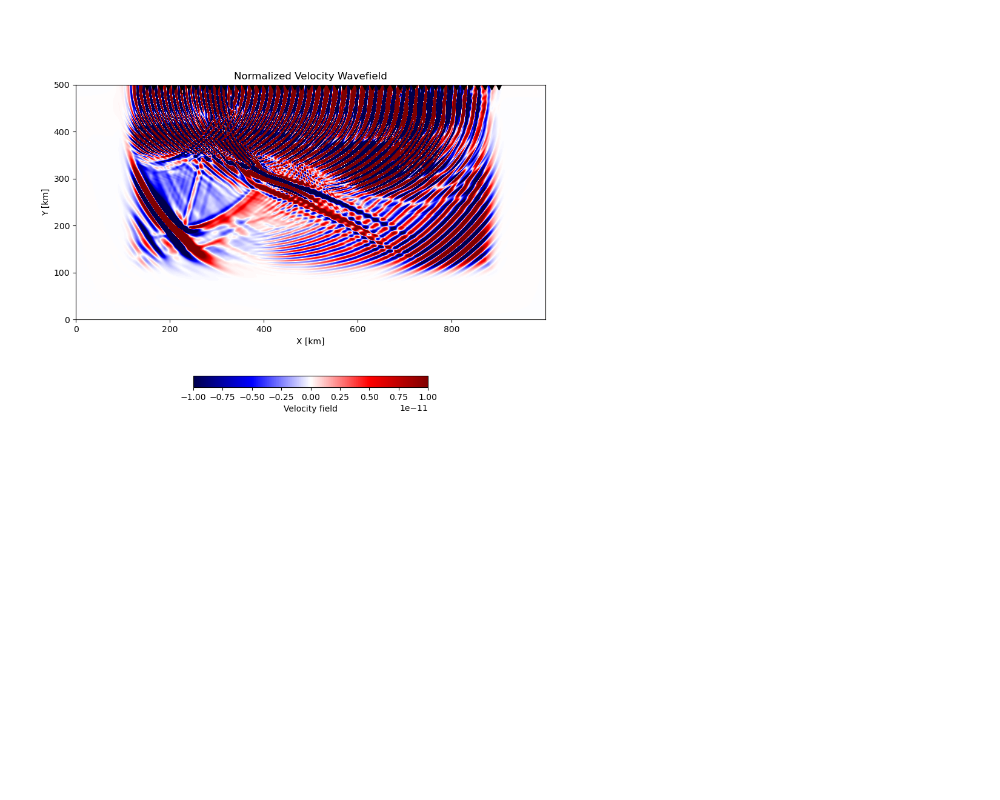

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1087
1088
1089
1090
-1.7537562580039552e-10 1.6348196614672214e-10
1091
1092
1093
1094
1095
1096
1097
1098
1099
1100
-1.8427844951400963e-10 1.5996498472052823e-10
1101
1102
1103
1104
1105
1106
1107
1108
1109
1110
-1.0313495134389008e-10 8.198145127848623e-11
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
-1.6190539531751015e-10 1.5296190386289334e-10
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
-2.2175794949133375e-10 1.900345962043679e-10
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
-1.5053029977185877e-10 1.0589398420540746e-10
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
-1.296100564125638e-10 1.222587868059623e-10
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
-2.3553436212039323e-10 2.0376185587214395e-10
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
-1.8948083106976761e-10 1.478024504004102e-10
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
-9.303851834983874e-11 9.900763204677468e-11
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
-2.09022319726681

1949
1950
-4.956585434853517e-10 4.768242715512293e-10
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
-4.841333810400076e-10 4.716439904588907e-10
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
-4.76729103229471e-10 4.5948739562975355e-10
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
-4.727396462374328e-10 4.653545375105491e-10
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
-4.754039889169773e-10 4.690601703993179e-10
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
-4.904216478009982e-10 4.743099218909777e-10
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
-4.930624631664672e-10 4.6513301215551924e-10
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
-4.805403679241202e-10 4.491391331445528e-10
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
-4.635929752250676e-10 4.511212243031965e-10
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
-4.5221980814325166e-10 4.49597804429687e-10
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-4.579391539225568e-10 4.49233152538837

<IPython.core.display.Javascript object>


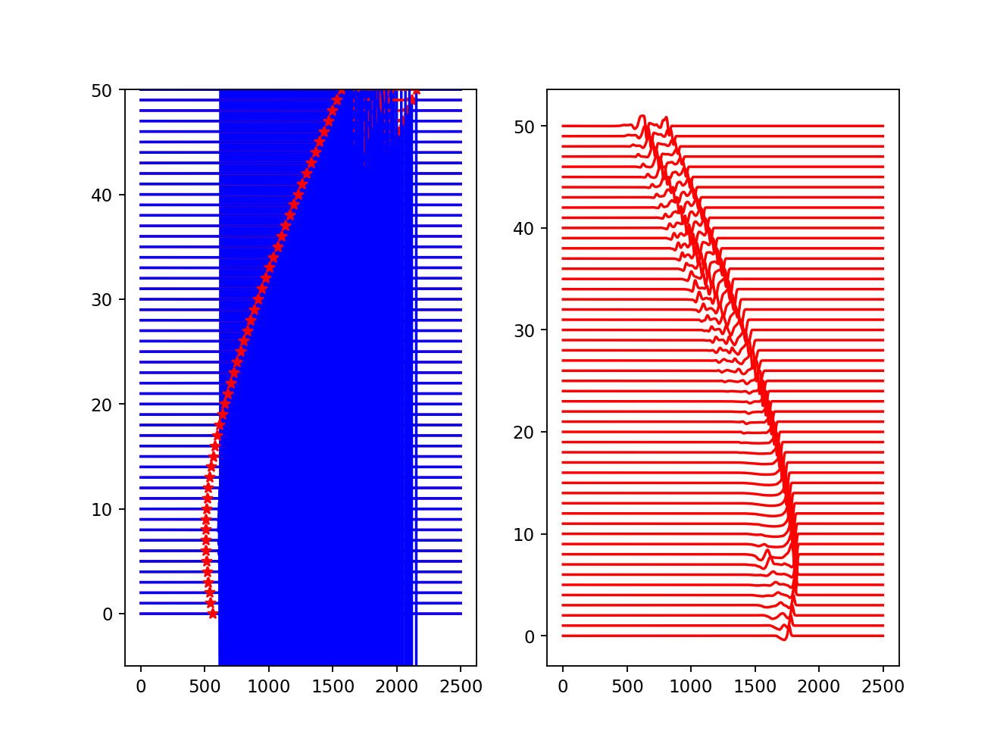

848405929.5378227
846804370.7501318
845545425.970087
850230746.3575468
848994238.2219714
848579890.7901317
848431948.6717757
847962931.6956425
847276140.4229411
846307121.0276906
845317945.9285507
844189456.0150496
843338007.4742699
842872627.2739851
843124702.1264067
845213769.609132
850601953.4003544
861046500.5747609
878934306.283998
902930346.0119293
920334387.0921936
897231323.566969
782378092.1674396
562425628.5973744
328348286.36082095
224358852.70542282
201513463.4487348
220918307.61118382
270721462.6681467
343896068.4620078
423613631.9441271
492426836.26562124
542315464.1766423
576640665.8143536
599372514.0121204
612561866.3419515
617463276.4999075
611660621.3806406
597198762.9013431
579268962.0887445
564870311.7459455
552762851.2001446
557008633.4475788
565365378.5042089
516917811.3557591
454128298.71031433
396914856.827712
376288812.64739424
353306280.7308523
286506257.5182583
261691056.77843505
path build


<IPython.core.display.Javascript object>


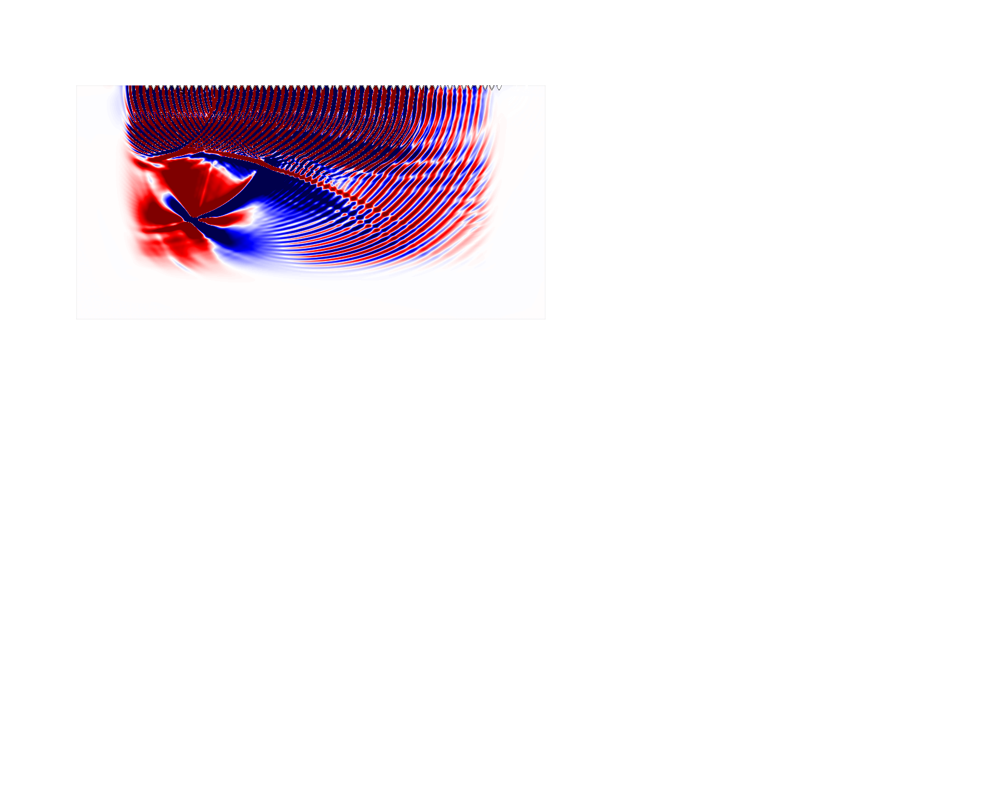

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

-3.98047728591347e-11 5.389018213166203e-11
1111
1112
1113
1114
1115
1116
1117
1118
1119
1120
-5.394272944867012e-11 4.4878318036713626e-11
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130
-7.354085573697287e-11 8.40953190687044e-11
1131
1132
1133
1134
1135
1136
1137
1138
1139
1140
-4.9170314511727334e-11 6.490575546678147e-11
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
-5.3206141322131717e-11 4.440073348222357e-11
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
-7.636155633049307e-11 8.734437875701703e-11
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
-5.655785127370822e-11 7.485031750385166e-11
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
-5.4971327987017804e-11 4.636093183289022e-11
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
-7.849888478617696e-11 9.056230114544556e-11
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
-6.212728340265522e-11 8.326217024877936e-11
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
-5.82791859674387e-11 5.275098640508085e-11
1211

1970
-7.980413992264412e-10 1.1712057798340286e-09
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
-8.284132813170659e-10 1.1422083547362422e-09
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
-8.032642216461691e-10 1.0144268747618485e-09
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
-8.108738888382737e-10 1.0273662718939171e-09
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
-7.970685524867108e-10 1.0650636981202192e-09
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
-8.085694813642461e-10 1.08207178803524e-09
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
-7.993357713321071e-10 1.0069221846354102e-09
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
-8.109742680561459e-10 9.654987495443211e-10
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-8.084244433310051e-10 9.819645220421442e-10
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
-7.877013060794903e-10 1.003440081270226e-09
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
-7.742048592846587e-10 9.604758234341726

<IPython.core.display.Javascript object>


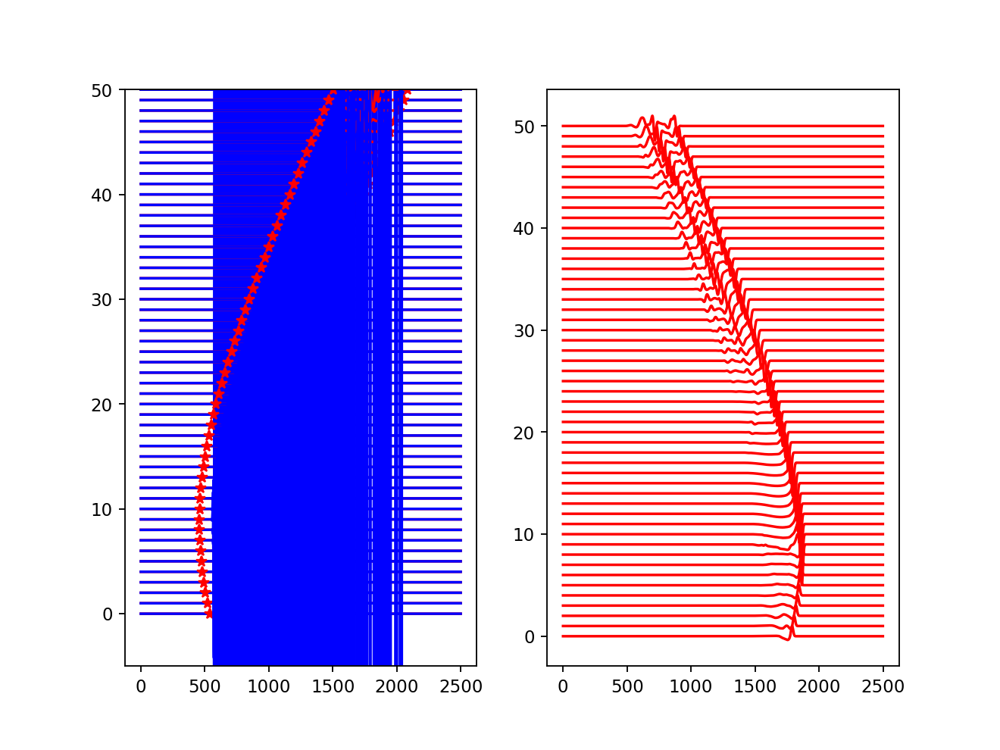

844778640.992452
844426621.3658377
846518480.9764498
848588189.2800308
848149942.3549049
848706615.1628546
848803723.5113026
848661330.4384696
848243722.2711176
847501853.7526612
846527268.2943336
845410301.8987037
844235867.5924363
843097012.682559
842582547.9813827
843088614.9021736
845474501.8234857
851780598.8638101
864524759.4922693
884725023.143295
906576393.2179165
904245162.9131253
820850363.1140989
615236265.8190476
371880635.10233974
254997224.62107968
225270341.5388783
244506359.78886876
297017589.26968145
371836450.73366916
450483211.8496414
516346621.3745639
564351135.2283072
596715771.2129757
618800284.4305142
632532255.4526498
636648291.0039424
629888728.3876349
615532314.5156094
594068769.389868
572991093.9908226
547798880.1915562
533505284.2009402
523199448.8014334
466324994.7528024
401023646.6853642
356980549.3298671
342094649.3741922
315790260.4142486
258232956.79418355
235918590.2659549
path build


<IPython.core.display.Javascript object>


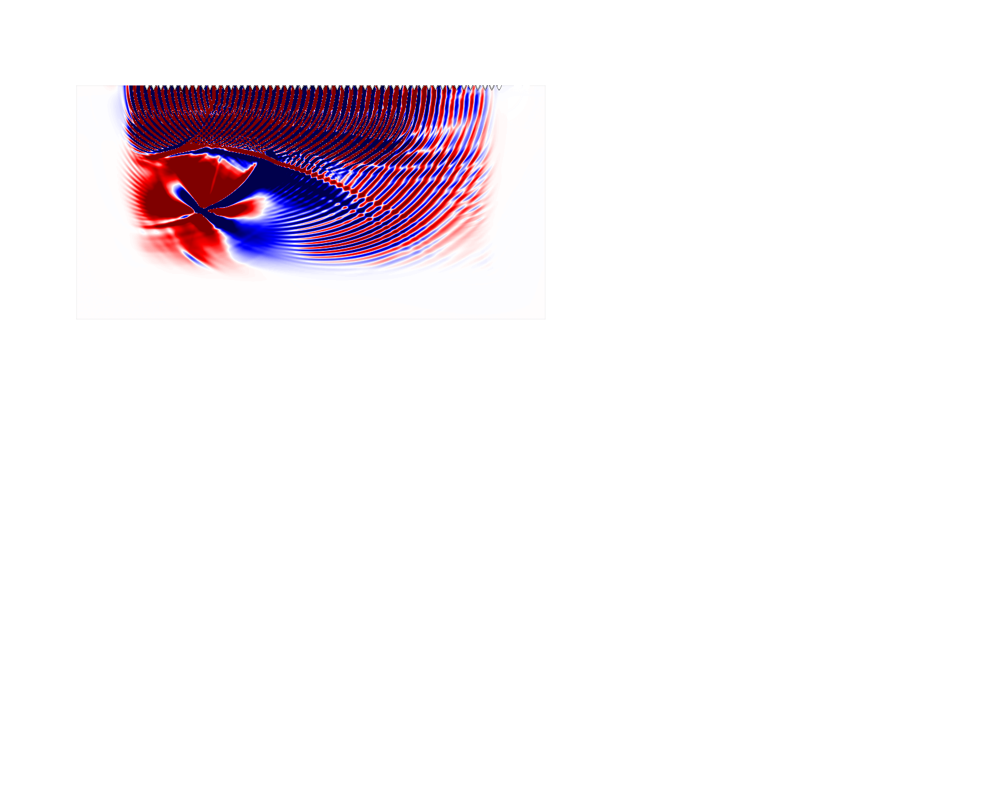

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1137
1138
1139
1140
-4.0528157340079325e-11 5.383237728666702e-11
1141
1142
1143
1144
1145
1146
1147
1148
1149
1150
-3.380296005472397e-11 3.653200790919602e-11
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160
-7.153824690377955e-11 7.19964114225102e-11
1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
-5.1735205985245055e-11 6.651961795271953e-11
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
-3.320582875048724e-11 3.279710237068145e-11
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
-7.367954038000687e-11 7.220994402826827e-11
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
-6.254213259320573e-11 7.786681571501959e-11
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
-3.4830562229636265e-11 3.4602820169436854e-11
1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
-7.513971010992578e-11 7.317008167737226e-11
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
-7.097030799027043e-11 8.772330237917201e-11
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
-3.8903681057468833e-11 4.6

1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
-8.69009363481551e-10 1.1600809553104376e-09
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
-8.219904969418887e-10 1.229973064208486e-09
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
-8.633469388702453e-10 1.2412454002862285e-09
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
-8.656342597705919e-10 1.1696854359234764e-09
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
-8.49487830896682e-10 1.0398567412520064e-09
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-8.457189580574698e-10 1.0945535672193816e-09
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
-8.432495083830794e-10 1.1481367564388026e-09
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
-8.530692760661314e-10 1.1239967131130933e-09
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
-8.422099548434067e-10 1.0347632275955855e-09
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
-8.407663815424355e-10 1.00453610476317e-09
2091
2092
2093
2094
2095
2096
2097
2098
2099


<IPython.core.display.Javascript object>


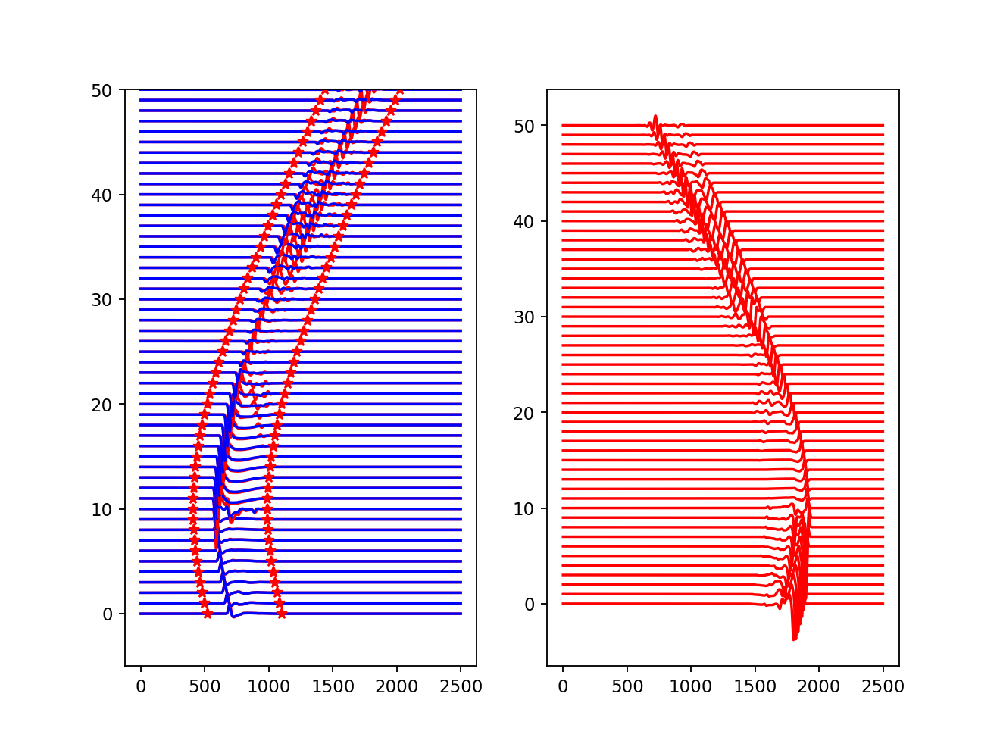

0.20318503945848262
0.20086088844935487
0.20021585719741802
0.20172262878993266
0.20271821096133835
0.20444792728797812
0.20657103809452865
0.20946181000743305
0.2131082969912989
0.21771023536712672
0.22366695419888363
0.23114868974319994
0.24066696336027452
0.2525678226900429
0.2674612483586698
0.2862168266499853
0.3096496730366522
0.33941357223513824
0.37883328931645444
0.43843674980186387
0.543884849146811
0.730194106480612
0.977678574208426
1.1500872186303819
1.1333128262898595
1.0753862647677286
1.0460906241594061
1.0283886071287658
1.0017249213842863
0.9592950276654467
0.903521465601046
0.8510022165459258
0.813050877567646
0.79307573499848
0.7878607303324885
0.7898883469163167
0.7951619322922284
0.8058034938935811
0.8216453034625492
0.8406528019066337
0.8647277240373156
0.8850043695800545
0.9094522848287323
0.9302184533694141
0.9354517312434876
0.932678299183209
0.9421661480971781
0.936445011544304
0.9481273207524865
0.9743330220763889
0.9781973886783631
path build


<IPython.core.display.Javascript object>


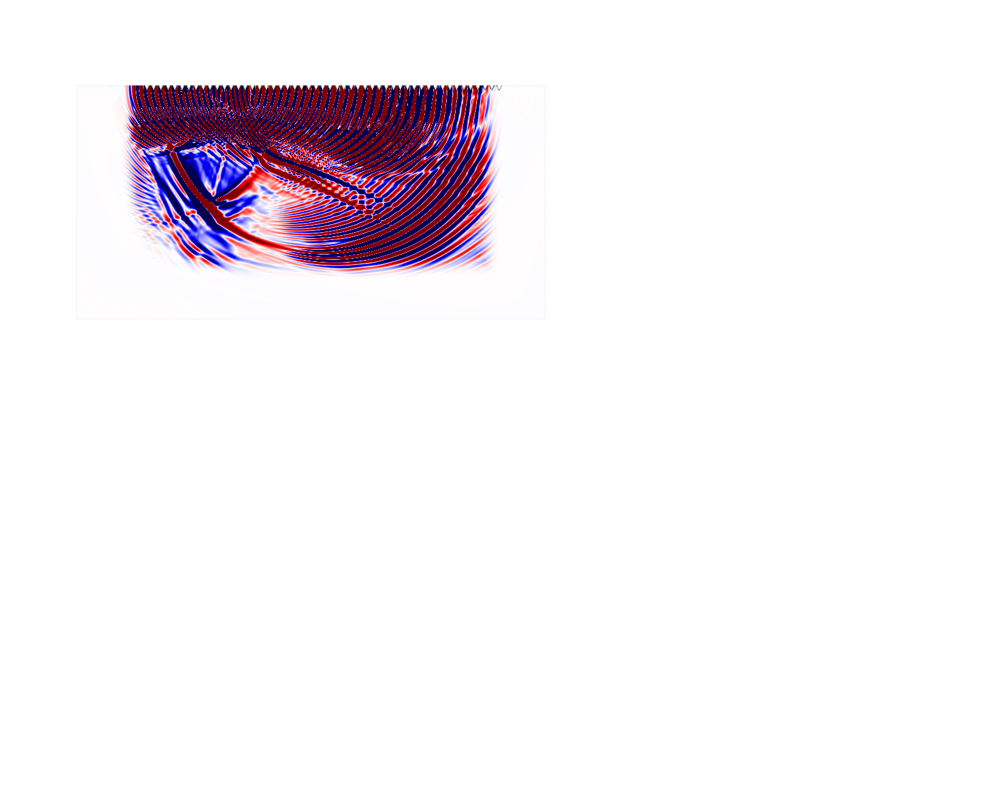

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1161
1162
1163
1164
1165
1166
1167
1168
1169
1170
-7.94372161663407e-11 6.03903586216645e-11
1171
1172
1173
1174
1175
1176
1177
1178
1179
1180
-5.689986307875055e-11 9.068641024549187e-11
1181
1182
1183
1184
1185
1186
1187
1188
1189
1190
-1.234531326812928e-10 1.2122421504805682e-10
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
-1.1160332602501708e-10 8.961055458774561e-11
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
-5.6222879741135775e-11 8.115596619864221e-11
1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
-1.085979203960542e-10 1.1875889857673026e-10
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
-1.3895802821803235e-10 1.194089551655128e-10
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
-8.501200955519076e-11 1.0015118180934846e-10
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-8.411464470589943e-11 1.0478022538043221e-10
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-1.4735068961068332e-10 1.312969529494011e-10
1261
1262
1263
1264
1265
1266
1267
1268
1269

2020
-5.774349933595557e-10 4.742303793226318e-10
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
-5.881227845916947e-10 4.6030883381556403e-10
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
-5.903152146983069e-10 4.4046480191385365e-10
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-5.889768251706709e-10 4.2913865142380796e-10
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
-5.87396338473505e-10 4.1418840564874646e-10
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
-5.803191099393889e-10 4.0746614400128377e-10
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
-5.721858523839442e-10 4.0084789458059616e-10
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
-5.579848472680653e-10 4.0143528255269175e-10
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
-5.486815863740806e-10 4.042510101745385e-10
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-5.355925210910663e-10 3.989423871329684e-10
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-5.310917033061566e-10 3.96945282228767

<IPython.core.display.Javascript object>


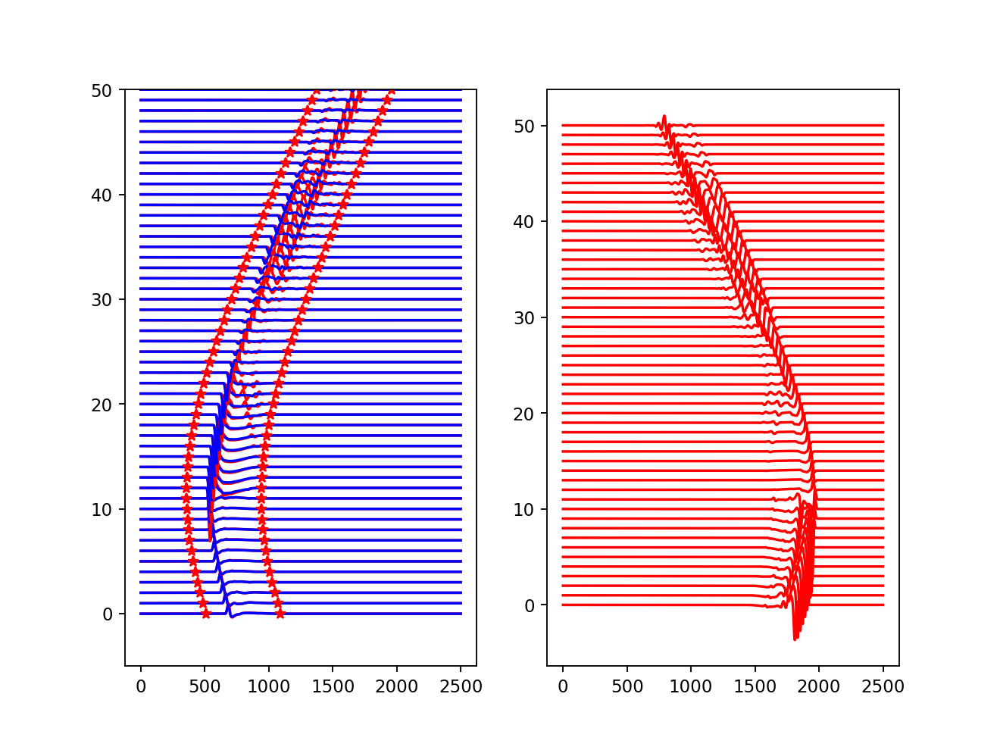

0.20599271251152187
0.20186617529604844
0.20057210156872612
0.20048801757606147
0.20062486547056613
0.20143486939493818
0.2028243886341699
0.20466806634205004
0.20738154626558927
0.21076195176523663
0.21533270429488127
0.2212914282412312
0.22900391132753986
0.23910432318483732
0.25191976375798975
0.2685057842613057
0.28965184185602816
0.3169332196760623
0.35254767249907876
0.402336010434942
0.4838200003810174
0.6342210411164757
0.8750720321849424
1.1054832086974211
1.1477612632349756
1.0946482731224707
1.0561470146330947
1.0335042651262625
1.0073094018142845
0.9611767476598088
0.8996000923390829
0.8450364853644992
0.8082513814316216
0.7923546177570204
0.7931322670617031
0.8013612021237085
0.8099980344003965
0.8186305233532817
0.8306937223282048
0.8431891217050519
0.8595968936905467
0.871976503899533
0.8938524682415775
0.9180966818431211
0.9262248506270415
0.9262534283273941
0.937125847464642
0.9345027057246014
0.9479653795468271
0.9691610742128768
0.974367427448244
path build


<IPython.core.display.Javascript object>


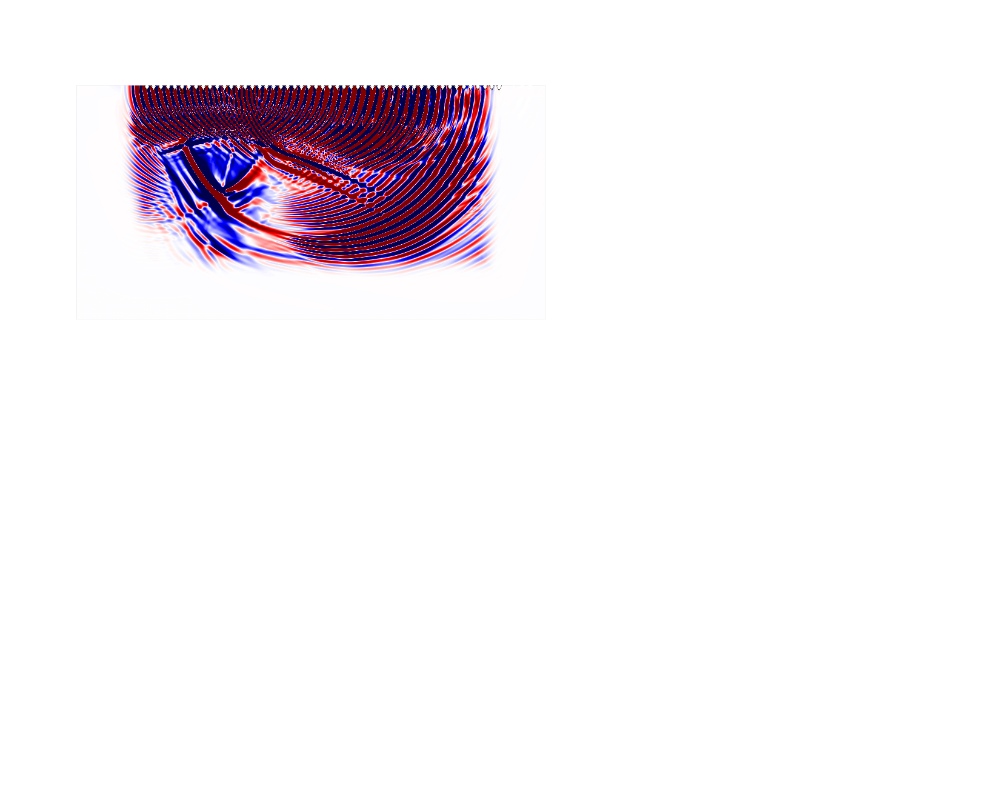

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

-7.283828731012885e-11 1.0910320700457985e-10
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
-8.451918641408462e-11 7.764897190382631e-11
1201
1202
1203
1204
1205
1206
1207
1208
1209
1210
-6.644884711152264e-11 6.122420276299038e-11
1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
-7.483243809246364e-11 1.0913536197143215e-10
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
-9.112718685799263e-11 8.513103053201914e-11
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
-9.032825453811196e-11 4.927711712553461e-11
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-7.186066323471233e-11 9.8448588665897e-11
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-9.769085351300544e-11 1.0299988983882458e-10
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.0109330838884836e-10 9.012317676658814e-11
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-6.874683668249511e-11 8.349101146808006e-11
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-9.218545883905746e-11 1.0504649191705824e-10
12

2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
-6.108983401680953e-10 4.7168424548435e-10
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
-6.276107265079674e-10 4.418580214822205e-10
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
-6.232317707868612e-10 4.5751896086051326e-10
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
-6.103505372005435e-10 4.4882495659447015e-10
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
-5.970430620666889e-10 4.4224298343588384e-10
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
-6.086388243040976e-10 4.1843276295758693e-10
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-6.122648525794976e-10 4.1617451937047264e-10
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-6.080385523178092e-10 4.19500470059023e-10
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-5.998643240214415e-10 4.311338599448051e-10
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-5.92810736312157e-10 3.7737309581581173e-10
2141
2142
2143
2144
2145
2146
2147
2148
2149
215

<IPython.core.display.Javascript object>


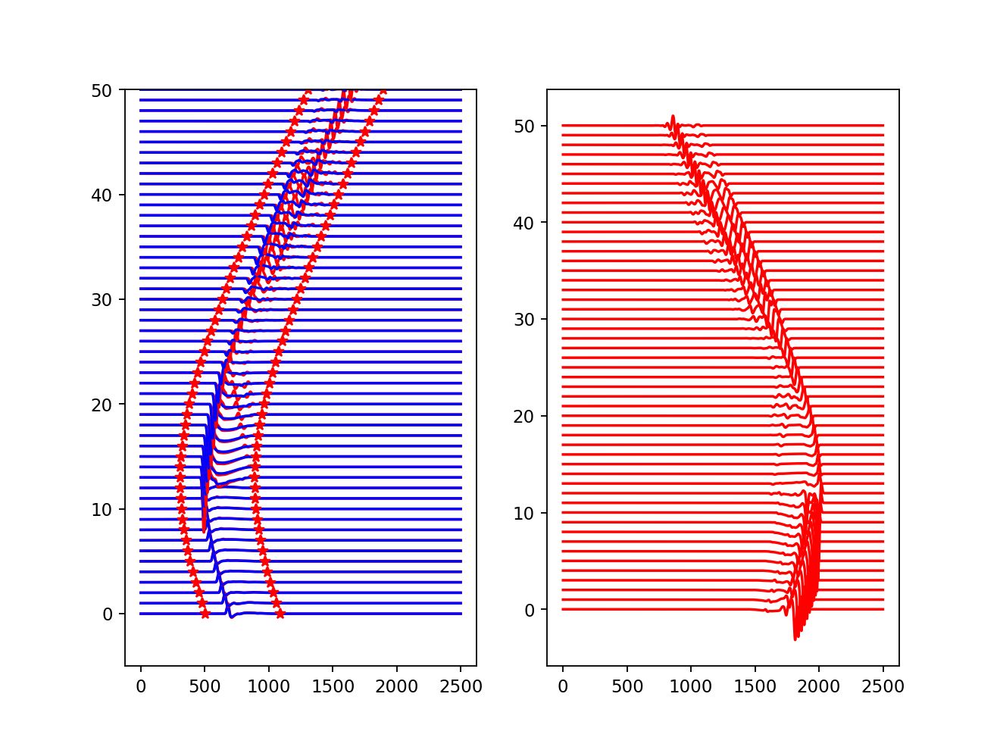

0.2141427987873318
0.20733534531642003
0.20410974472567686
0.20201733895203464
0.20072671071352752
0.20024708262365942
0.2005128269976503
0.20134751130616485
0.2028784097666432
0.20515778948694408
0.20836473768917113
0.2127409527784482
0.21859303533110502
0.2265607140730856
0.23709854180763373
0.2511575591589087
0.26962231761858374
0.29403272316035756
0.3263347156382356
0.3704135871059331
0.4363950286706708
0.5528111018167922
0.7652980750738139
1.032509265119501
1.144100035181863
1.1118869899434713
1.0699844485283254
1.0384361781514184
1.009921823806976
0.9651081136130194
0.8997894659264534
0.8393813957885663
0.8006982017722283
0.7880702634382728
0.7937114546229989
0.8070603454937147
0.8216411258754553
0.8332618606501028
0.8462589105783007
0.8581368652698523
0.8677449151307602
0.8717228430349451
0.8885605371497215
0.9087815209498711
0.9177477608404768
0.9185006352738534
0.9279181851837847
0.9251459561124542
0.9379300806547904
0.9553061989937762
0.9622687278286743
path build


<IPython.core.display.Javascript object>


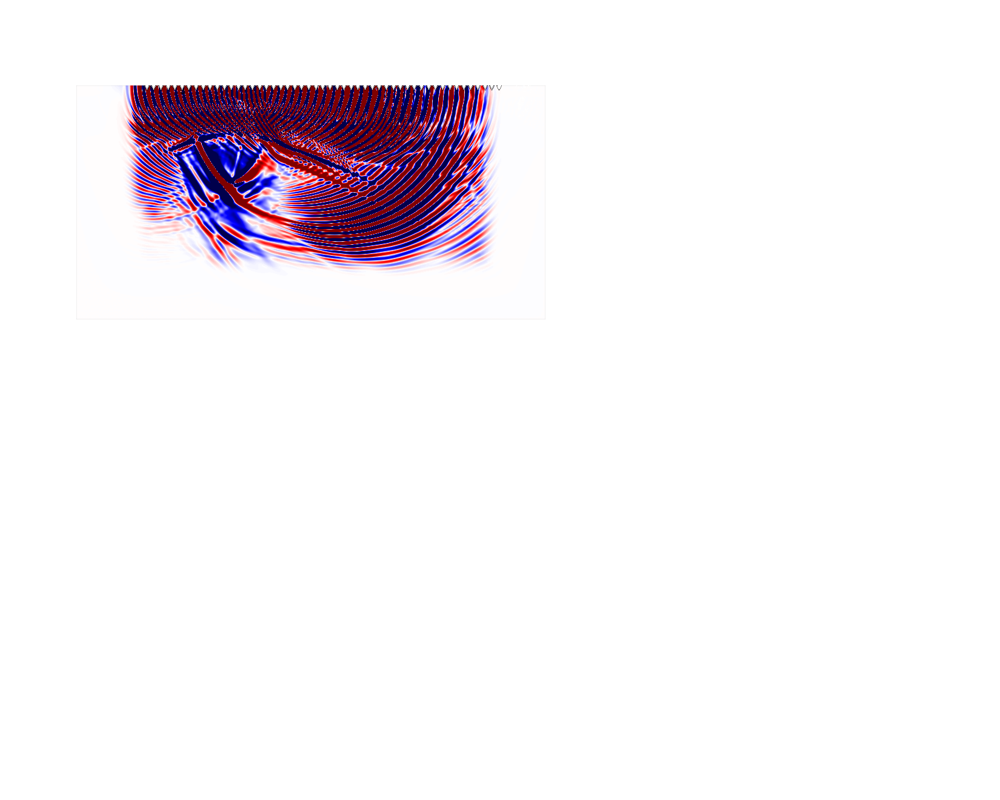

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1211
1212
1213
1214
1215
1216
1217
1218
1219
1220
-9.589930740333202e-11 1.2062753357050194e-10
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
-5.7437550363411196e-11 6.921517839993538e-11
1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
-1.045861247587312e-10 9.724394215242043e-11
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-7.02422619060431e-11 8.391710799296103e-11
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-5.932007491704982e-11 8.618350746352213e-11
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.0517327432335333e-10 8.784945642965438e-11
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-6.912700775976084e-11 6.765395686804092e-11
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-6.862132331743882e-11 9.250598535823383e-11
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-1.0109720611030779e-10 7.897015060988126e-11
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-8.752905072120766e-11 7.149539175801762e-11
1311
1312
1313
1314
1315
1316
1317
1318
1319
13

2070
-8.932124893756794e-10 6.427019758680743e-10
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
-8.057897047563091e-10 5.96604145456134e-10
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
-6.66011555717531e-10 5.416830903648641e-10
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
-6.515979079164589e-10 5.029605192762163e-10
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-6.504905661384237e-10 4.946918371613294e-10
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-6.446638734457285e-10 5.113989991155794e-10
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-6.412090619625912e-10 4.77299277017399e-10
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-6.259004267916322e-10 4.757180600167063e-10
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-6.108855408288758e-10 4.991638460970673e-10
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-6.263233761281123e-10 5.1168011122969e-10
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-6.374280526305735e-10 4.801248200090938e-10
2171


<IPython.core.display.Javascript object>


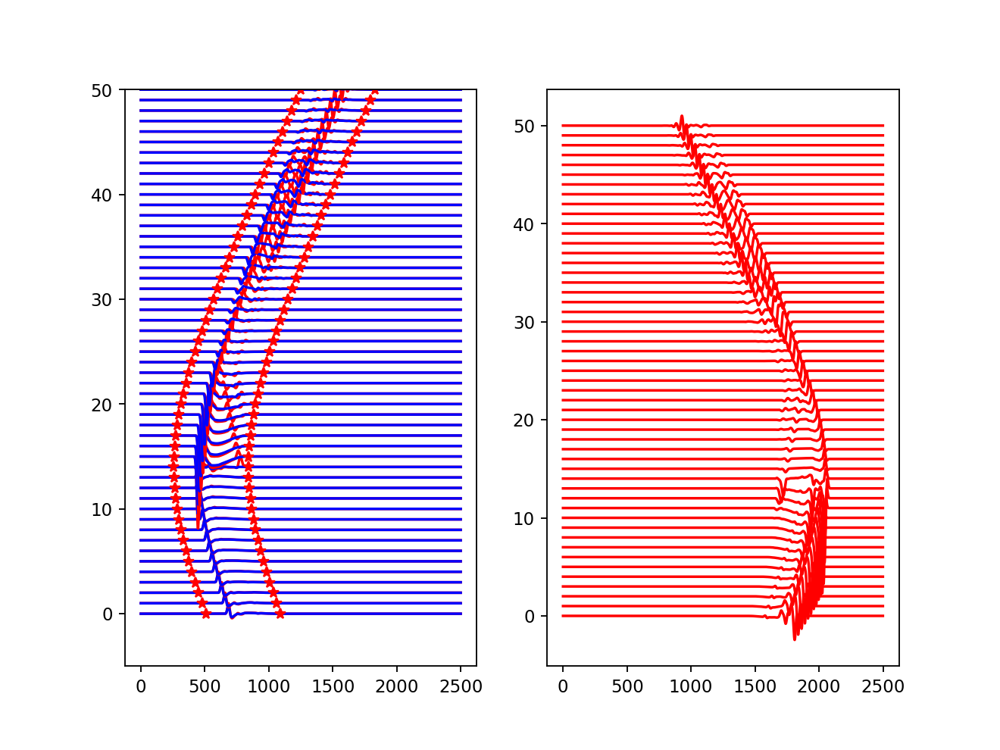

0.23064783480192133
0.22020348064483142
0.2137594868962707
0.20881185809255828
0.2050324829938441
0.2023954832492803
0.20077219615919506
0.20010535360425458
0.20034236137315817
0.20128871117548996
0.20318816285159302
0.20586833235192945
0.20989978696067063
0.21559104640065357
0.22365647920594184
0.23471959575503867
0.2500280908432815
0.2709381950324961
0.2996685845799929
0.33908898759248474
0.39576817883087667
0.4876732175176494
0.6604924991483564
0.9336296878197353
1.1140043736856968
1.11541003259123
1.083058928469642
1.0440110662356157
1.0093420558901711
0.9667743117056589
0.9042829454887018
0.836150068434789
0.7918302441307745
0.7775598037981336
0.7848494111619546
0.8028833057121648
0.8230934000359503
0.842714011599384
0.8613418474512613
0.8795408143858339
0.8924326240768663
0.8957342056023254
0.9069389150233436
0.9168923702918084
0.9230646110326615
0.9220466670601408
0.9283085309425366
0.924957109146772
0.9279733419787892
0.9428643146346115
0.9514947321621392
path build


<IPython.core.display.Javascript object>


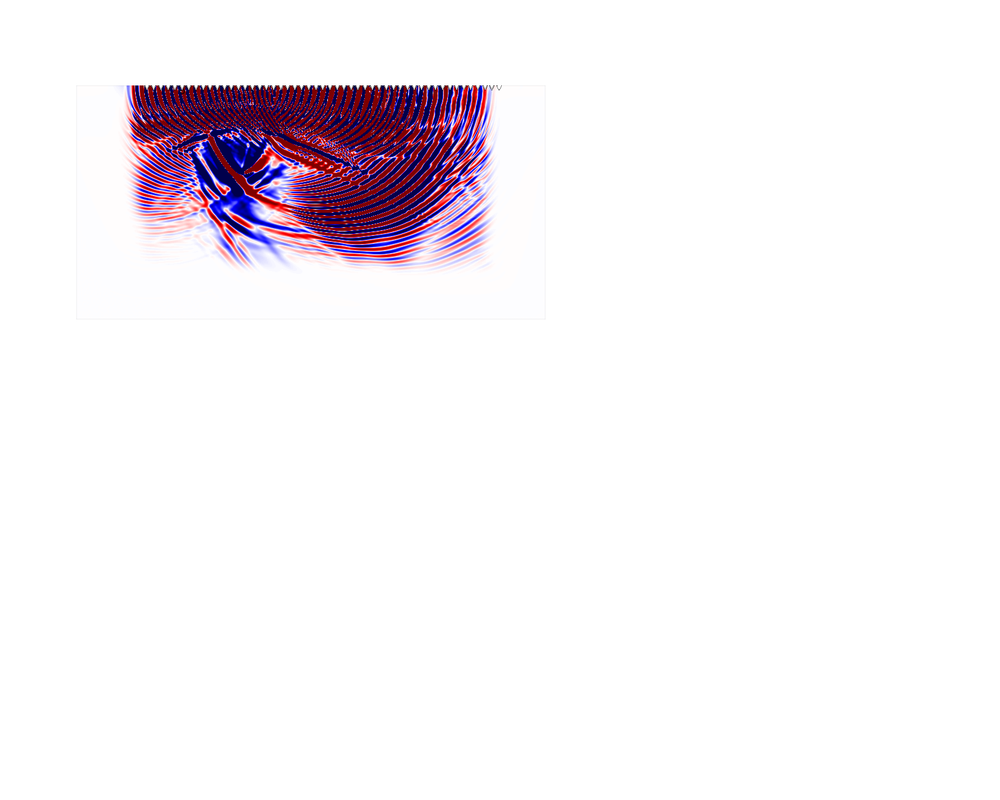

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1231
1232
1233
1234
1235
1236
1237
1238
1239
1240
-1.4622298732616738e-10 8.798836796975449e-11
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-6.791051740879414e-11 8.1782523296689e-11
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-6.531423939979895e-11 8.804665006158249e-11
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.3871192611532895e-10 9.140305542368095e-11
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-7.974930883933153e-11 8.326292489632127e-11
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-8.240880602981143e-11 9.237962232978627e-11
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-9.658455685676925e-11 6.804985195575625e-11
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-1.2642911323610022e-10 8.707674042900195e-11
1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-7.26732662749499e-11 9.132348133600789e-11
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-6.669625331943827e-11 6.455554439961334e-11
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340


2090
-1.2038094799407498e-09 1.175607453051939e-09
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
-9.360056610926564e-10 1.118028486272276e-09
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-9.195358959916072e-10 7.363881004786027e-10
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-1.0173524030745614e-09 6.656787699105886e-10
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-7.116244754072692e-10 6.308078178977102e-10
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-7.086344006354695e-10 6.111272431672783e-10
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-7.0308970460723e-10 6.113476833849714e-10
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-6.914358256248631e-10 6.197048775800656e-10
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-6.733479703885872e-10 6.145406408629972e-10
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-6.758129259120991e-10 6.239077281894295e-10
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-6.73017064111984e-10 5.915527550581755e-10
2

<IPython.core.display.Javascript object>


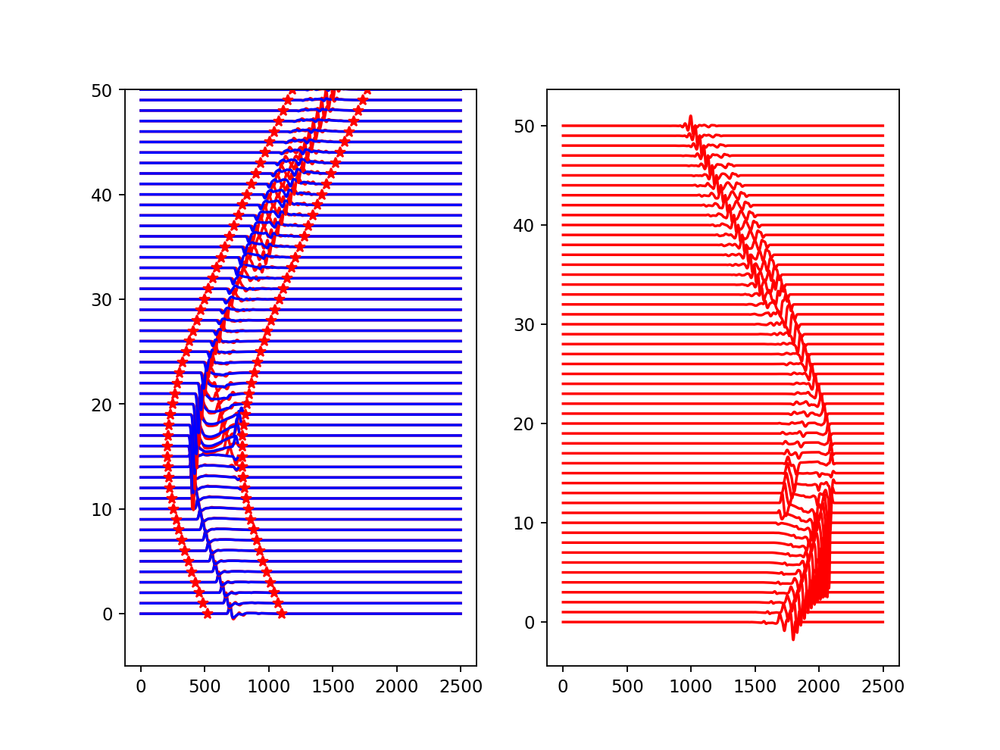

0.25850972844153
0.24390124258040569
0.23350124156509094
0.2246050256230056
0.21703645299368288
0.2108804867540781
0.2061817348375825
0.20287096702393595
0.20086563013297054
0.20003203453210602
0.2002119932487947
0.20140572784103422
0.2035067287089029
0.2070002295194689
0.21222514744122978
0.2201023072952704
0.23173740297927606
0.2485126037982867
0.27263167149572376
0.3071246069590195
0.3570431902330654
0.43372643211862566
0.5702349105520818
0.8181509713856013
1.0522521826653715
1.0971767343520693
1.0848505447199908
1.0489322495553113
1.003996932697079
0.9600671839810647
0.9050461664407128
0.8388367505514417
0.7828590041340994
0.7591834831016977
0.7632187189944094
0.7834618406977464
0.8093991478279843
0.837602989222341
0.8665234541057991
0.8955021567838167
0.9204379227258743
0.9369031807596927
0.9533839437651281
0.9603962867068444
0.9656436869122932
0.9631442998154232
0.9608973276541315
0.9563706745928685
0.9421787175633037
0.9545839397255155
0.9634188273025788
path build


<IPython.core.display.Javascript object>


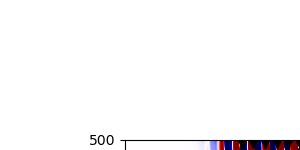

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.4107604871119057e-10 1.0146517295634281e-10
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-9.054848415112801e-11 8.889467831343384e-11
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-9.018197724823264e-11 7.03848771407801e-11
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-8.753085511557986e-11 7.166348149677648e-11
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-1.5440285631505378e-10 8.567072053357105e-11
1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-6.558277915467957e-11 6.824652554892904e-11
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-7.278858961795847e-11 7.998604788761394e-11
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-1.6600471438742089e-10 1.0246763836232343e-10
1341
1342
1343
1344
1345
1346
1347
1348
1349
1350
-8.759865107580446e-11 1.0518528248239097e-10
1351
1352
1353
1354
1355
1356
1357
1358
1359
1360
-8.742098606822508e-11 7.922748580166011e-11
1361
1362
1363
1364
1365
1366
1367
1368
1369


2120
-1.252315344415334e-09 1.6819883468889795e-09
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-1.1255021034467679e-09 1.2616357021706149e-09
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-1.335224784903293e-09 1.189196284736332e-09
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-8.655008842053894e-10 1.2719197431591146e-09
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-9.342268625887118e-10 7.496723379371748e-10
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-1.1218822603361482e-09 7.383393093136979e-10
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-7.793644350596632e-10 7.509196418002967e-10
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-7.260282170688012e-10 7.088996446618924e-10
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-7.580050891386157e-10 6.990885908946857e-10
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
-7.559973745489091e-10 6.537452746384529e-10
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
-7.631702519228729e-10 6.950713856113221

<IPython.core.display.Javascript object>


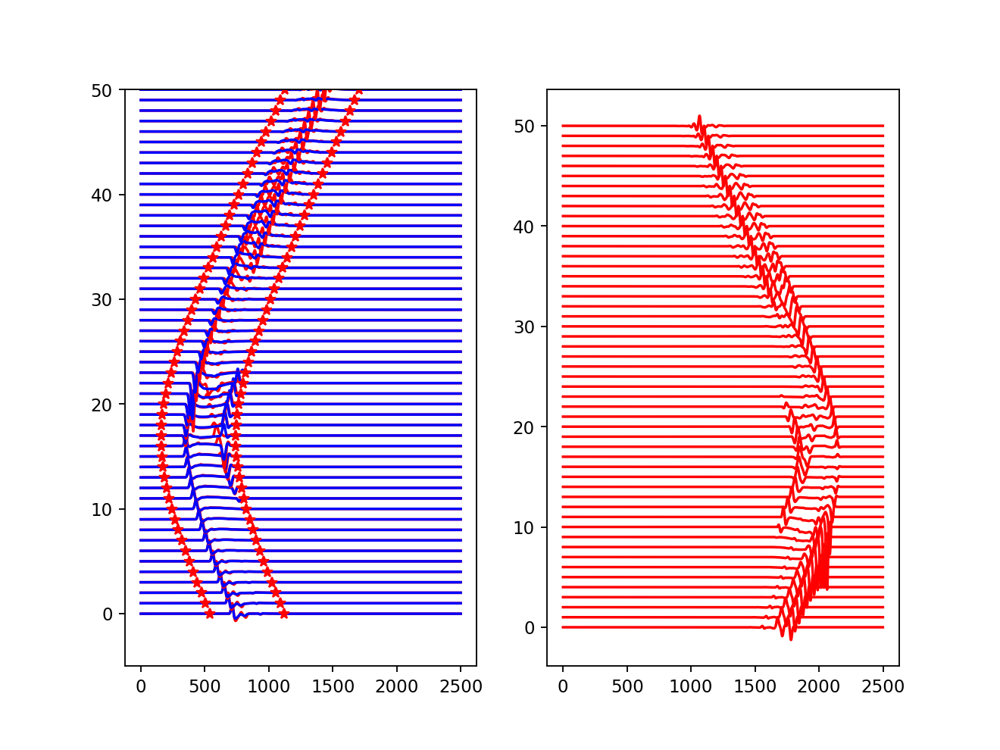

0.29845058329497504
0.2807389718426651
0.2665503451445374
0.2533124323953733
0.24103641821196484
0.23020310764706833
0.22087236582558026
0.21327440222262994
0.20741730181005164
0.20332962709800861
0.20088148589013696
0.19986457632896706
0.20019000485930707
0.20178507452818026
0.20445403723223982
0.20877088763923676
0.21591432518773485
0.22759310431283278
0.24617794691427233
0.27485324123612087
0.3182597161159698
0.384514040767341
0.4953376268044799
0.7012606630846584
0.9548705953256567
1.0487723902982968
1.0626057754352847
1.037048556133395
0.98744448968224
0.9382234116906989
0.8925054860062361
0.8413584866546812
0.7863425120246698
0.745782874561319
0.7343151400082429
0.7498903290697291
0.7796247883278273
0.8155103748541473
0.8539897116047886
0.893214424733019
0.9300874310231639
0.9608030657207515
0.9894546124612464
1.0078973786440457
1.025867029497404
1.0363657256822967
1.0297523580744274
1.0172944242903361
0.9931779603279033
1.004275962065346
1.0120428930298568
path build


<IPython.core.display.Javascript object>


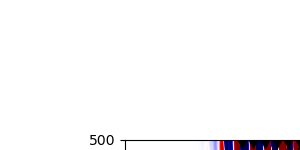

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1287
1288
1289
1290
-1.038993832270769e-10 1.3723031519645977e-10
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-8.061990103362461e-11 1.2637006251851821e-10
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-1.7848098868432457e-10 1.1715538590331983e-10
1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-7.280078545912023e-11 1.0945042131930273e-10
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-1.0306057719085165e-10 1.5217574423873527e-10
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-1.6220157181036225e-10 1.1964446825711773e-10
1341
1342
1343
1344
1345
1346
1347
1348
1349
1350
-1.197159927443783e-10 1.3902036583093725e-10
1351
1352
1353
1354
1355
1356
1357
1358
1359
1360
-1.183917616794573e-10 1.226459817227655e-10
1361
1362
1363
1364
1365
1366
1367
1368
1369
1370
-1.015085921481382e-10 1.1099628060880961e-10
1371
1372
1373
1374
1375
1376
1377
1378
1379
1380
-1.793196275655413e-10 1.0419579456844358e-10
1381
1382
1383
1384
1385
1386
1387
1388
1389
1390
-9.795049895214175

2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-1.2157676437705916e-09 1.3432409858097213e-09
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-1.267096308889868e-09 1.4181650450819902e-09
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-1.4725996736075365e-09 2.05016756259875e-09
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-1.3719305312711985e-09 1.0692374066044076e-09
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-1.4326096813854577e-09 1.2142983916277857e-09
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-1.0178453276681384e-09 1.2941967633303627e-09
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
-1.0163776134226946e-09 7.711683468547077e-10
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
-1.1372472583532083e-09 7.768703931914435e-10
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
-8.8269554906995e-10 7.751907383402685e-10
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
-8.217948621910131e-10 7.741032588171933e-10
2241
2242
2243
2244
2245
2246
2247
2248
2

<IPython.core.display.Javascript object>


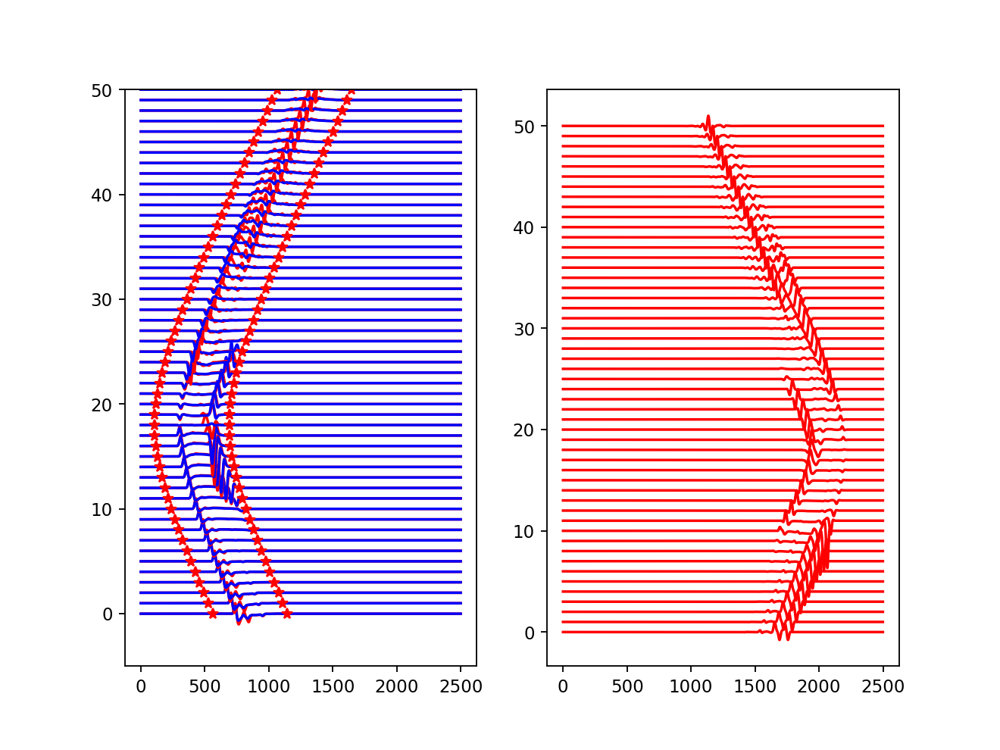

0.34805309512505095
0.3300994216559788
0.3135185961047778
0.29678655462468057
0.2801391421460731
0.26429448149051393
0.24951354708535467
0.23624182299697202
0.22475612294139827
0.21522357310743045
0.2080593300375335
0.2038579147627973
0.20063597504274697
0.20008678387957218
0.20354221014632506
0.20645545749891994
0.2078880661396516
0.21167863509136056
0.22207839414522645
0.24219926445774048
0.27926526867162443
0.3441223865770598
0.4466256618326626
0.6124767723592396
0.8418426377426642
0.9642653935350863
1.0019753289461792
0.9887227060218626
0.9402581829435236
0.885934980182562
0.8480081989864814
0.8172796825222952
0.7868754905222481
0.7538471145315128
0.7307908238972929
0.7294556938921285
0.7500272464293004
0.7830149123927221
0.8212808836047399
0.8628413944857721
0.9070449028518134
0.948648150676732
0.985720903332789
1.0128672467766022
1.0424933098465652
1.0598595986504367
1.062579752133123
1.0500239063443633
1.0280870691450326
1.038760084404706
1.0482567485980918
path build


<IPython.core.display.Javascript object>


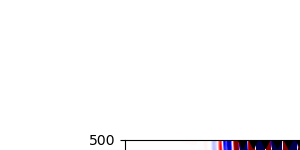

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-1.2633657081361314e-10 1.8467847335951184e-10
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-1.199112898158339e-10 2.3542354952070777e-10
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-2.159043557284858e-10 1.5479644439911988e-10
1341
1342
1343
1344
1345
1346
1347
1348
1349
1350
-1.6403573568904836e-10 1.700840833232369e-10
1351
1352
1353
1354
1355
1356
1357
1358
1359
1360
-1.456604356025892e-10 2.163679283533067e-10
1361
1362
1363
1364
1365
1366
1367
1368
1369
1370
-1.2299768772352023e-10 1.340278449633051e-10
1371
1372
1373
1374
1375
1376
1377
1378
1379
1380
-1.963767402474591e-10 1.1552978621304643e-10
1381
1382
1383
1384
1385
1386
1387
1388
1389
1390
-1.3871477281047414e-10 1.203776321951173e-10
1391
1392
1393
1394
1395
1396
1397
1398
1399
1400
-1.3297470200199508e-10 1.878204552304789e-10
1401
1402
1403
1404
1405
1406
1407
1408
1409
1410
-2.2774356757311708e-10 1.6471432035724248e-10
1411
1412
1413
1414
1415
1416
1417
1418

2170
-1.6272752383664156e-09 2.1351740257250025e-09
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-1.788804177461207e-09 1.936653577268364e-09
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-1.7345025743138501e-09 2.2227523790024085e-09
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-1.4092297854739671e-09 1.8320669430994998e-09
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
-1.1673125978453564e-09 1.8155727319349747e-09
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
-1.6666455870165196e-09 2.4054058849315674e-09
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
-1.6352881382953524e-09 1.3627989658705748e-09
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
-1.4823281800856702e-09 1.4650151004498558e-09
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
-1.1353126289415455e-09 1.2901732256964289e-09
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
-1.2086103343658095e-09 9.356957742385191e-10
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
-1.030573510051157e-09 8.771

<IPython.core.display.Javascript object>


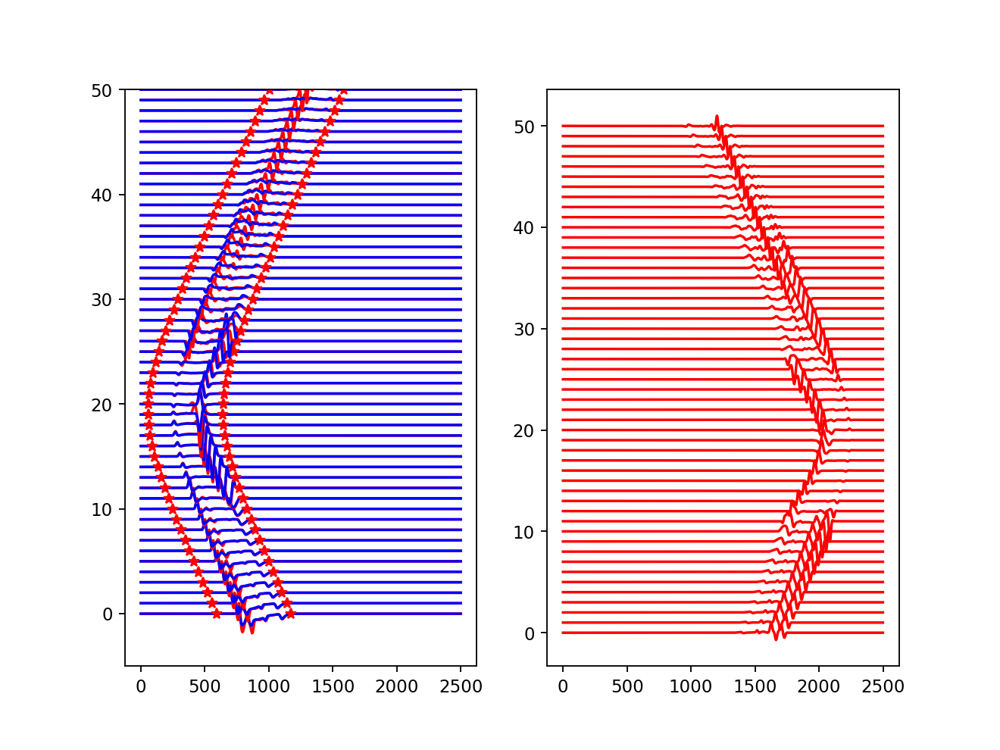

0.39560928394100864
0.3821081633309961
0.366988832927751
0.3498888090387615
0.33156597126177995
0.3125051092997499
0.29325848673070604
0.27405842796619595
0.2554763928291968
0.23860047398432913
0.22365109984608264
0.2106783198799197
0.21237350453963957
0.23438927991090883
0.22158067023440034
0.20802438686524888
0.22109688369071154
0.22302965522336415
0.2138331492992774
0.21579313450988263
0.23583399889521478
0.2920891578203529
0.42347229975564016
0.6402968206476403
0.8855567151619981
1.090682648409958
1.104704607061071
0.9532718423641295
0.839206415938585
0.787827763894979
0.7627441274956841
0.752169351780241
0.7486397558223893
0.743037553973971
0.7384002831882576
0.7370945474272722
0.7428896076492315
0.7575181312086497
0.7789074076092112
0.8079258208820702
0.8472113209264583
0.8937908590257242
0.9383833264535373
0.9752880224939114
1.0165633945969788
1.0361553678032085
1.0343214034199901
1.0218397021675394
1.0008051783976766
1.0066824583365093
1.0164118017552242
path build


<IPython.core.display.Javascript object>


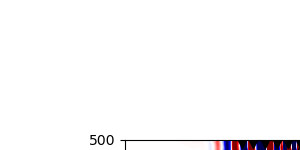

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-2.0145102147743976e-10 1.4857110701369538e-10
1341
1342
1343
1344
1345
1346
1347
1348
1349
1350
-1.7919787194995283e-10 2.179849720671892e-10
1351
1352
1353
1354
1355
1356
1357
1358
1359
1360
-1.618841159534885e-10 2.1300922352218614e-10
1361
1362
1363
1364
1365
1366
1367
1368
1369
1370
-1.485402625138462e-10 1.8227179472318506e-10
1371
1372
1373
1374
1375
1376
1377
1378
1379
1380
-2.1936919870331262e-10 1.5592872524622094e-10
1381
1382
1383
1384
1385
1386
1387
1388
1389
1390
-1.7319255559154186e-10 1.697609707742295e-10
1391
1392
1393
1394
1395
1396
1397
1398
1399
1400
-1.6848321392388688e-10 2.1878915216163588e-10
1401
1402
1403
1404
1405
1406
1407
1408
1409
1410
-2.5835460798812103e-10 1.708847071298635e-10
1411
1412
1413
1414
1415
1416
1417
1418
1419
1420
-1.5203444043066494e-10 1.748300334172707e-10
1421
1422
1423
1424
1425
1426
1427
1428
1429
1430
-1.3678931634294636e-10 2.397011756939515e-10
1431
1432
1433
1434
1435
1436
1437
14

2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-3.4168819909900867e-09 4.149995340181824e-09
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
-3.373618552655709e-09 4.137109558887982e-09
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
-3.3741086908722493e-09 4.089896253382552e-09
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
-3.3621148801438764e-09 4.065683773868889e-09
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
-3.3742342936773358e-09 4.09537751870012e-09
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
-3.368863866871065e-09 4.1138974056341886e-09
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
-3.355395687592195e-09 4.105535409398002e-09
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
-3.3489170666363023e-09 4.1292647300705424e-09
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
-3.3306542891998874e-09 4.179142775544733e-09
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
-3.306931539105129e-09 4.158859988654139e-09
2291
2292
2293
2294
2295
2296
2297
2298
229

<IPython.core.display.Javascript object>


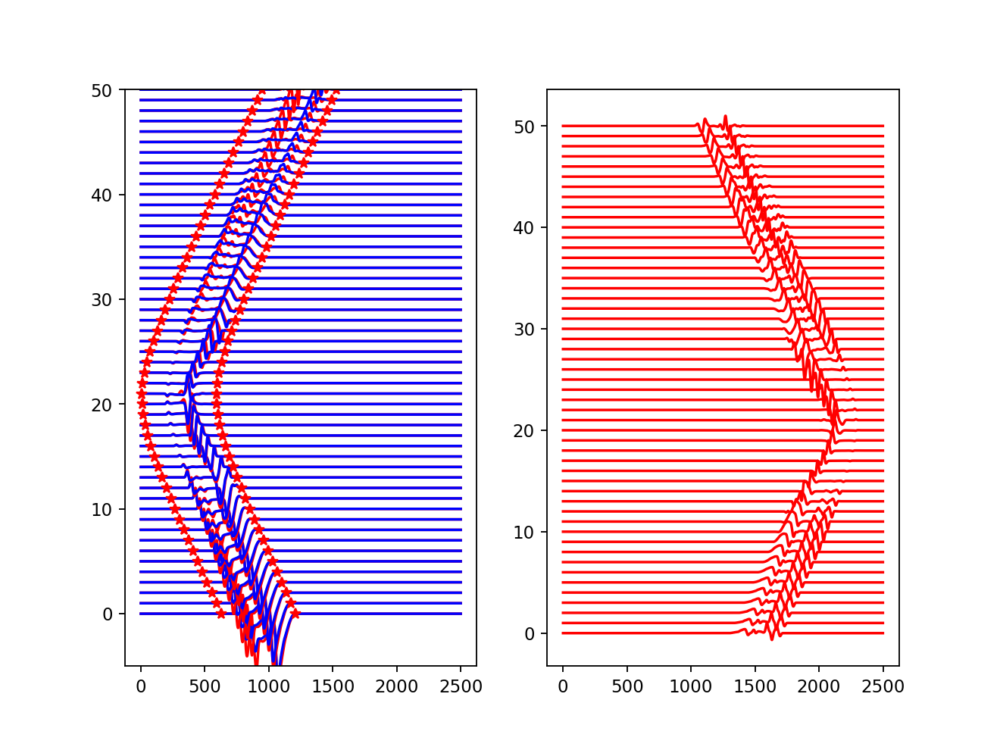

0.33591772452257435
0.3343938413071041
0.3273968344578488
0.32007715681592736
0.3098061965733679
0.2981336411127959
0.28525711463645764
0.2699525135742492
0.2549638014433321
0.23876060984101863
0.22260969138941597
0.20826234936113605
0.19537619473235188
0.19709793553724778
0.2271342546883201
0.26244670961959365
0.26668043342500036
0.22685919217659511
0.24097571361961795
0.24309658157416403
0.21509314772716176
0.22574470269268218
0.3115826259570135
0.5759763397125514
0.8714322613777032
1.1334451734644881
1.3780623458487429
1.4526635685840048
1.173535129517495
0.7309873892124851
0.6319230060555587
0.6364333212558745
0.653713332367413
0.6749914290977844
0.6995511524210746
0.7364669276088596
0.7817192590849384
0.807886130693646
0.8137140333613818
0.8267022594147658
0.8556389849777262
0.8945095999746173
0.9387107528071337
0.9848013185315057
1.0232062810211053
1.051866711076651
1.0725458886965034
1.0816803591037953
1.0777254340957927
1.1110598435156056
1.1491871316455096
path build


<IPython.core.display.Javascript object>


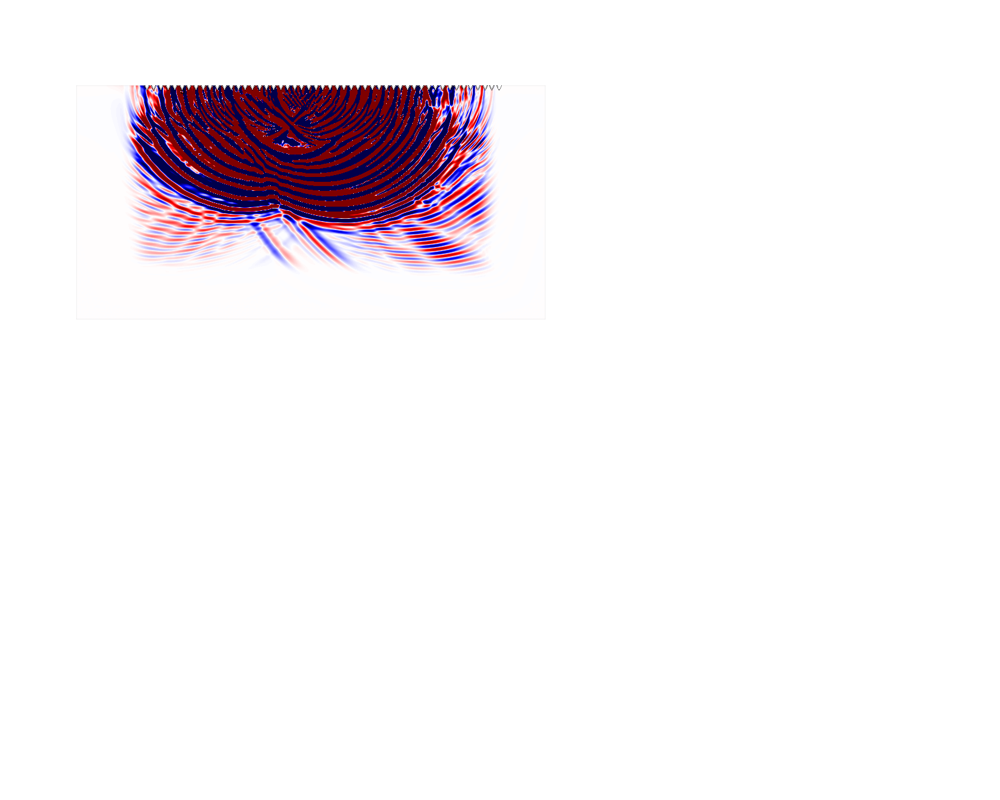

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

-8.110246191029992e-11 8.314922791972308e-11
1361
1362
1363
1364
1365
1366
1367
1368
1369
1370
-8.900113513084621e-11 7.79439961075595e-11
1371
1372
1373
1374
1375
1376
1377
1378
1379
1380
-1.5105259388545999e-10 9.381669731282883e-11
1381
1382
1383
1384
1385
1386
1387
1388
1389
1390
-1.114512027002914e-10 1.4769963412790391e-10
1391
1392
1393
1394
1395
1396
1397
1398
1399
1400
-1.0897586799996028e-10 1.509570345842922e-10
1401
1402
1403
1404
1405
1406
1407
1408
1409
1410
-2.0497363260598152e-10 1.2844386959425684e-10
1411
1412
1413
1414
1415
1416
1417
1418
1419
1420
-1.0703132396284242e-10 1.620162697110248e-10
1421
1422
1423
1424
1425
1426
1427
1428
1429
1430
-1.020315661493436e-10 1.9376942564043716e-10
1431
1432
1433
1434
1435
1436
1437
1438
1439
1440
-1.9639553479214045e-10 1.398568501238779e-10
1441
1442
1443
1444
1445
1446
1447
1448
1449
1450
-9.329628886677676e-11 1.4932110679672978e-10
1451
1452
1453
1454
1455
1456
1457
1458
1459
1460
-1.0063500035048294e-10 1.8952191007416037

2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
-1.2009286290044721e-08 1.184162865782244e-08
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
-1.1741469762466163e-08 1.1976888790567676e-08
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
-1.2288155993863361e-08 1.1758703453408851e-08
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
-1.2554097534725615e-08 1.1957080078380147e-08
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
-1.219119115722645e-08 1.2359987707263027e-08
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
-1.1813602421985112e-08 1.247432364498539e-08
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
-1.184627854046585e-08 1.2426593906600387e-08
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
-1.186764746115905e-08 1.2414725586668882e-08
2291
2292
2293
2294
2295
2296
2297
2298
2299
2300
-1.1849617512064797e-08 1.2425771768205366e-08
2301
2302
2303
2304
2305
2306
2307
2308
2309
2310
-1.1868775227128888e-08 1.2487023359042935e-08
2311
2312
2313
2314
2315
2316
2317


<IPython.core.display.Javascript object>


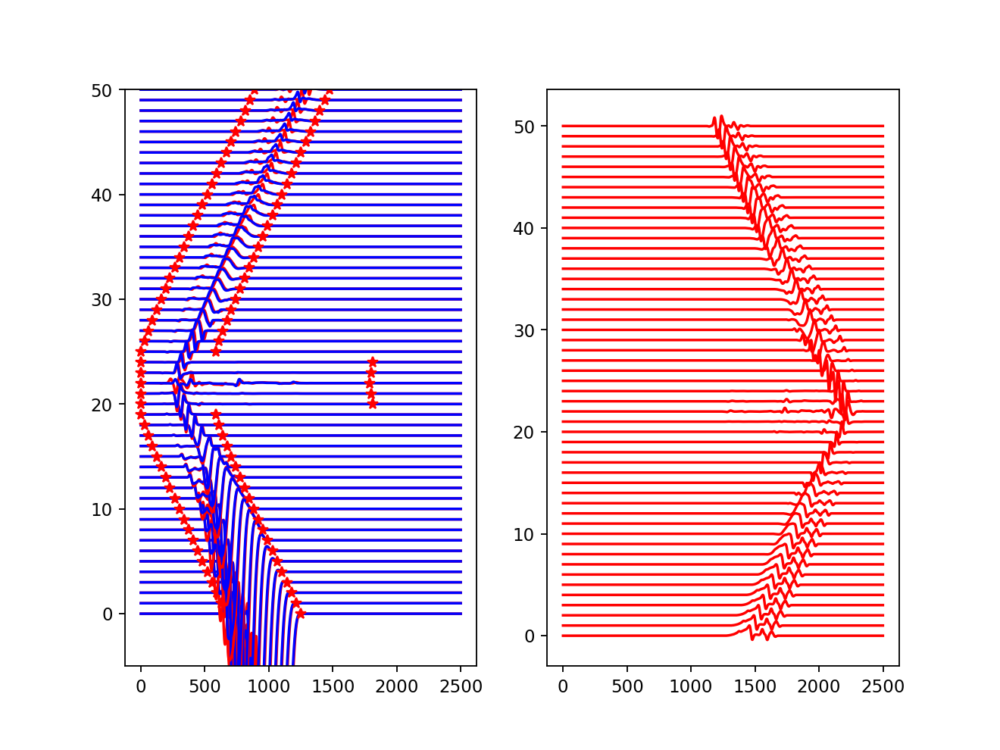

0.21940374331107595
0.22106348283111757
0.2205813630761823
0.21972854768327066
0.21832220323190563
0.2164337662877856
0.2138411419389161
0.21115190609733156
0.2075492397439797
0.20432278590067618
0.20042598728135994
0.19658118495943452
0.19298826167823127
0.19058492963142598
0.19876865229590057
0.21529552345069783
0.23284185596855844
0.26097962358890603
0.28478348090482586
0.25156224595745647
0.2739042672642274
0.2883275215798217
0.2606111393563012
0.38142036341463426
0.664618627403242
0.861386547001461
1.0534830477633768
1.1109652546591504
1.0901826117760791
0.9649998051861831
0.6857907577078418
0.5324605251375327
0.5421027283789562
0.5776150159945156
0.6116561868300743
0.6405976986778271
0.6697613395051127
0.7127483818562567
0.7695356206657205
0.8367342925249753
0.9103075548176304
0.9831717511404338
1.0527904476156265
1.0992524187536141
1.1157171217899107
1.1320664162076133
1.1599598015371178
1.172098029710244
1.180779051437093
1.2275347860609662
1.2703066053556817
path build


<IPython.core.display.Javascript object>


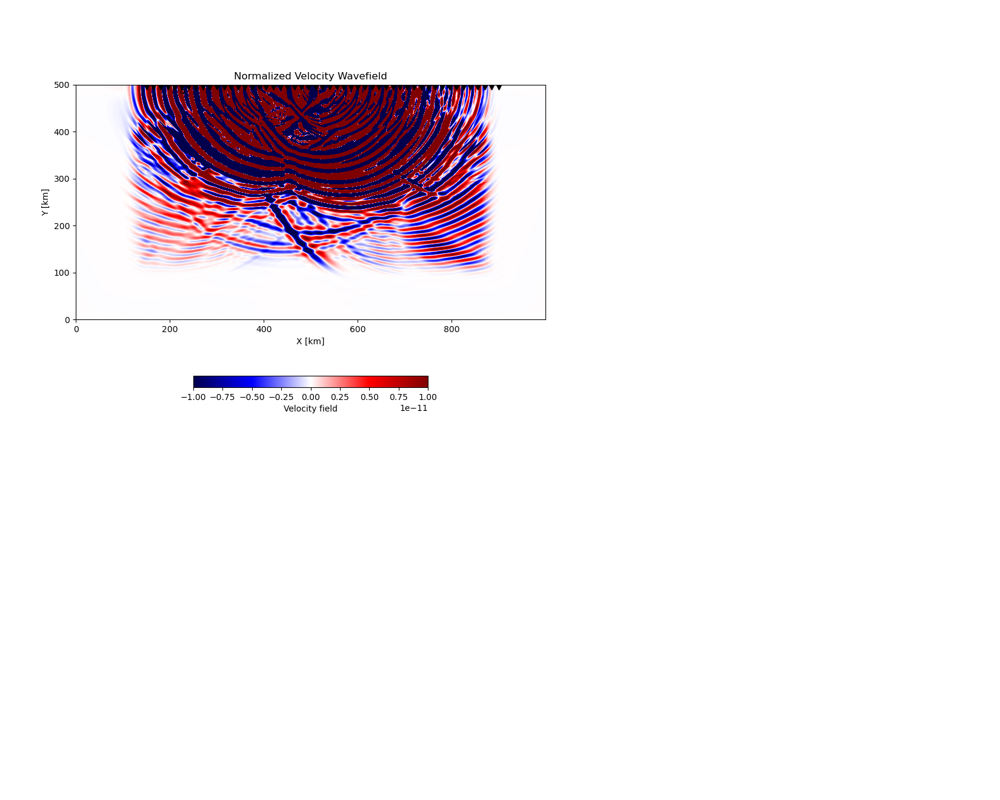

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-5.3427550394945336e-11 4.5732072099009823e-11
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-1.1158855010398441e-10 7.683798503074677e-11
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.6823593895329704e-10 1.2373935735784876e-10
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-1.777921109454861e-10 2.5535475665856226e-10
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-1.6830713233382715e-10 1.8599924900878053e-10
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-1.464232335819747e-10 1.5010598137115833e-10
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-3.4344854917051816e-10 4.219680525354583e-10
1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-1.977742798194059e-10 3.6478661616063124e-10
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-1.66056946934282e-10 1.7253863309739745e-10
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-3.2171300160510246e-10 3.6869274457584114e-10
1341
1342
1343
1344
1345
1346
1347
13

2100
-5.3873319298343647e-08 4.108502724584027e-08
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-4.318607396410879e-08 3.6698987815543944e-08
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-4.07451930708582e-08 3.5218169829870256e-08
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-9.77713799342226e-08 1.1958319962833193e-07
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-4.429714271268796e-08 7.347585396871881e-08
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-6.972156863942079e-08 6.025940435266922e-08
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-5.5115530409490354e-08 5.621060815043246e-08
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-3.781720047339769e-08 5.136745021280959e-08
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-3.521063023721855e-08 4.465538955674253e-08
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-3.326676657104362e-08 3.416387209577432e-08
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-2.92926886869144e-08 2.9650102033693843e-

<IPython.core.display.Javascript object>


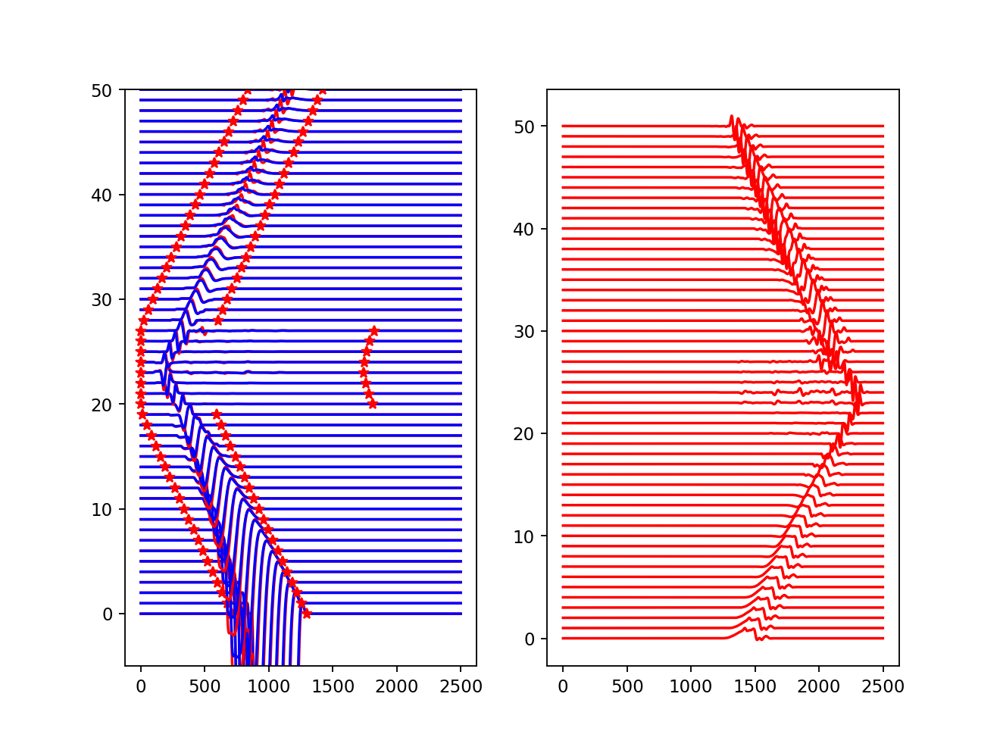

0.17892629510539776
0.17980554867090862
0.18047230636896164
0.18093713881675108
0.1815833705243033
0.1822520619378078
0.18291787903370182
0.1836118965227703
0.18423192173916858
0.18472178962687713
0.18503781545066764
0.1851885390790806
0.18526090114568358
0.18547735657540412
0.18696449913609695
0.19683030845929517
0.2238804180103251
0.2542941047347492
0.26095160823449504
0.2608281454651885
0.3055578900989088
0.3042497585875395
0.27588012521552646
0.2545469656232843
0.32162344154112943
0.44000925343426894
0.5746484945511221
0.645383434219041
0.6935155911843155
0.7521780569343357
0.6902586604315801
0.5165397870548755
0.385707104103047
0.36884226064218717
0.391628212786779
0.43656455009256584
0.49561362487093924
0.5590091793921436
0.6283721435419385
0.7096875053348949
0.7975237217411852
0.8778579582199726
0.9426706265154842
0.9910921874225702
1.0383530178447669
1.0708017790606015
1.1132387768365093
1.1333358957517972
1.1458049394733214
1.1892968233300574
1.229902203850442
path build


<IPython.core.display.Javascript object>


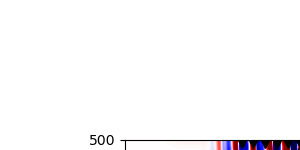

0
0.0 0.0
1
2
3
4
5
6
7
8
9
10
0.0 0.0
11
12
13
14
15
16
17
18
19
20
0.0 0.0
21
22
23
24
25
26
27
28
29
30
0.0 0.0
31
32
33
34
35
36
37
38
39
40
0.0 0.0
41
42
43
44
45
46
47
48
49
50
0.0 0.0
51
52
53
54
55
56
57
58
59
60
0.0 0.0
61
62
63
64
65
66
67
68
69
70
0.0 0.0
71
72
73
74
75
76
77
78
79
80
0.0 0.0
81
82
83
84
85
86
87
88
89
90
0.0 0.0
91
92
93
94
95
96
97
98
99
100
0.0 0.0
101
102
103
104
105
106
107
108
109
110
0.0 0.0
111
112
113
114
115
116
117
118
119
120
0.0 0.0
121
122
123
124
125
126
127
128
129
130
0.0 0.0
131
132
133
134
135
136
137
138
139
140
0.0 0.0
141
142
143
144
145
146
147
148
149
150
0.0 0.0
151
152
153
154
155
156
157
158
159
160
0.0 0.0
161
162
163
164
165
166
167
168
169
170
0.0 0.0
171
172
173
174
175
176
177
178
179
180
0.0 0.0
181
182
183
184
185
186
187
188
189
190
0.0 0.0
191
192
193
194
195
196
197
198
199
200
0.0 0.0
201
202
203
204
205
206
207
208
209
210
0.0 0.0
211
212
213
214
215
216
217
218
219
220
0.0 0.0
221
222
223
224
225
226
227
228
229
230
0.

-1.0670396167271725e-11 1.1964473300888546e-11
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
-2.1132310544455147e-11 2.425798348554741e-11
1251
1252
1253
1254
1255
1256
1257
1258
1259
1260
-2.8090201203606265e-11 3.5072314404975116e-11
1261
1262
1263
1264
1265
1266
1267
1268
1269
1270
-1.4062938119829762e-11 2.5195363300717624e-11
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
-1.455727033873473e-11 1.6293961975968757e-11
1281
1282
1283
1284
1285
1286
1287
1288
1289
1290
-2.793837066085011e-11 3.173416262448698e-11
1291
1292
1293
1294
1295
1296
1297
1298
1299
1300
-4.4948598405435335e-11 5.6585542203740686e-11
1301
1302
1303
1304
1305
1306
1307
1308
1309
1310
-3.605610828977603e-11 5.517887112201527e-11
1311
1312
1313
1314
1315
1316
1317
1318
1319
1320
-3.395902375486246e-11 4.627771690055196e-11
1321
1322
1323
1324
1325
1326
1327
1328
1329
1330
-4.447617981266261e-11 5.050164538329034e-11
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
-5.769362970066029e-11 7.262166570711424

2100
-1.2984202185936764e-08 1.2679612654727177e-08
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
-9.902935089787503e-09 1.5324342090680514e-08
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
-9.101049739790719e-09 1.2754756016107207e-08
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
-1.0247990832139139e-08 1.1204131769754893e-08
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
-9.391470131007982e-09 9.159953629737433e-09
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
-1.406112236132999e-08 1.0844617826396266e-08
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
-9.294062364404973e-09 7.123217358766414e-09
2161
2162
2163
2164
2165
2166
2167
2168
2169
2170
-9.190436792026864e-09 1.0519022105176889e-08
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
-8.306466889036816e-09 7.544978222040848e-09
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
-8.467207851328242e-09 7.171755077310443e-09
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
-7.885843341941083e-09 7.027024068498

In [44]:
pathobs=pathrun+'wavefields_crustslab/'
pathsyn=pathrun+'wavefields_slab_2025/'
from source import source
#for i in np.arange(0,1):
for i in np.arange(int(len(isx_array))):
    event='event_'+str(i)
    print(event)
    _,index=event.split('_')
    
    source_i=source([isx_array[int(index)],isz_array[int(index)]],'singleforce',1e18,f0,nt,dt,0,0,0,0,0.5,0.5,0)
    adsource=adsource
    adsource=generate_adj(pathobs,pathsyn,event,irx,irz,source_i,adsource)
    wavefield='wavefields_slab_2025/'+event+'/adj/'
    path2 = os.path.join(pathrun, wavefield)
    if os.path.exists(path2)==False:
        print('path build')
        os.mkdir(path2)
    else:
        print('path exists')
    vx, vz= assemble_psv_adj_multirec(dx,dz,rho0,vp,vs,dt,nt,nx,nz,adsource,damp,path2,path2,10,10,-1e-11,1e-11)

event_0


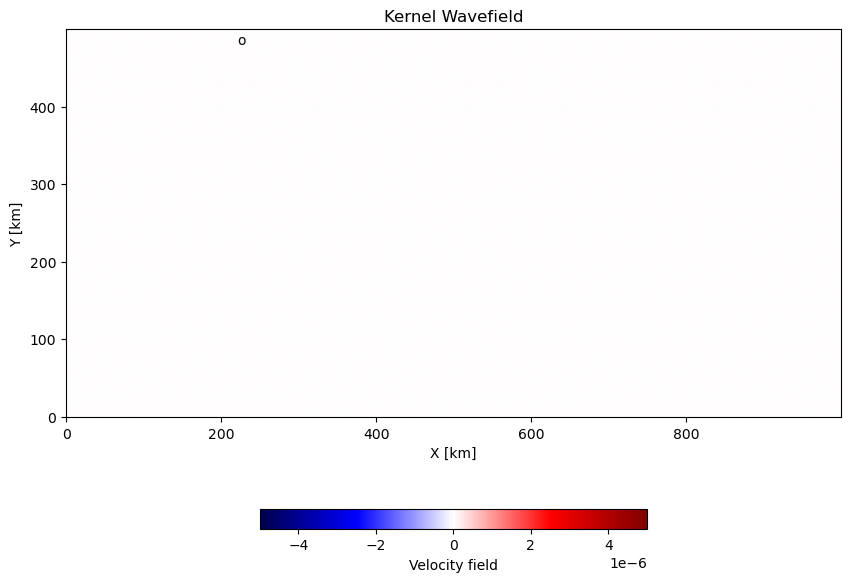

1.8567957082058206e-12
2.4090324758371064e-11
2.0100568416909155e-09
1.697432488043823e-08
2.664506657300577e-06
1.0345661245398694e-05
1.792070743827804e-05
2.5335901529940856e-05
3.2755193393741126e-05
100 is finished
4.017946862939039e-05
4.760466015196058e-05
5.5028686857893826e-05
6.245250287826554e-05
6.9876247803494e-05
7.730000691366002e-05
8.472378951565226e-05
9.214758634702478e-05
9.957138833136343e-05
0.00010699518872560684
200 is finished
0.00011441898766766822
0.00012184278493211135
0.00012926657153554703
0.00013669034339708206
0.0001441141135008485
0.0001515378832342998
0.00015896165091009684
0.0001663854271821601
0.00017380920151688513
0.00018123297023582983
300 is finished
0.00018865673983101808
0.0001960805098277896
0.00020350427324343834
0.00021092803377427982
0.00021835179649071711
0.00022577556007959492
0.0002331993230109565
0.00024062308549028207
0.000248046848145931
0.000255470610959667
400 is finished
0.00026289437374282175
0.00027031813655070853
0.0002777418993

In [ ]:
import os
kernel_matrixP=np.zeros((15,nx,nz))
kernel_matrixS=np.zeros((15,nx,nz))
for i in np.arange(0,15):
    event='event_'+str(i)
    print(event)
    _,index=event.split('_')
    wavefield='wavefields_slab_2025/'+event+'/'
    path1 = os.path.join(pathrun, wavefield)
    wavefield='wavefields_slab_2025/'+event+'/'+'adj/'
    path2 = os.path.join(pathrun, wavefield)
    kernel,kernel_mu,kernel_matrixP[i],kernel_matrixS[i]=assumble_kernel(path1,path2,2500,vp,vs,-5e-6,5e-6)

In [46]:
###sum the kernel
kernel_P_sum=kernel_matrixP.copy().sum(axis=0)

In [47]:
np.savetxt('Guided_wavekernel_P.txt',kernel_P_sum)

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
kernel_P_sum=np.loadtxt('Guided_wavekernel_P.txt')

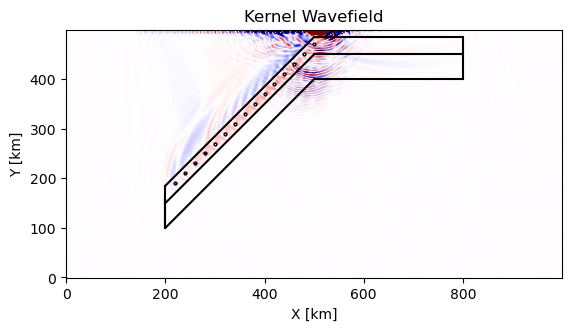

In [19]:
plt.figure()
plt.imshow(kernel_P_sum.T,cmap=cm.seismic, interpolation='bicubic', vmin=-4e-4, vmax=4e-4)
plt.title('Kernel Wavefield')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.gca().invert_yaxis()
#plt.text(isx, isz, 'o')
isx_array=np.arange(220,520,20)
isz_array=isx_array-30
x_slab=np.array([200,500])
y_slab=x_slab-200+100
y_slab2=x_slab-200
y_slab3=x_slab-15
y_slab4=x_slab-50
plt.plot(x_slab,y_slab,'k')
plt.plot([200,200],[100,160],'k')
        #plt.plot([500,500],[400,460],'k')
        #plt.plot([500,800],[450,450],'k')
plt.plot([500,800],[450+35,450+35],'k')
plt.plot([500,800],[400,400],'k')
plt.plot([500,800],[450,450],'k')
plt.plot([800,800],[400,450+35],'k')
plt.plot([200,200],[100,150+35],'k')
        #plt.plot([500,500],[400,460],'k')
plt.plot(x_slab,y_slab3,'k')
plt.plot(x_slab,y_slab4,'k')
plt.plot(isx_array,isz_array,'ko',fillstyle='none',markersize=2)

<IPython.core.display.Javascript object>


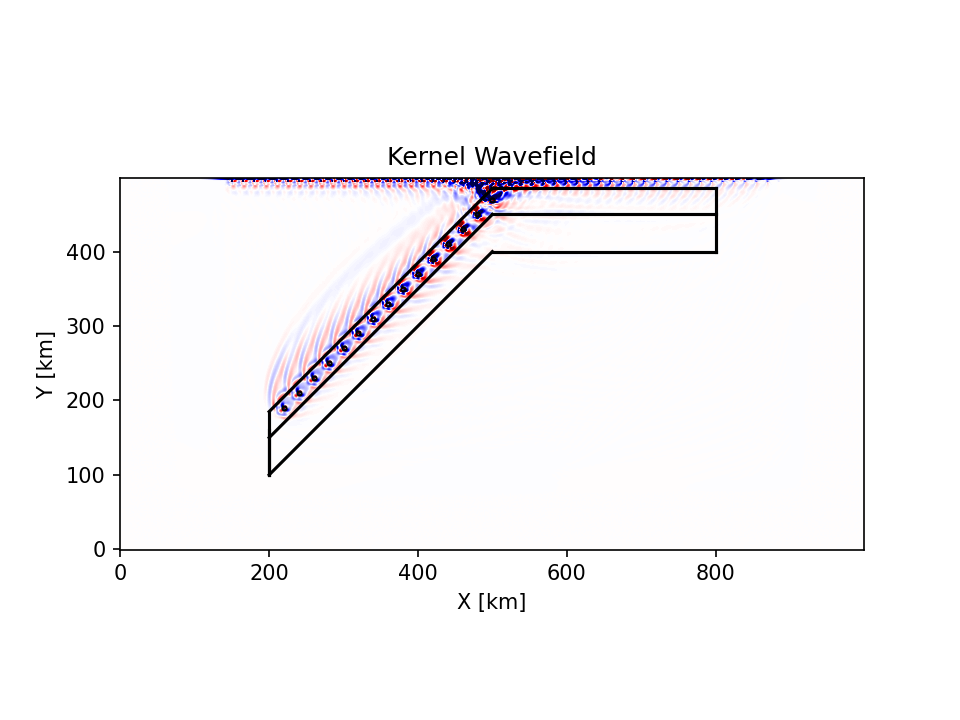

In [194]:
kernel_S_sum=kernel_matrixS.copy().sum(axis=0)
plt.figure()
plt.imshow(kernel_S_sum.T,cmap=cm.seismic, interpolation='bicubic', vmin=-2e-11, vmax=2e-11)
plt.title('Kernel Wavefield')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.gca().invert_yaxis()
#plt.text(isx, isz, 'o')
isx_array=np.arange(220,520,20)
isz_array=isx_array-30
x_slab=np.array([200,500])
y_slab=x_slab-200+100
y_slab2=x_slab-200
y_slab3=x_slab-15
y_slab4=x_slab-50
plt.plot(x_slab,y_slab,'k')
plt.plot([200,200],[100,160],'k')
        #plt.plot([500,500],[400,460],'k')
        #plt.plot([500,800],[450,450],'k')
plt.plot([500,800],[450+35,450+35],'k')
plt.plot([500,800],[400,400],'k')
plt.plot([500,800],[450,450],'k')
plt.plot([800,800],[400,450+35],'k')
plt.plot([200,200],[100,150+35],'k')
        #plt.plot([500,500],[400,460],'k')
plt.plot(x_slab,y_slab3,'k')
plt.plot(x_slab,y_slab4,'k')
plt.plot(isx_array,isz_array,'ko',fillstyle='none',markersize=2)